# Guilak

## 0. Setting up workenvironment<a id="0"></a>

In [155]:
suppressPackageStartupMessages({
    library(DropletUtils)
    library(SingleCellExperiment)
    library(scuttle)
    library(Seurat)
    library(SeuratWrappers)
    library(stringr)
    library(dplyr)
    library(data.table)
    library(Matrix)
    library(patchwork)
    library(ggplot2)
})

options(repr.plot.width = 16, repr.plot.height = 8)

## Loading data

### 3.1. Data analysis Seurat<a id="9"></a>

In [156]:
A <- readRDS(file = "Guilak_E13_5.Rds")

In [157]:
A@meta.data$Author = 'Guilak'

### E13.5

In [158]:
#A@meta.data$CellType <- NULL

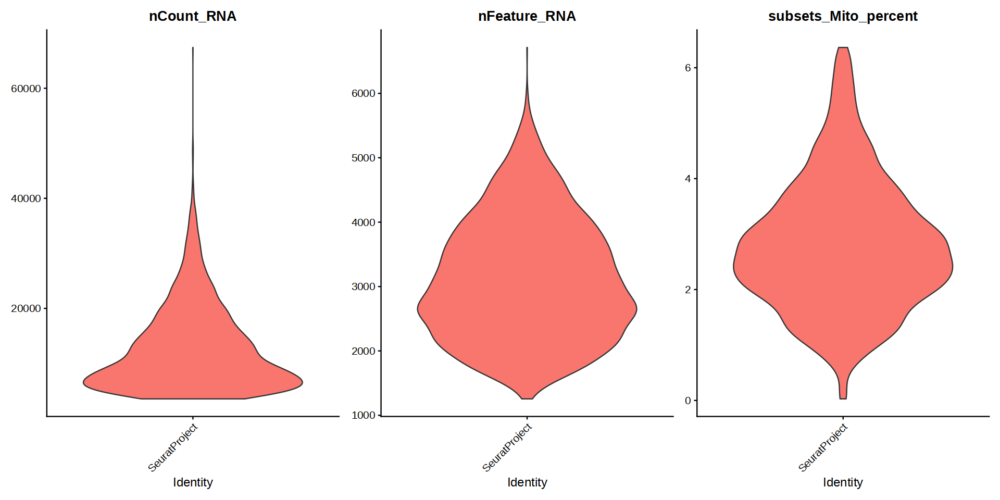

In [159]:
VlnPlot(A, features = c("nCount_RNA", "nFeature_RNA", "subsets_Mito_percent"), 
        ncol = 3, group.by = "orig.ident", pt.size = 0)

In [160]:
A <- NormalizeData(A, verbose = FALSE)
A <- FindVariableFeatures(A, selection.method = "vst", nfeatures = 2000)

# Identify the 10 most highly variable genes
top10 <- head(VariableFeatures(A), 10)

In [161]:
all.genes <- rownames(A)
A <- ScaleData(A, features = all.genes)

Centering and scaling data matrix



In [162]:
A <- RunPCA(A, features = VariableFeatures(object = A), verbose = FALSE)

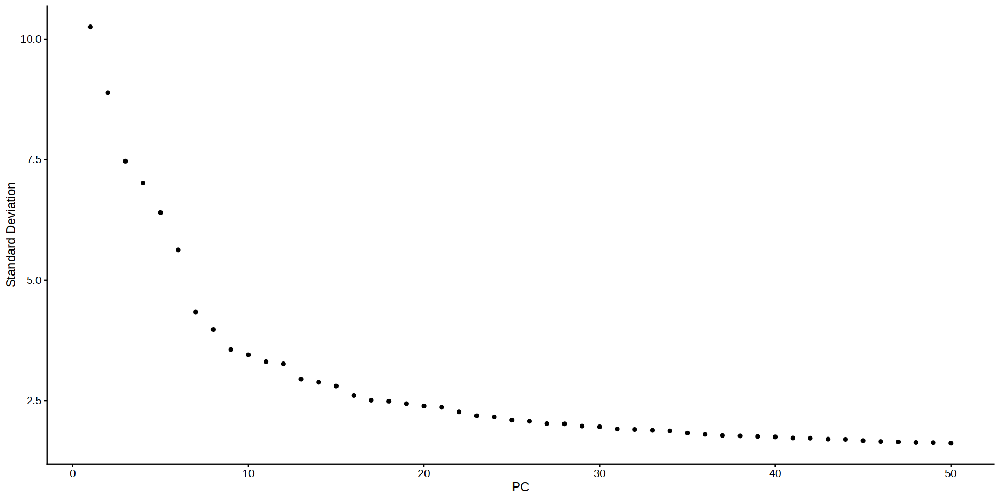

In [163]:
ElbowPlot(A, 50)

In [164]:
A <- FindNeighbors(A, dims = 1:22)
A<- FindClusters(A, resolution = 0.6)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 2726
Number of edges: 83672

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8747
Number of communities: 12
Elapsed time: 0 seconds


In [165]:
A <- RunUMAP(A, dims = 1:22, n.neighbors = 12, verbose = FALSE)

### Check annotation

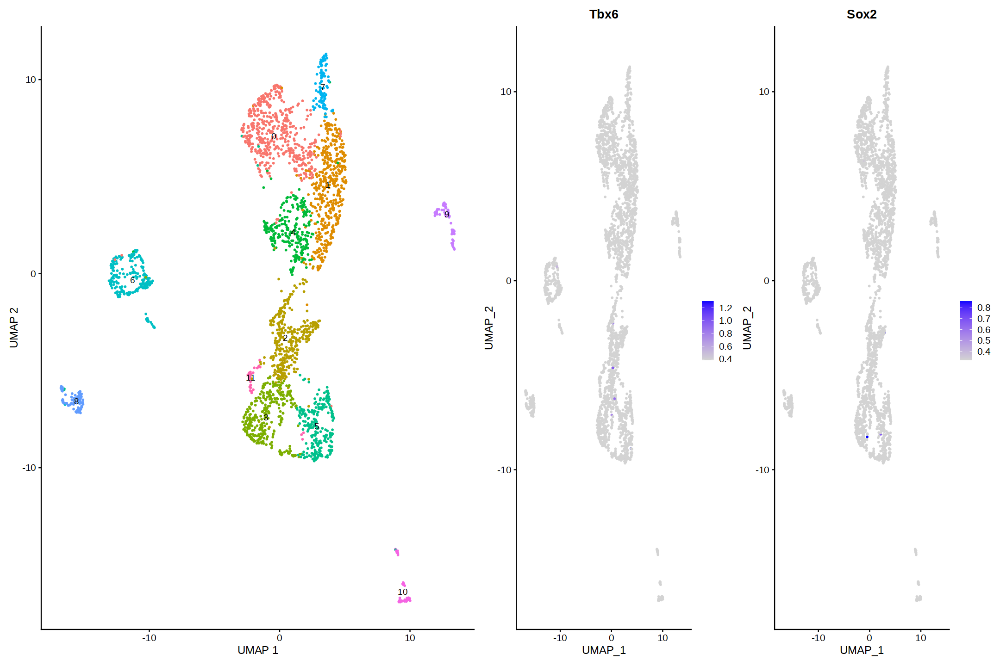

In [82]:
# Paraxial Mesoderm: Tbx6+, Sox2-
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Tbx6", "Sox2"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Pax2, Ren1”


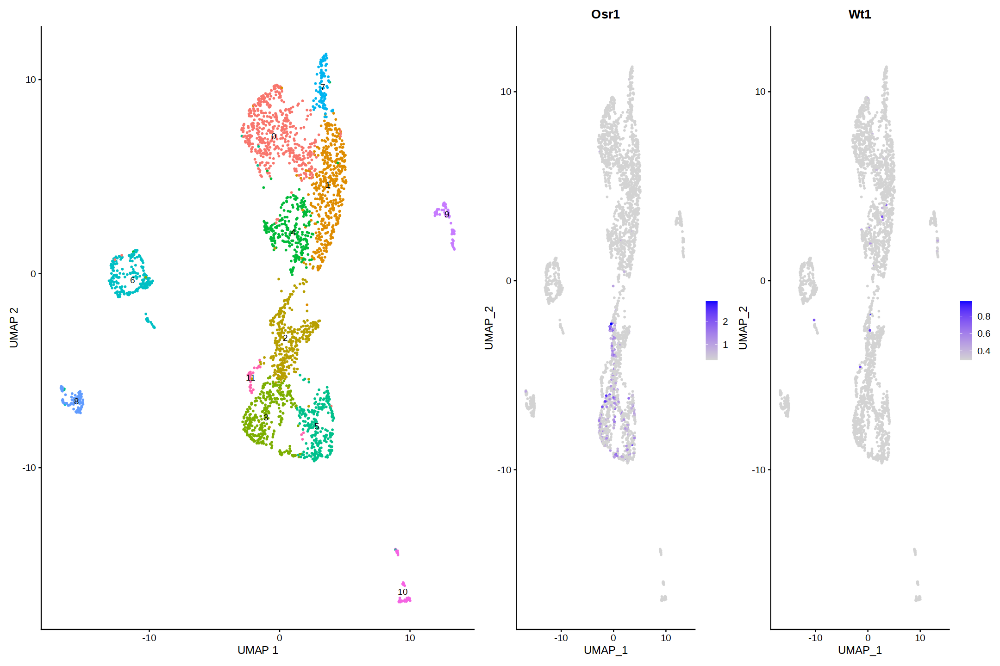

In [83]:
# Intermediate Mesoderm: Osr1, Wt1, Pax2
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Osr1", "Wt1", "Pax2","Ren1"), min.cutoff = "q1")  

p1 + p2

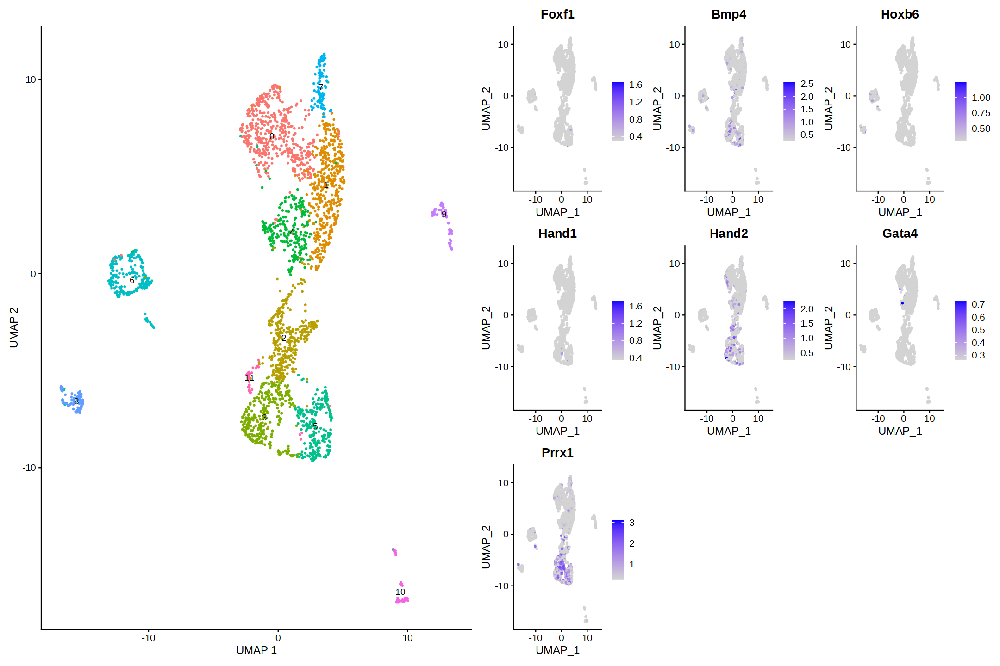

In [84]:
# Lateral plate mesoderm
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Foxf1", "Bmp4", "Hoxb6", "Hand1", "Hand2", "Gata4","Prrx1"), min.cutoff = "q1")  

p1 + p2

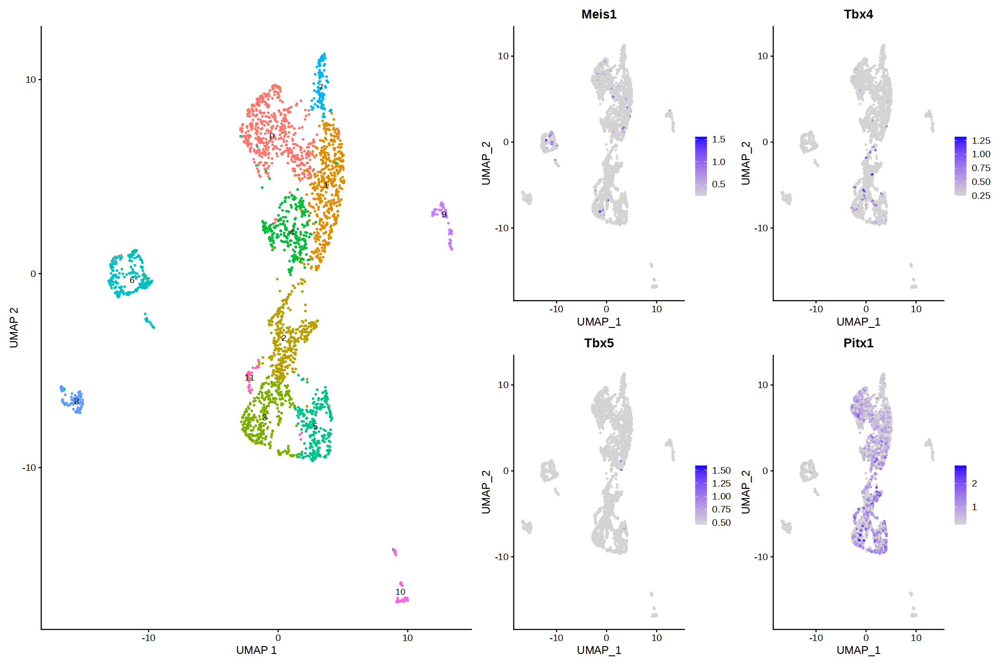

In [85]:
# Early limb bud mesenchyme
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Meis1", "Tbx4", "Tbx5",'Pitx1'), min.cutoff = "q1")  

p1 + p2

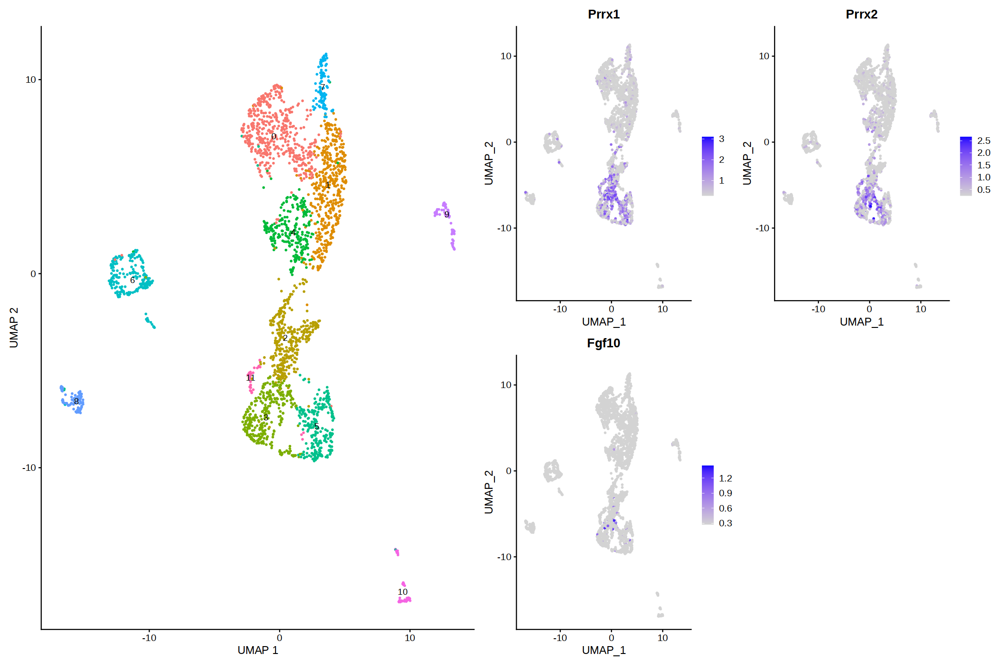

In [86]:
# limb bud mesenchyme
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Prrx1", "Prrx2", "Fgf10"), min.cutoff = "q1")  

p1 + p2

In [71]:
# ZPA
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Shh"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Shh”


ERROR: Error: None of the requested features were found: Shh in slot data


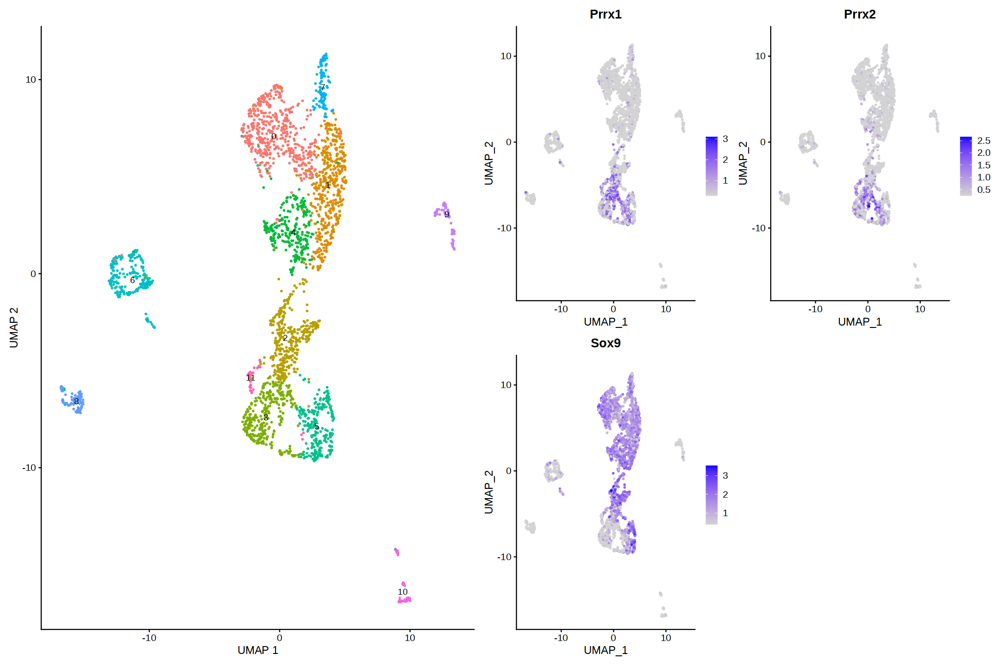

In [87]:
# Chondroprogenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Prrx1", "Prrx2", "Sox9"), min.cutoff = "q1")  

p1 + p2

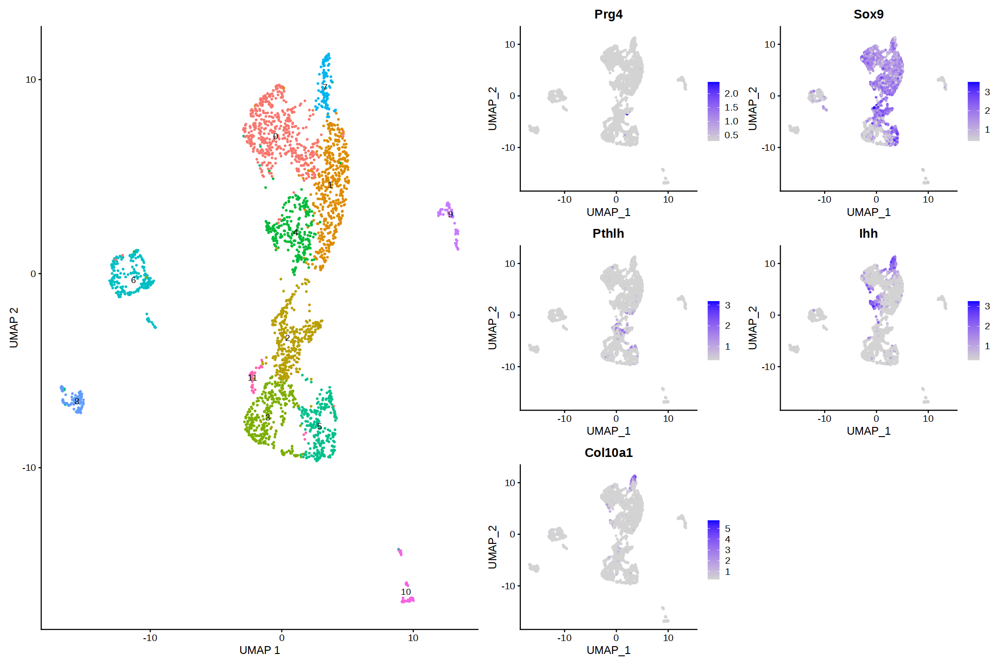

In [88]:
# Chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Prg4","Sox9","Pthlh","Ihh","Col10a1"), min.cutoff = "q1")  

p1 + p2

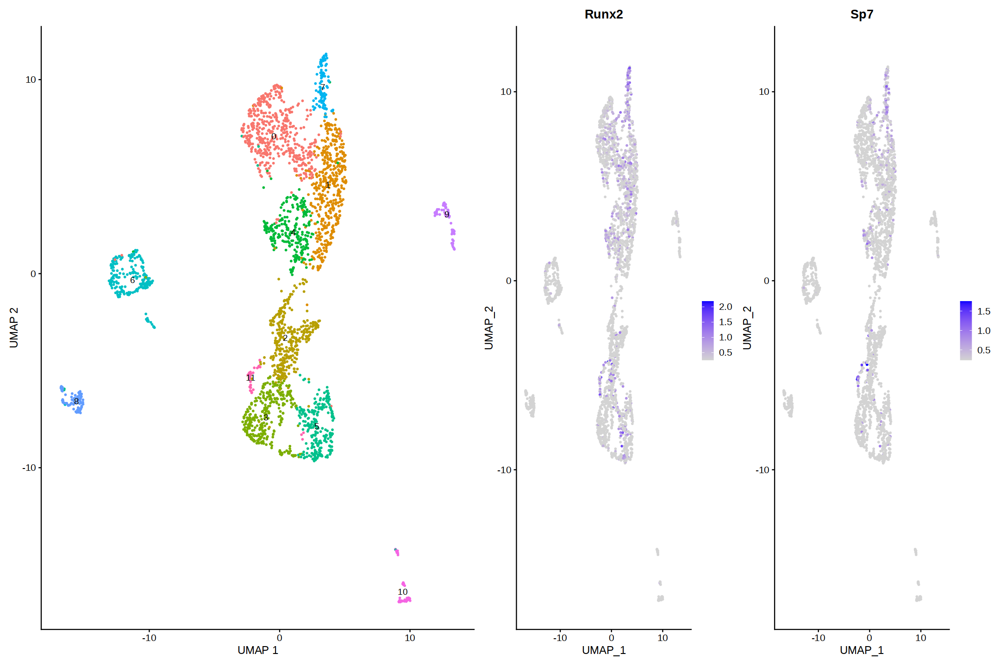

In [89]:
# Osteoprogenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Runx2", "Sp7"), min.cutoff = "q1")  

p1 + p2

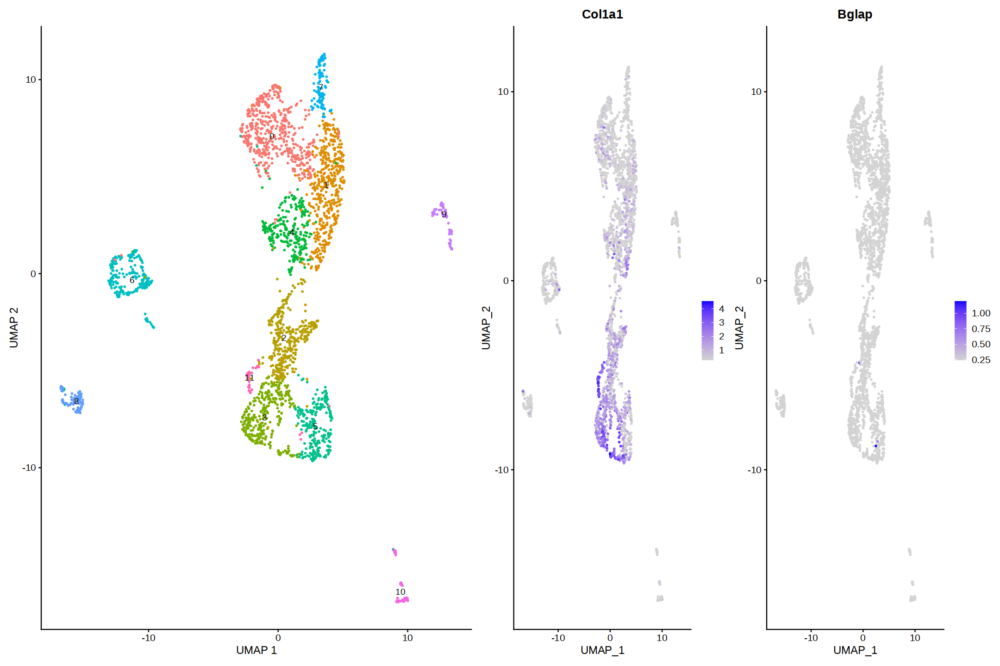

In [90]:
# Osteoblasts
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Col1a1", "Bglap"), min.cutoff = "q1")  

p1 + p2

In [91]:
# Osteocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Dmp1"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Dmp1”


ERROR: Error: None of the requested features were found: Dmp1 in slot data


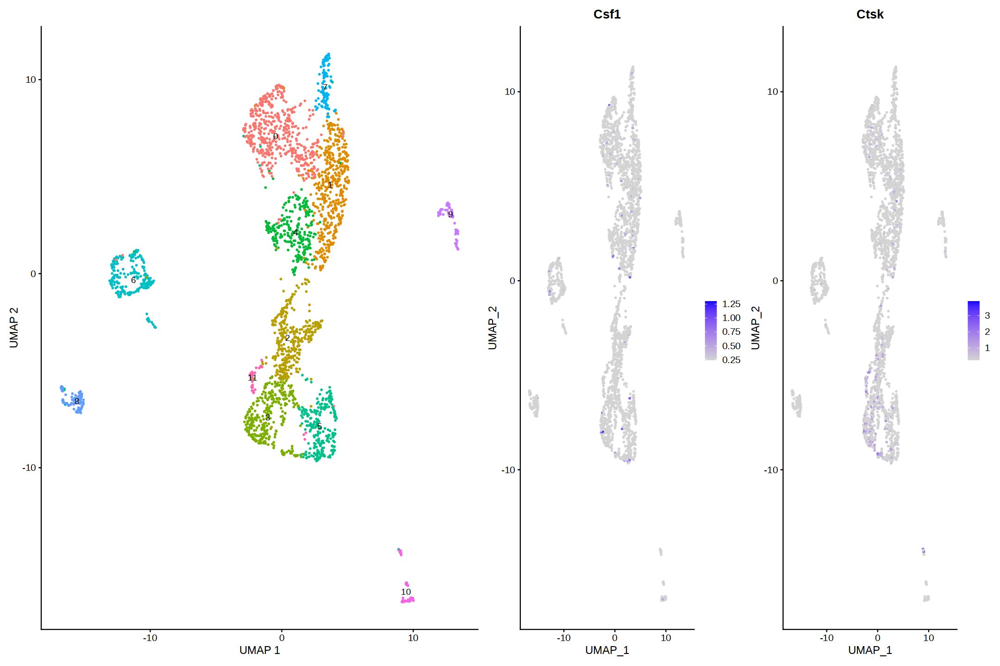

In [92]:
# Osteoclasts
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Csf1", "Ctsk"), min.cutoff = "q1")  

p1 + p2

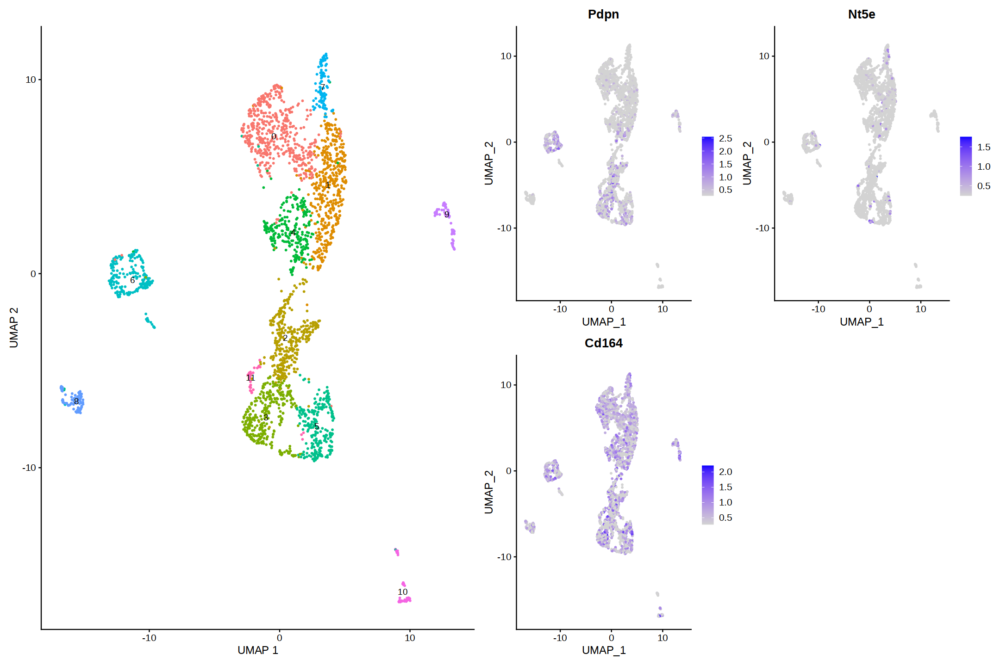

In [93]:
# Periosteal stem cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Pdpn", "Nt5e", "Cd164"), min.cutoff = "q1")  

p1 + p2

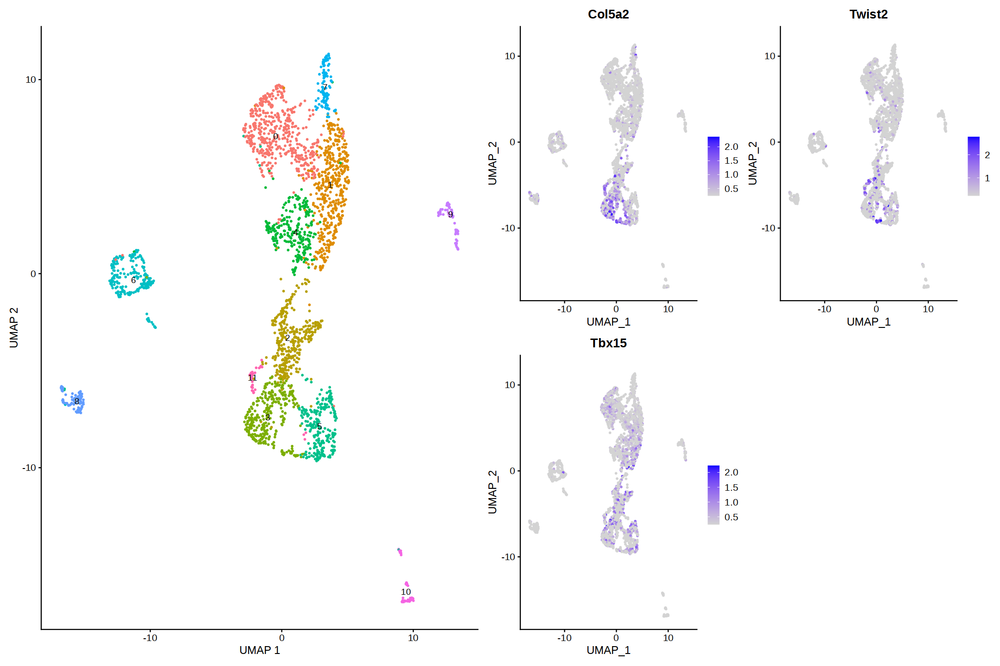

In [94]:
# Periosteal progenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Col5a2", "Twist2", "Tbx15"), min.cutoff = "q1")  

p1 + p2

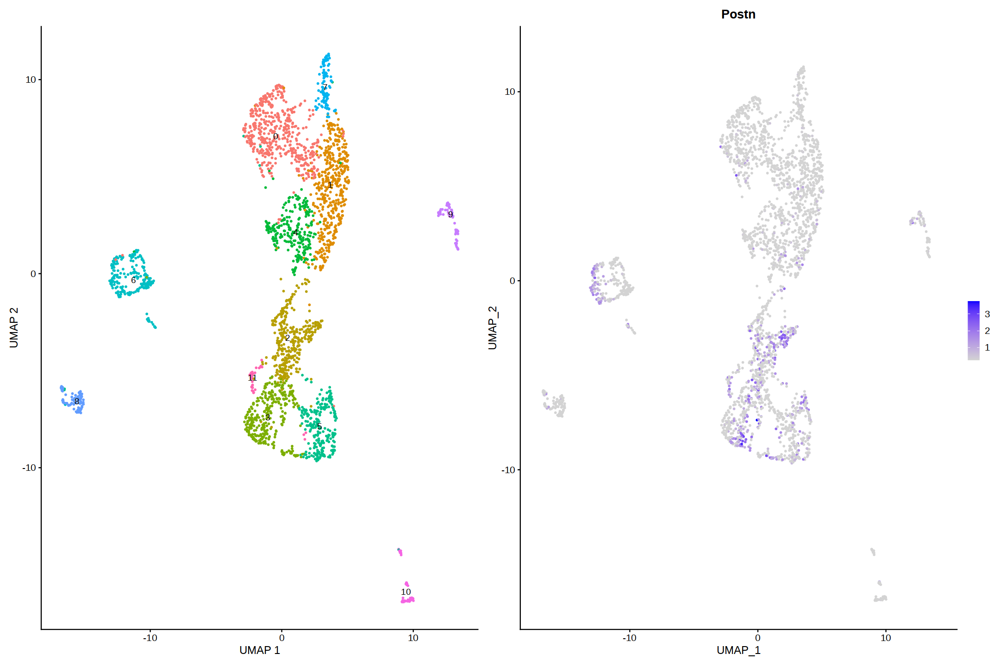

In [95]:
# Periosteum
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Postn"), min.cutoff = "q1")  

p1 + p2

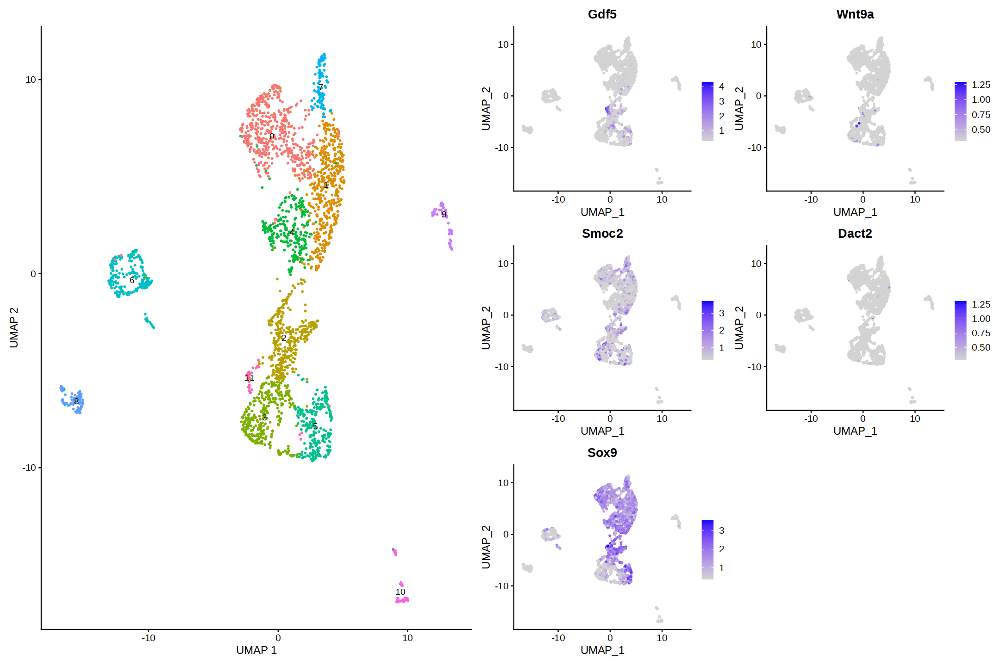

In [96]:
# Joint precursors: sox9-
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Gdf5", "Wnt9a", "Smoc2", "Dact2","Sox9"), min.cutoff = "q1")  

p1 + p2

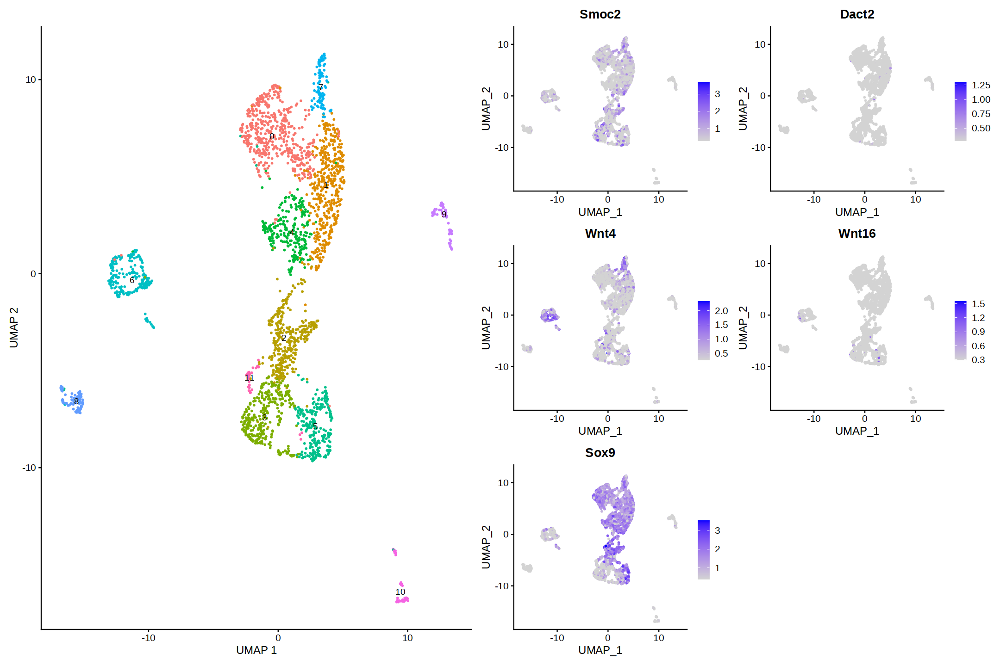

In [97]:
# Interzone cells: sox9-
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Smoc2", "Dact2", "Wnt4", "Wnt16","Sox9"), min.cutoff = "q1")  

p1 + p2

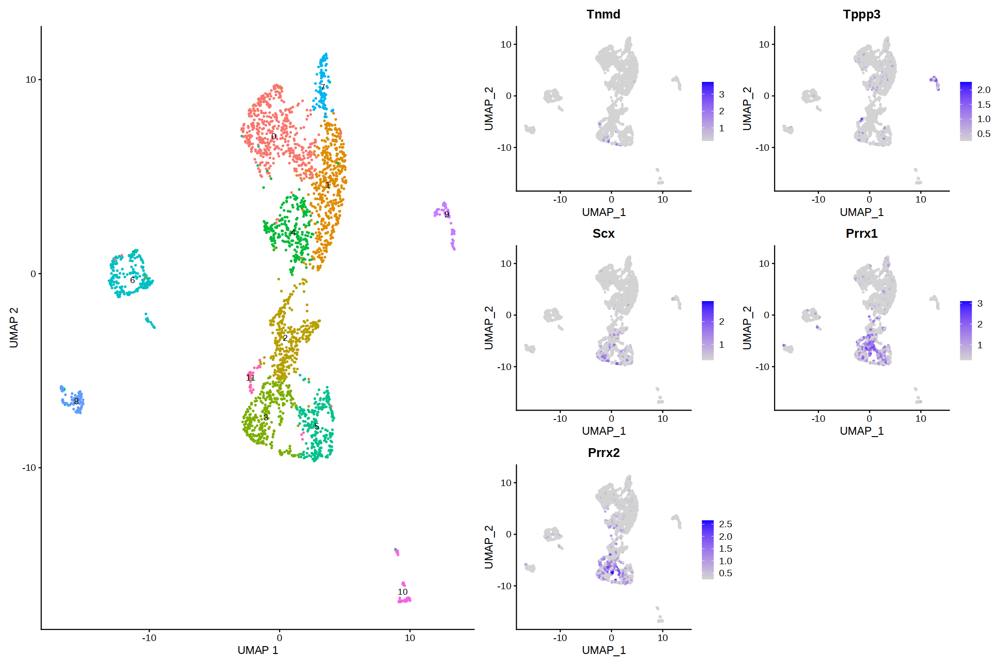

In [98]:
# Tenocyte precursors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Tnmd", "Tppp3", "Scx", "Prrx1", "Prrx2"), min.cutoff = "q1")  

p1 + p2

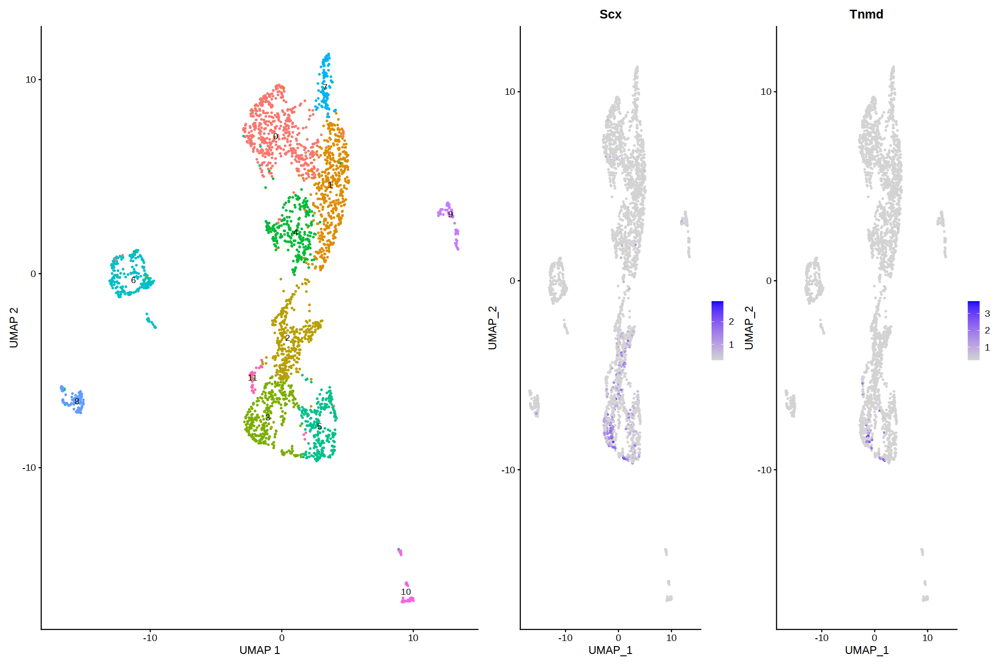

In [99]:
# Tenocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Scx", "Tnmd"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Dra, Hla”


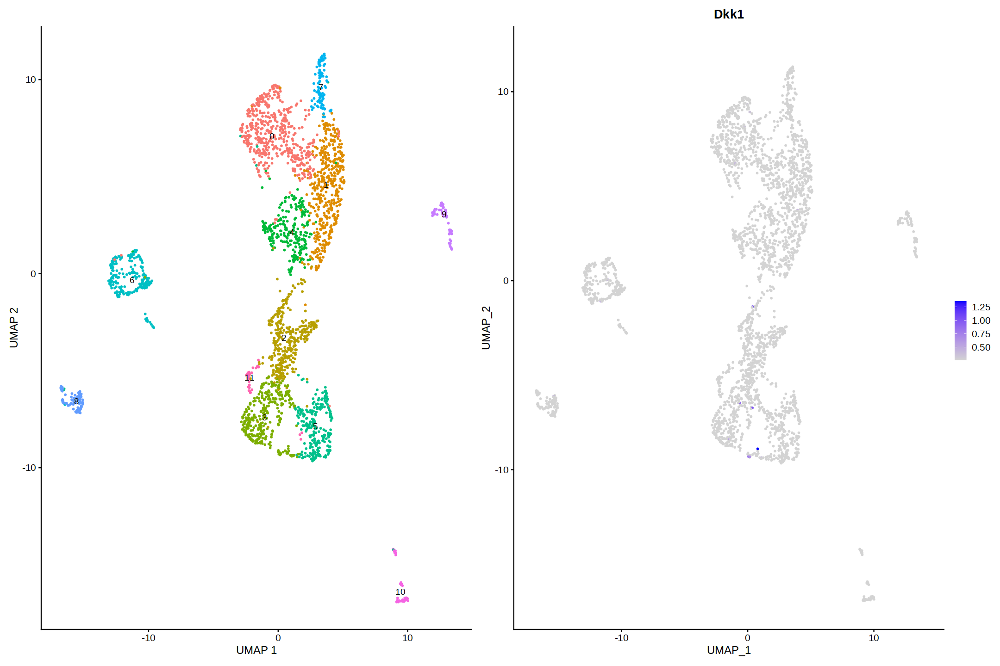

In [100]:
# Synovial fibroblasts: Hla-
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Dkk1", "Dra","Hla"), min.cutoff = "q1")  

p1 + p2

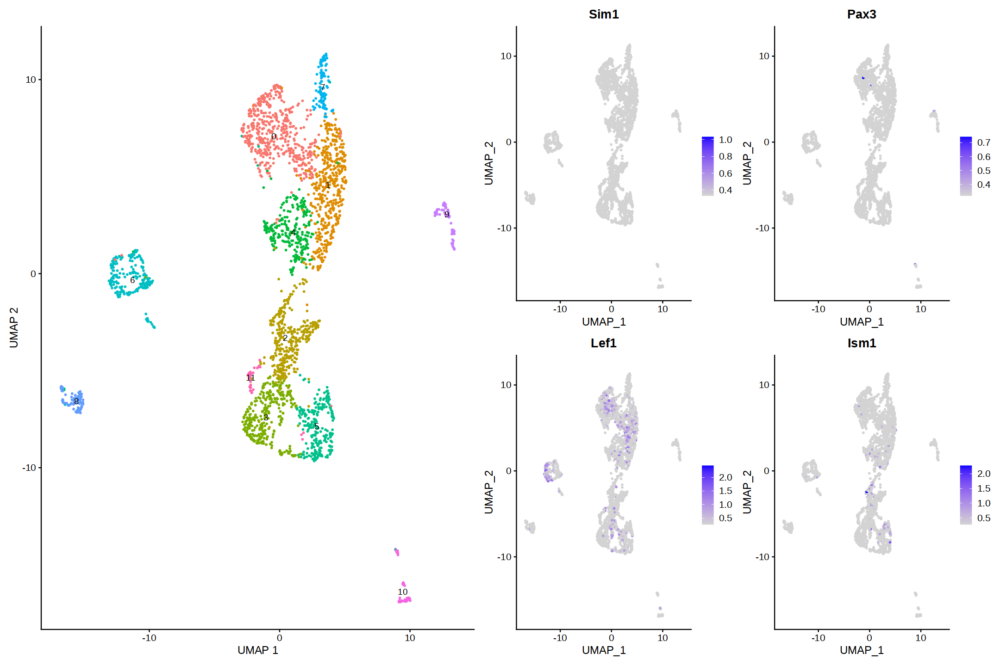

In [101]:
# Dermomyotome
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Sim1", "Pax3", "Lef1", "Ism1"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Myhc, Mrf4”


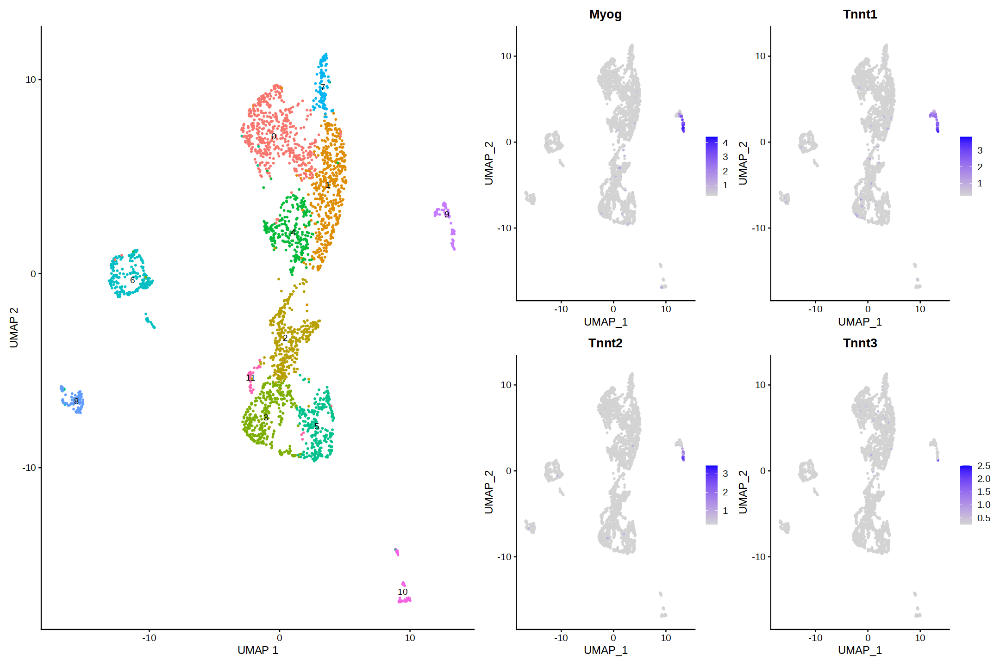

In [102]:
# Skeletal muscle cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Myhc", "Mrf4","Myog",'Tnnt1','Tnnt2','Tnnt3'), min.cutoff = "q1")  

p1 + p2

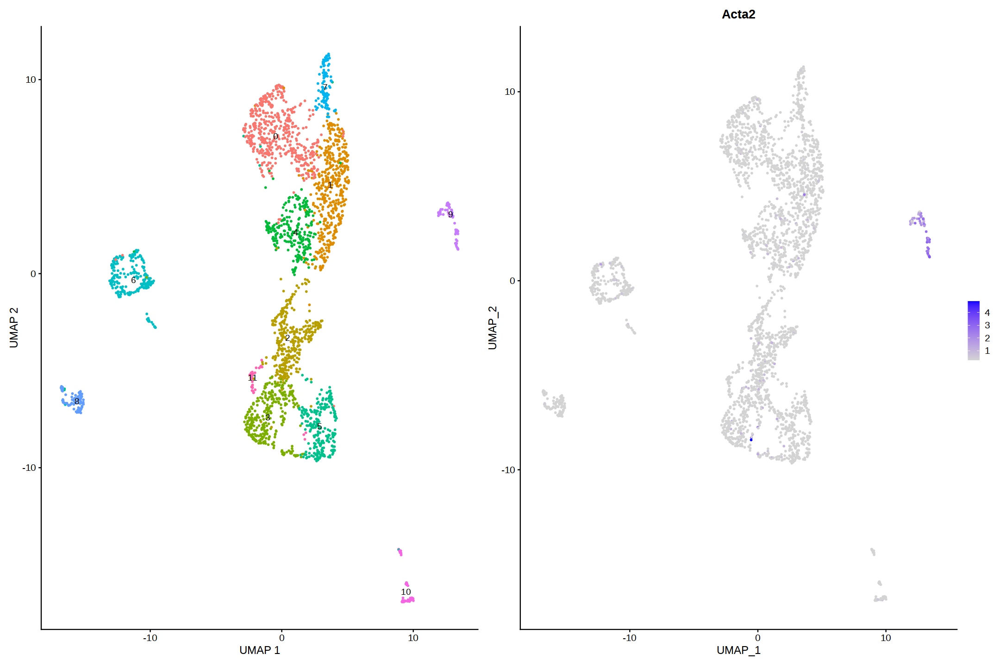

In [103]:
# Smooth muscle cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Acta2"), min.cutoff = "q1")  

p1 + p2

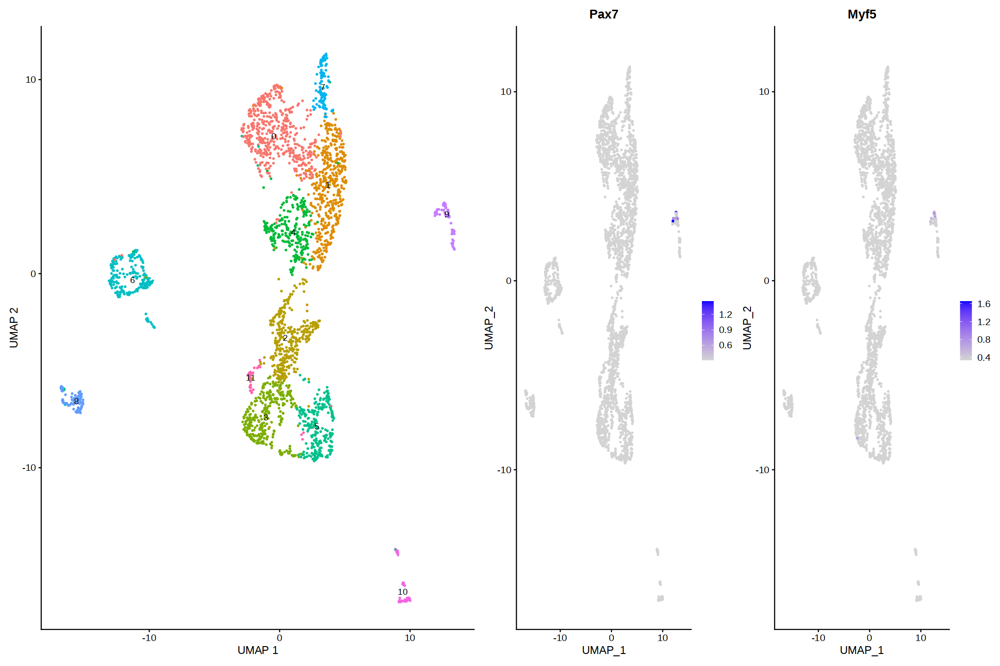

In [104]:
# Myogenic stem cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Pax7","Myf5"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Notch, Myod”


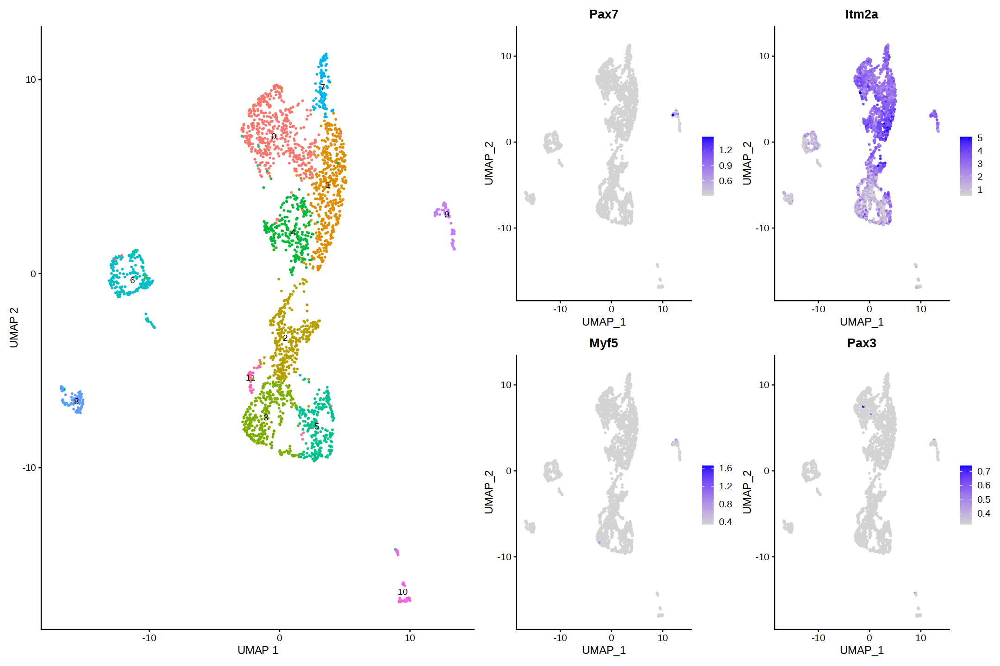

In [105]:
# Muscle progenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Pax7", "Notch", "Itm2a", "Myf5", "Pax3", "Myod"), min.cutoff = "q1")  

p1 + p2

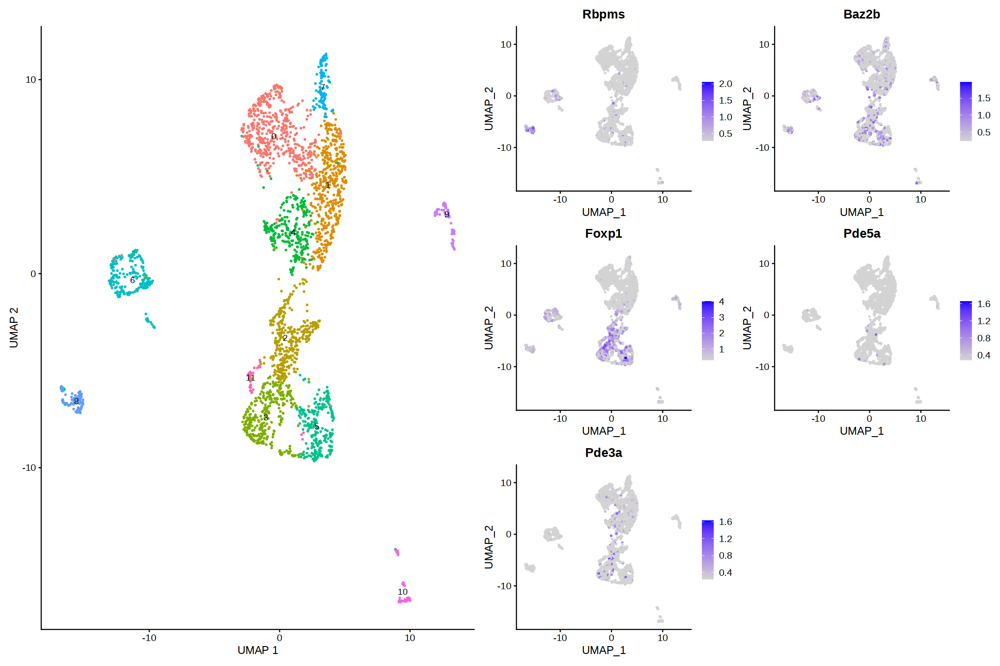

In [106]:
# Cardiomyocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Rbpms", "Baz2b", "Foxp1", "Pde5a", "Pde3a"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Adipoq”


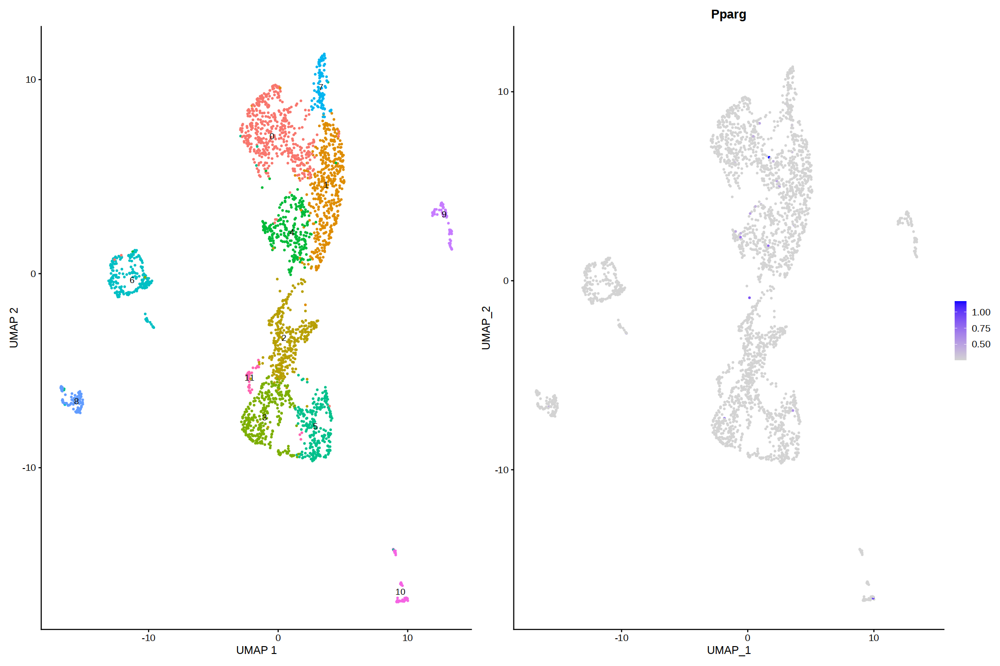

In [107]:
# Adipocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Pparg", "Adipoq"), min.cutoff = "q1")  

p1 + p2

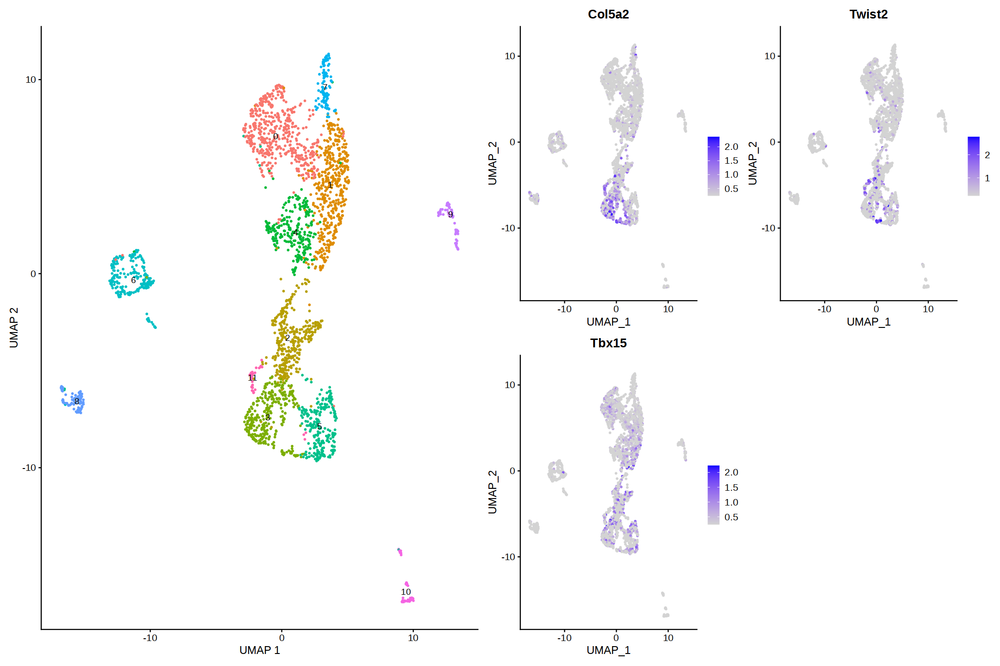

In [108]:
# Perichondrium
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Col5a2", "Twist2", "Tbx15"), min.cutoff = "q1")  

p1 + p2

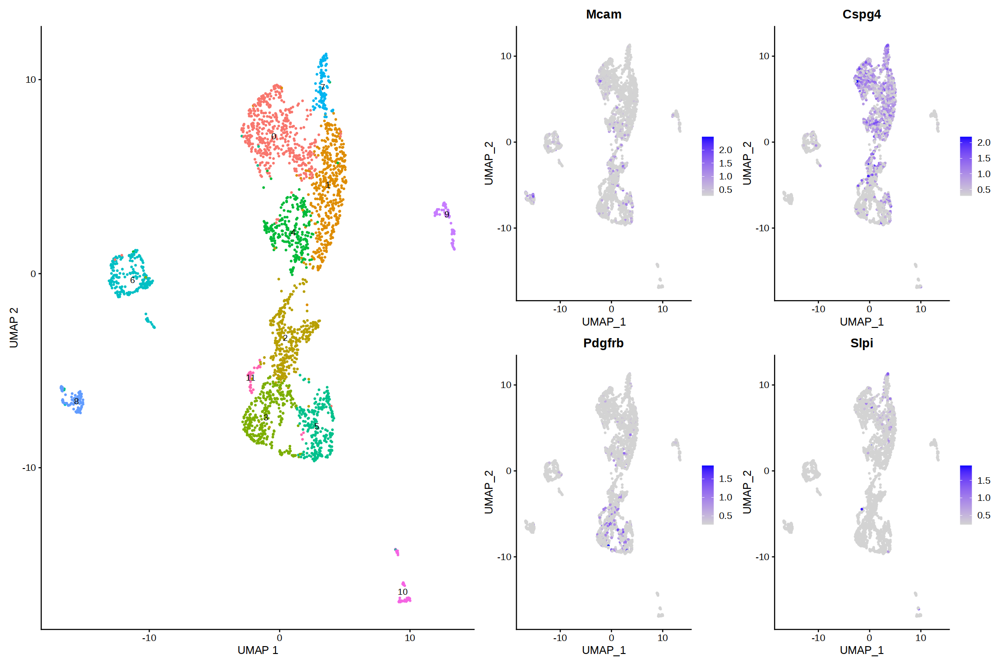

In [109]:
# Pericytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Mcam", "Cspg4", "Pdgfrb", "Slpi"), min.cutoff = "q1")  

p1 + p2

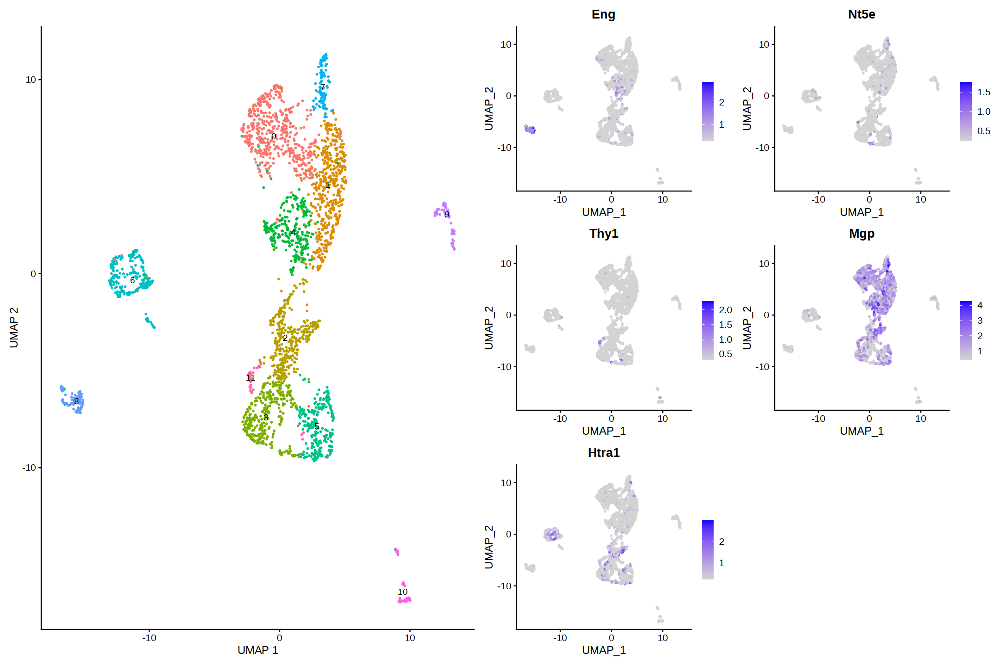

In [110]:
# BMSC
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Eng", "Nt5e", "Thy1", "Mgp","Htra1"), min.cutoff = "q1")  

p1 + p2

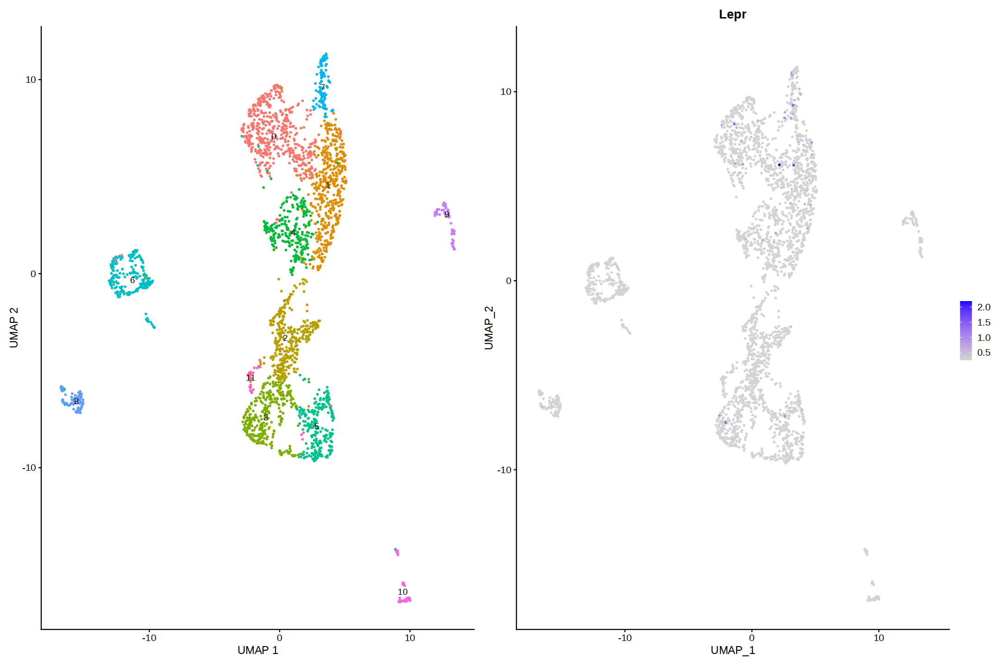

In [111]:
# LepR+ BMSC
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Lepr"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Sca1”


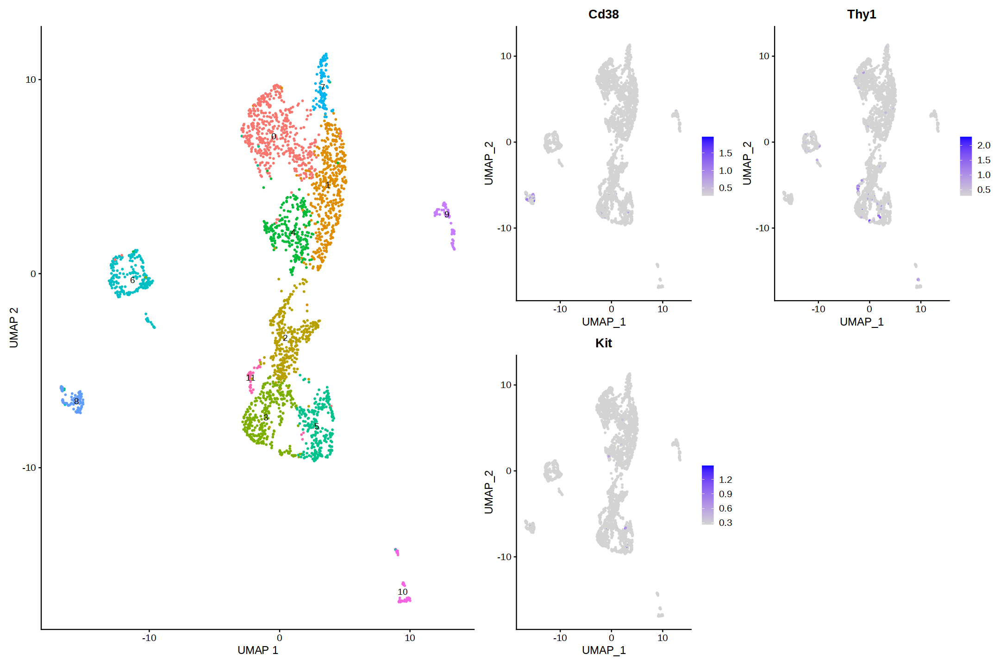

In [112]:
# Hematopoetic stem cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Cd38", "Thy1", "Kit", "Sca1"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Gypa, ”


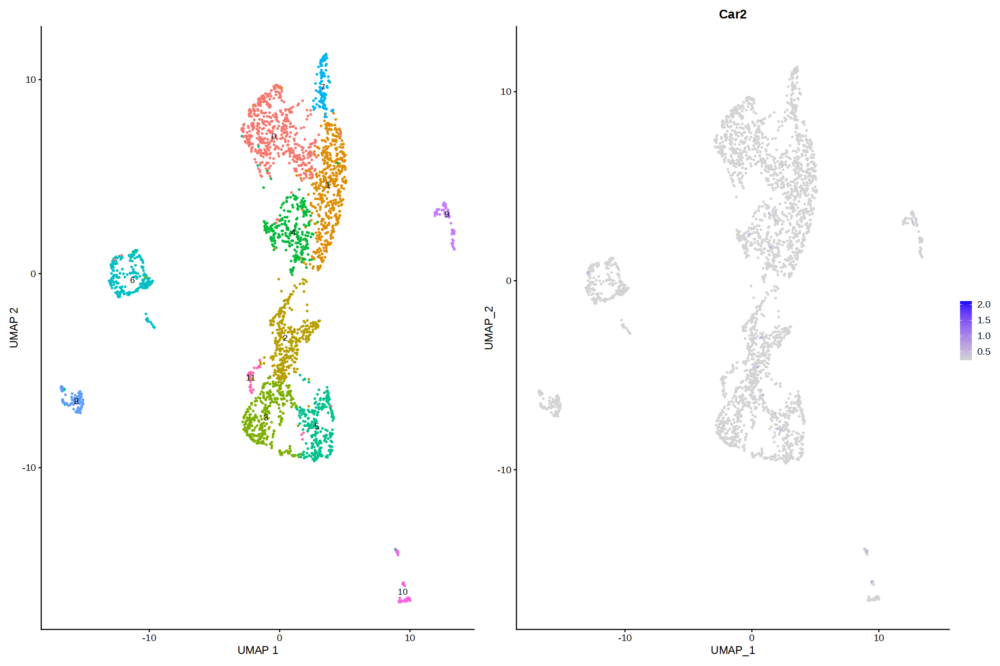

In [113]:
# Erythroid cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Gypa","Car2",""), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: F2rl2”


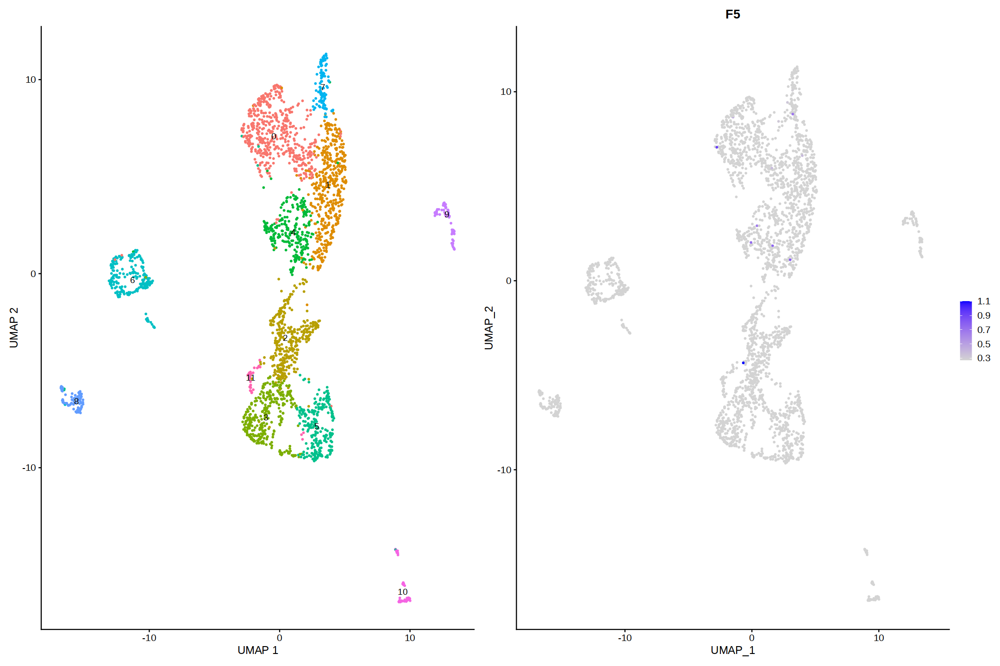

In [114]:
# Platelets
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("F2rl2", "F5"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Gata1, Gp6, Gp1ba”


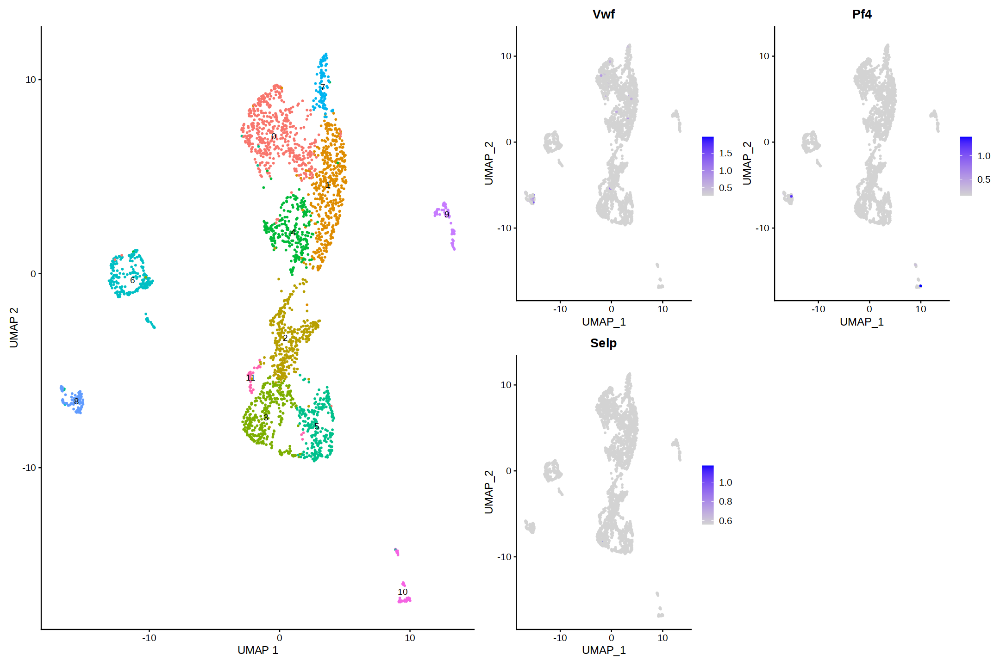

In [115]:
# Megakaryocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Vwf", "Pf4", "Gata1", "Selp", "Gp6", "Gp1ba"), min.cutoff = "q1")  

p1 + p2

Warning message in FeaturePlot(A, c("Cd3g", "Cd19", "Cd68", "Cxcr2", "Mrc1", "Flt3"), :
“All cells have the same value (1.22109965633974) of Cd19.”


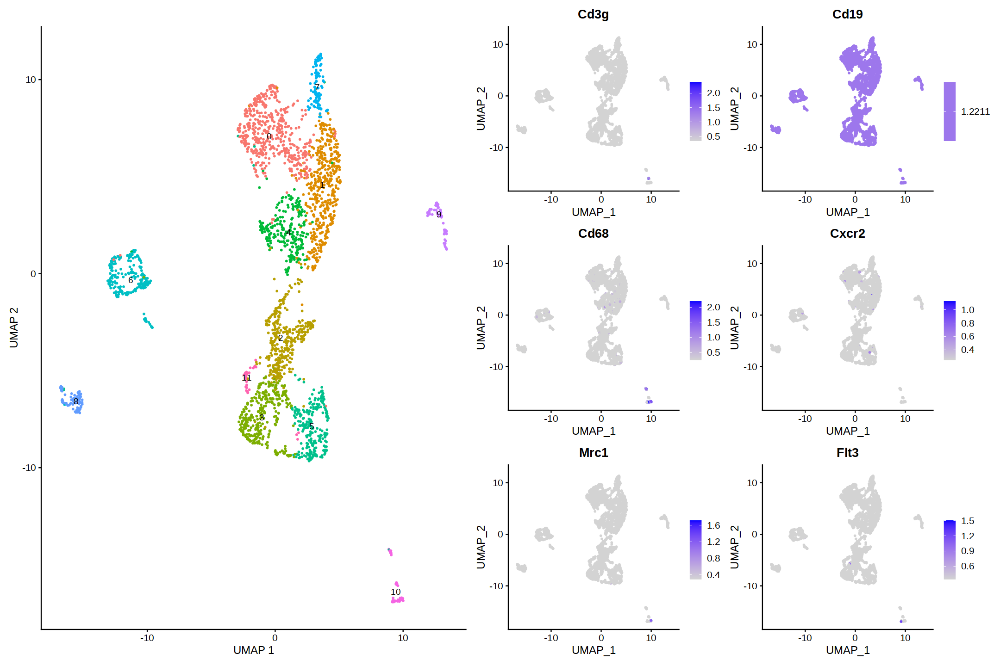

In [116]:
# Immune cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Cd3g", "Cd19", "Cd68", "Cxcr2","Mrc1","Flt3"), min.cutoff = "q1")  

p1 + p2

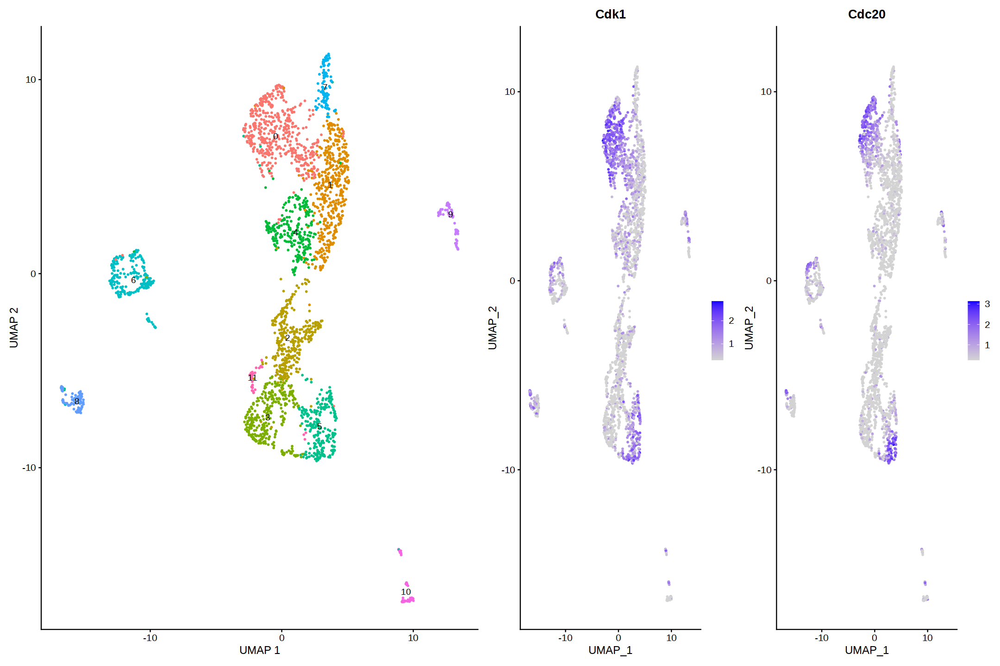

In [117]:
# Fast proliferating cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Cdk1","Cdc20"), min.cutoff = "q1")  

p1 + p2

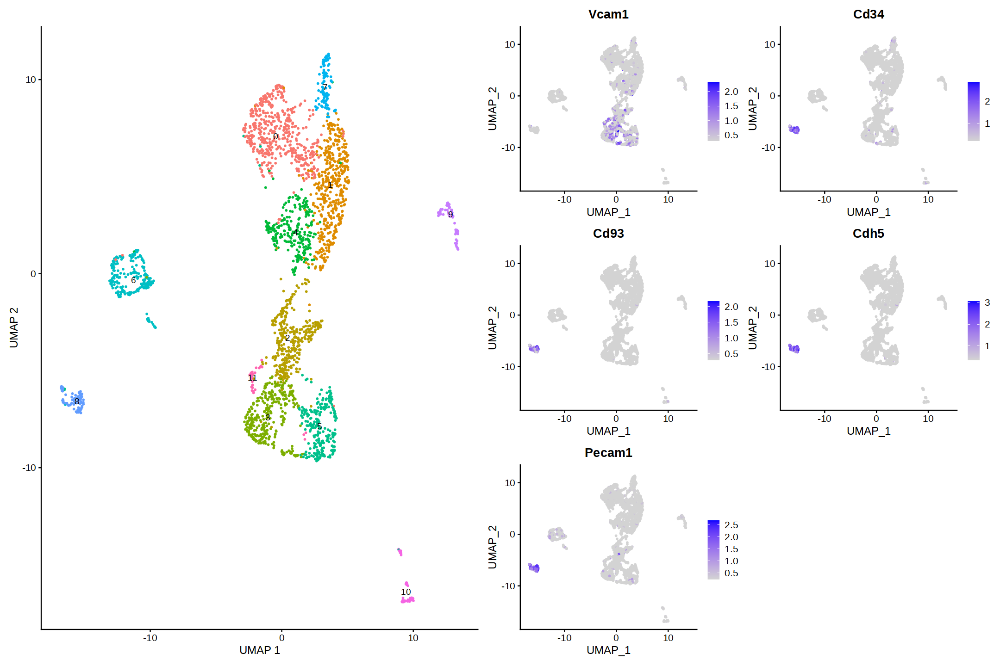

In [118]:
# Vascular endothelial cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Vcam1", "Cd34", "Cd93", "Cdh5","Pecam1"), min.cutoff = "q1")  

p1 + p2

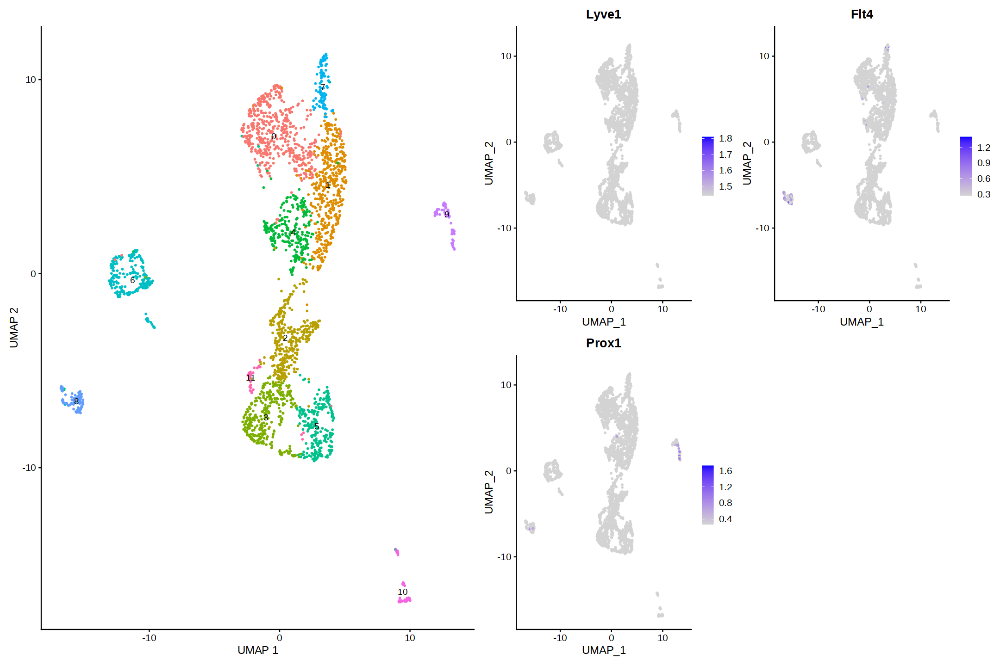

In [119]:
# Lymphatic endothelial cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Lyve1", "Flt4", "Prox1"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Fgf4”


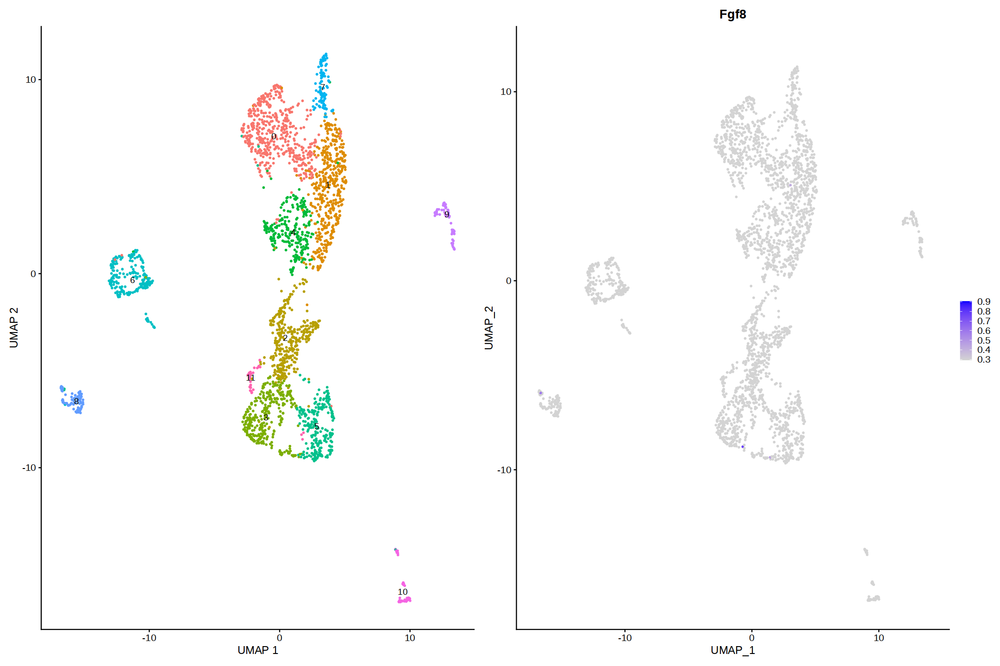

In [120]:
# Apical ectodermal ridge
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Fgf8", "Fgf4"), min.cutoff = "q1")  

p1 + p2

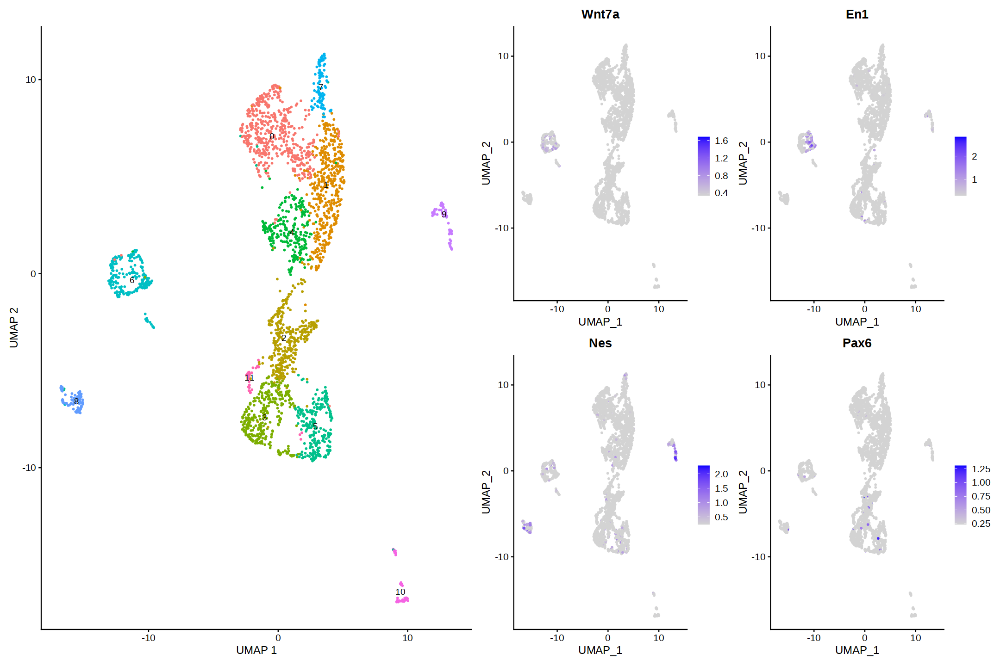

In [121]:
# Ectoderm
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Wnt7a", "En1", "Nes", "Pax6"), min.cutoff = "q1")  

p1 + p2

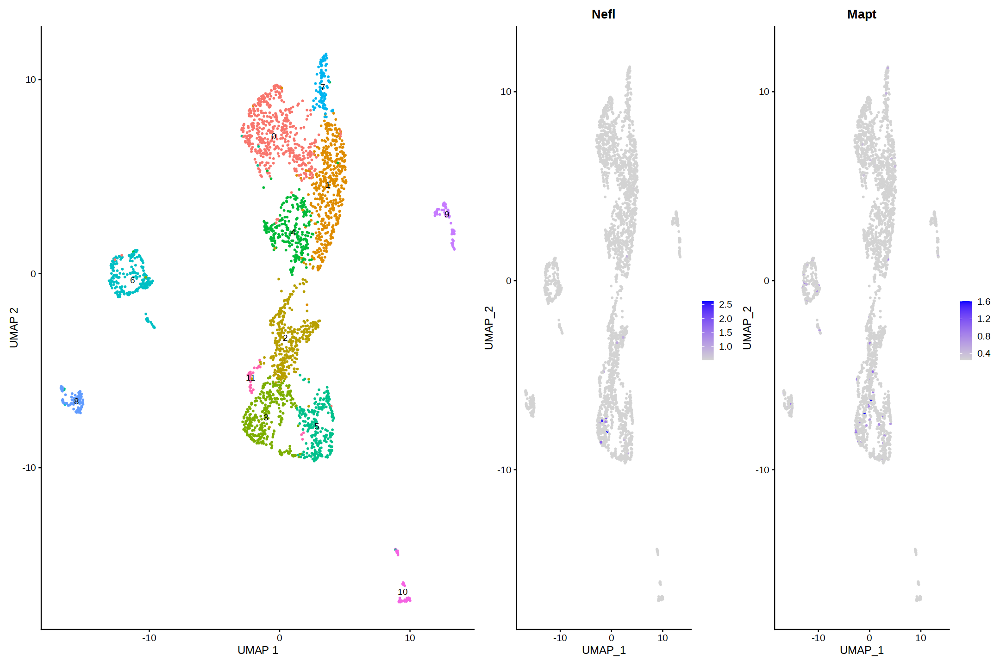

In [122]:
# Neurons
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Nefl", "Mapt"), min.cutoff = "q1")  

p1 + p2

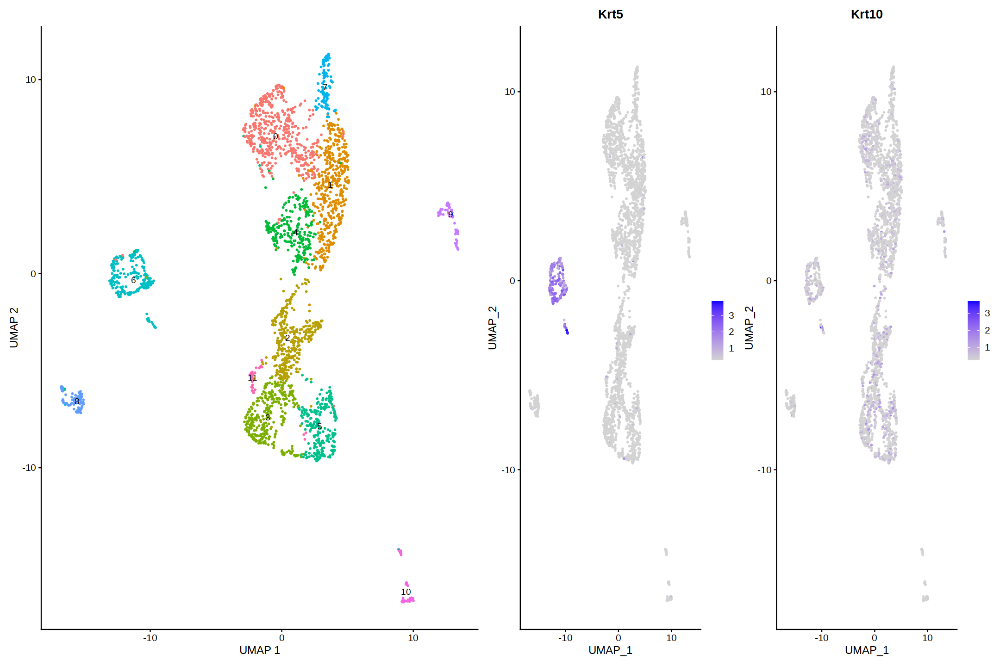

In [123]:
# Skin
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Krt5", "Krt10"), min.cutoff = "q1")  

p1 + p2

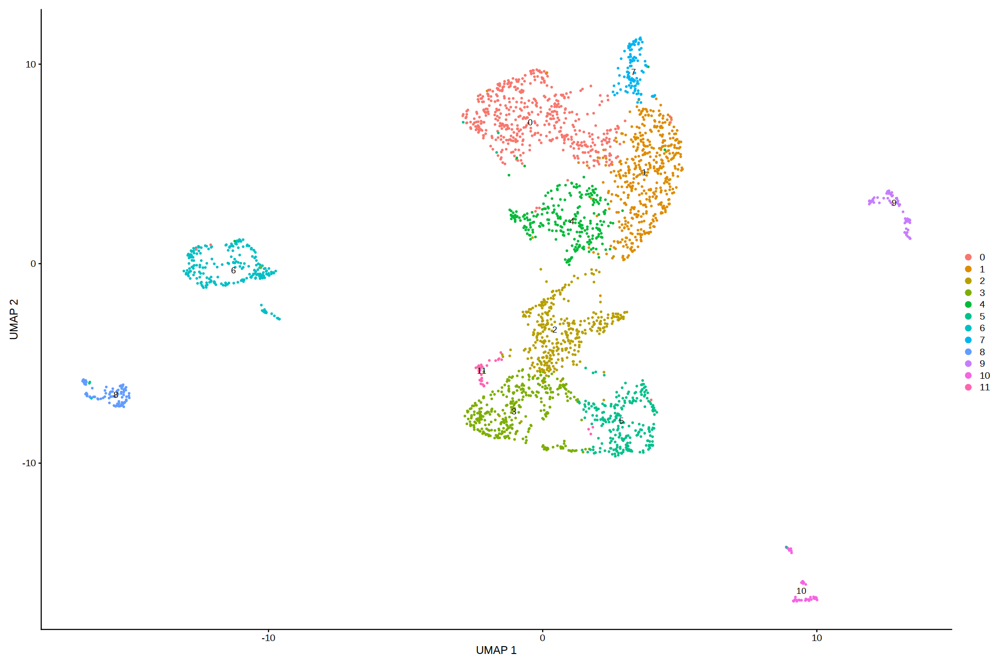

In [124]:
DimPlot(A, label = TRUE) + xlab("UMAP 1") + ylab("UMAP 2")

### 3.4. Differential expression analysis<a id="12"></a>
#### 3.4.1. Global annotation by differential expression analysis<a id="13"></a>

Seurat identifies markers that define clusters via differential expression. By default, it identifes positive and negative markers of a single cluster (specified in ident.1), compared to all other cells. `FindAllMarkers` automates this process for all clusters, but it is possible to test groups of clusters vs. each other, or against all cells.

The `min.pct` argument requires a feature to be detected at a minimum percentage in either of the two groups of cells, and the `thresh.test` argument requires a feature to be differentially expressed (on average) by some amount between the two groups. You can set both of these to 0, but with a dramatic increase in time - since this will test a large number of features that are unlikely to be highly discriminatory. As another option to speed up these computations, `max.cells.per.ident` can be set. This will downsample each identity class to have no more cells than whatever this is set to. While there is generally going to be a loss in power, the speed increases can be significiant and the most highly differentially expressed features will likely still rise to the top.

In [60]:
# Seurat default settings
A.markers <- FindAllMarkers(A, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11



In [63]:
#select only cluster 0 and order avg_log2FC from big to small

A.markers[A.markers$cluster == 7,] %>%
slice_max(n = 20, order_by = avg_log2FC)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Sfn1,3.722892e-172,4.848173,1.000,0.121,6.331895e-168,7,Sfn
Krt141,7.200561e-136,4.603116,0.938,0.132,1.224671e-131,7,Krt14
Slc2a31,2.335816e-123,4.567282,1.000,0.208,3.972756e-119,7,Slc2a3
Krt8,2.570010e-187,4.244346,0.991,0.101,4.371073e-183,7,Krt8
Tacstd2,6.721961e-299,4.214687,0.991,0.040,1.143271e-294,7,Tacstd2
Cldn41,2.910262e-192,4.213355,1.000,0.099,4.949773e-188,7,Cldn4
Krt181,2.920860e-112,3.762145,0.991,0.231,4.967799e-108,7,Krt18
Krt17,5.484429e-117,3.561044,0.589,0.043,9.327917e-113,7,Krt17
Cldn3,0.000000e+00,3.381487,0.991,0.034,0.000000e+00,7,Cldn3


In [87]:
#dir.create("./6-kmita/analysis")
write.csv(A.markers, file = "A.markers_e12.5.csv", quote = FALSE)

**Adding cell types**

In [166]:
A@meta.data$CellType <- NULL

In [167]:
#creating column that contains cell type 
A@meta.data$CellType <- Idents(A)

In [168]:
A@meta.data$CellType <- as.character(A@meta.data$CellType)

A@meta.data$CellType[A@meta.data$CellType == '0'] <- 'Chondrocytes'
A@meta.data$CellType[A@meta.data$CellType == '1'] <- 'Chondrocytes'
A@meta.data$CellType[A@meta.data$CellType == '2'] <- 'Chondrocytes'
A@meta.data$CellType[A@meta.data$CellType == '3'] <- 'Mysenchyme'
A@meta.data$CellType[A@meta.data$CellType == '4'] <- 'Chondrocytes'
A@meta.data$CellType[A@meta.data$CellType == '5'] <- 'Chondrocytes'
A@meta.data$CellType[A@meta.data$CellType == '6'] <- 'Embryonic skin'
A@meta.data$CellType[A@meta.data$CellType == '7'] <- 'Chondrocytes'
A@meta.data$CellType[A@meta.data$CellType == '8'] <- 'Vascular endothelial cells'
A@meta.data$CellType[A@meta.data$CellType == '9'] <- 'Myocyte'
A@meta.data$CellType[A@meta.data$CellType == '10'] <- 'Imune cells'
A@meta.data$CellType[A@meta.data$CellType == '11'] <- 'Chondrocytes'

A@meta.data$CellType <- as.factor(A@meta.data$CellType)

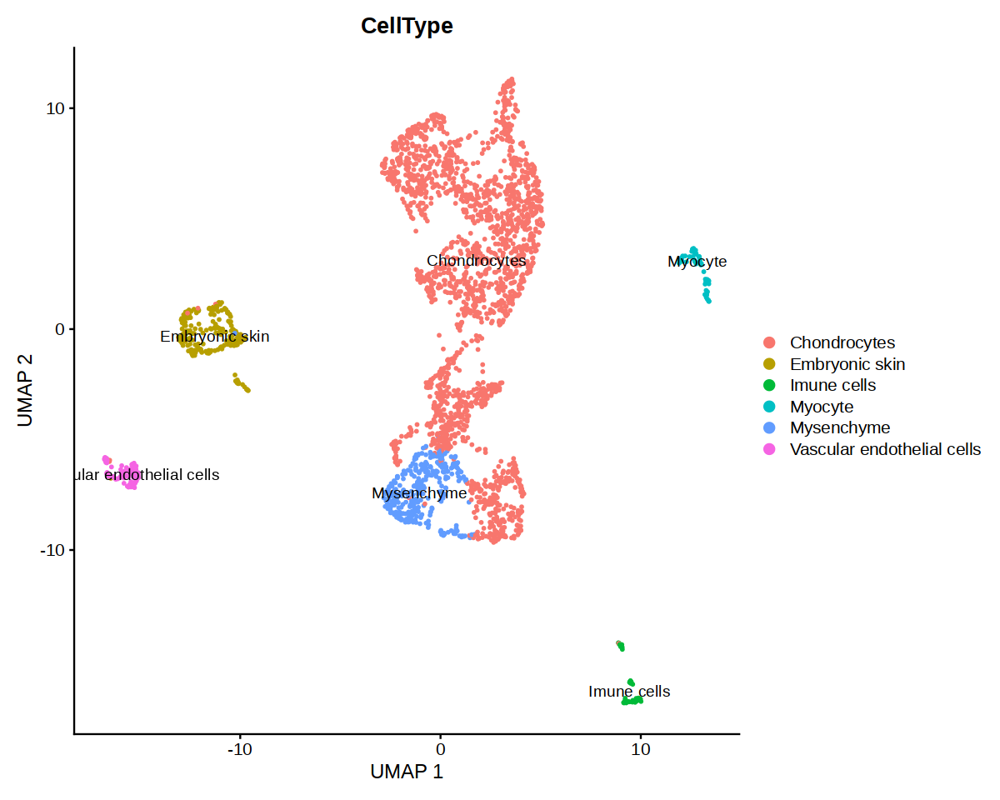

In [169]:
options(repr.plot.width = 10, repr.plot.height = 8)

DimPlot(A, reduction = "umap", label = TRUE, group.by = "CellType") + xlab("UMAP 1") + ylab("UMAP 2")

In [170]:
Idents(A)<-A@meta.data$CellType

#### 3.4.2. Refinement of global annotations<a id="13.2"></a>
##### 3.4.2.1. Subsetting mesenchymal clusters<a id="14"></a>

In [297]:
A_chondrocytes <- subset(A, idents = c("Chondrocytes"))

In [298]:
A_chondrocytes

An object of class Seurat 
17454 features across 1948 samples within 1 assay 
Active assay: RNA (17454 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [299]:
A_chondrocytes <- ScaleData(A_chondrocytes)

Centering and scaling data matrix



In [300]:
A_chondrocytes <- RunPCA(A_chondrocytes, features = VariableFeatures(object = A_chondrocytes), verbose = FALSE)

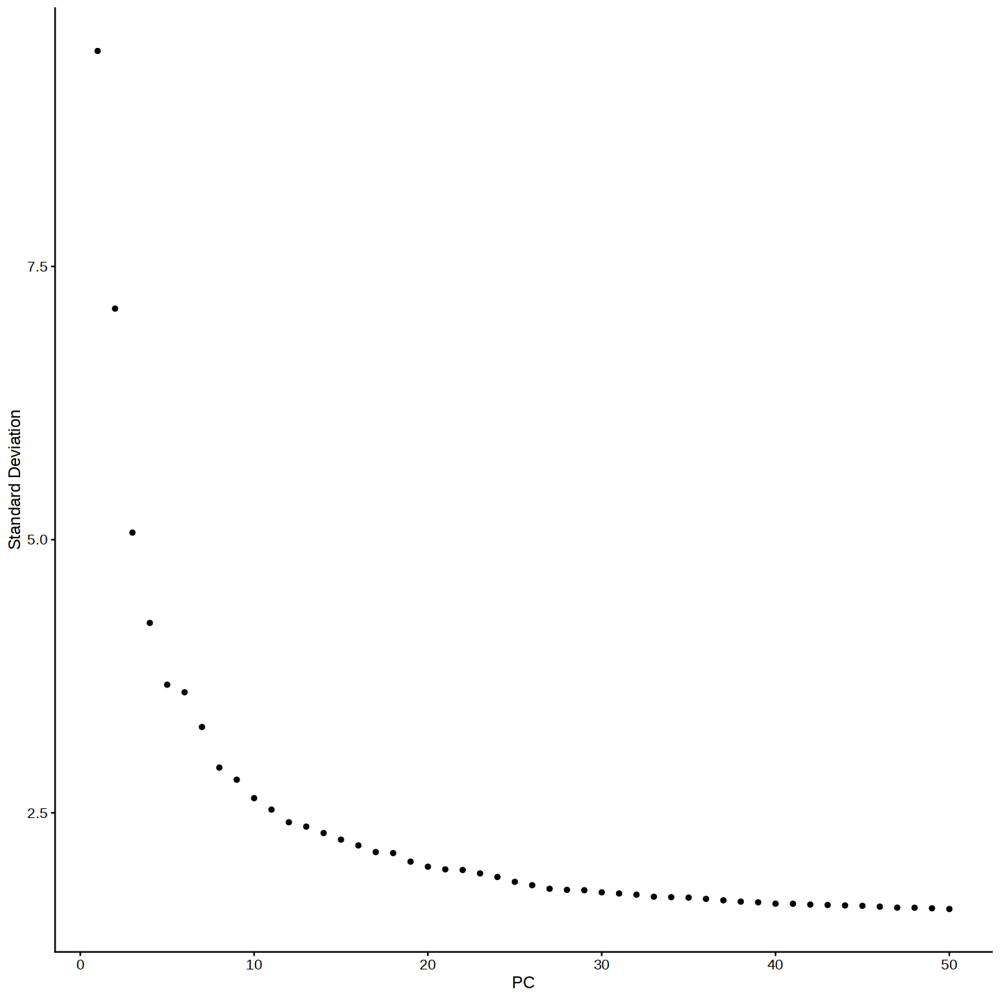

In [301]:
ElbowPlot(A_chondrocytes, 50)

In [302]:
A_chondrocytes <- FindNeighbors(A_chondrocytes, dims = 1:25, verbose = FALSE)
A_chondrocytes <- FindClusters(A_chondrocytes, resolution = 1.5, verbose = FALSE)

In [303]:
A_chondrocytes <- RunUMAP(A_chondrocytes, dims = 1:25, n.neighbors = 12, verbose = FALSE)

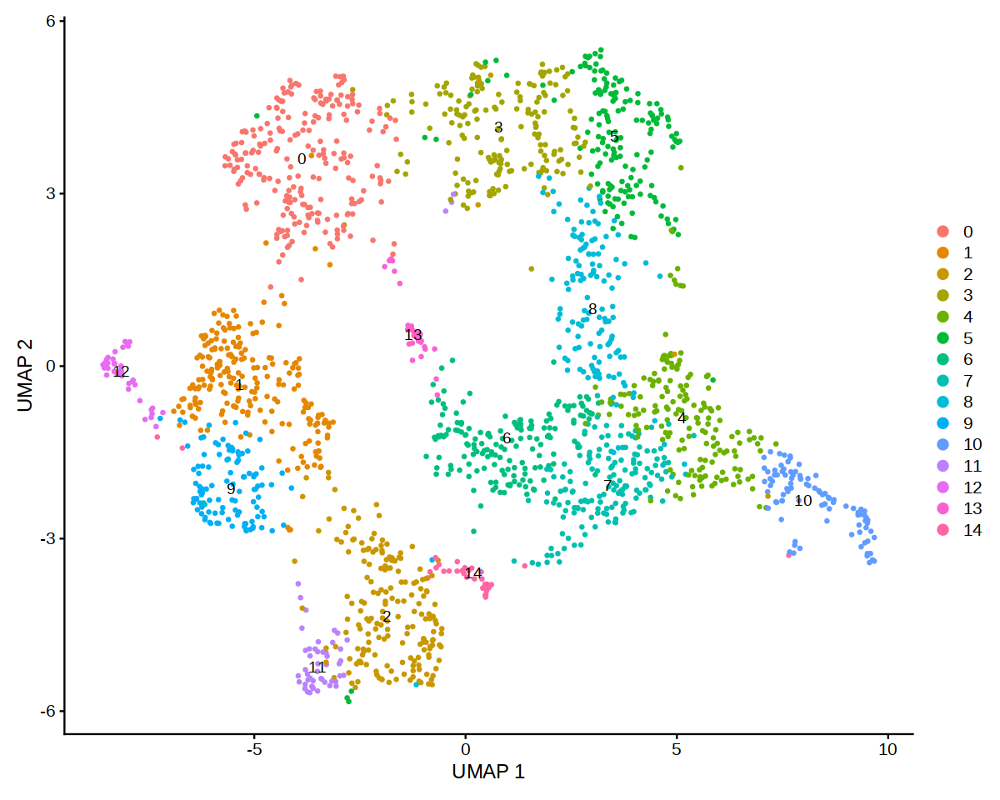

In [304]:
options(repr.plot.width = 10, repr.plot.height = 8)
DimPlot(A_chondrocytes, reduction = "umap", label=TRUE) + xlab("UMAP 1") + ylab("UMAP 2")

#ggsave("./6-kmita/images/E10_5_m_no_annotation.png" ,width=10, height=8)

In [171]:
A_chondrocytes_markers <- FindAllMarkers(A_chondrocytes)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14



In [174]:
#select only cluster 0 and order avg_log2FC from big to small

A_chondrocytes_markers[A_chondrocytes_markers$cluster == 4,] %>%
slice_max(n = 15, order_by = avg_log2FC)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Fdps.2,1.959155e-57,1.4522439,0.994,0.710,3.419510e-53,4,Fdps
Msmo1.2,8.982791e-57,1.3682576,0.934,0.441,1.567856e-52,4,Msmo1
3110079O15Rik.3,3.542732e-52,1.2085052,1.000,0.813,6.183485e-48,4,3110079O15Rik
C1qtnf3.3,9.869773e-41,1.1520174,0.988,0.634,1.722670e-36,4,C1qtnf3
Epyc.3,3.249790e-38,1.1321068,0.994,0.643,5.672184e-34,4,Epyc
Mvd.3,2.181159e-63,1.1045263,0.880,0.317,3.806995e-59,4,Mvd
Ppa1.2,2.841841e-34,1.0795151,0.982,0.780,4.960150e-30,4,Ppa1
Scd2.2,1.455827e-46,1.0330290,1.000,0.768,2.541000e-42,4,Scd2
Dhcr7.2,1.755335e-58,1.0213476,0.922,0.399,3.063762e-54,4,Dhcr7


In [102]:
write.csv(A_chondrocytes_markers, file = "A_chondrocytes.markers_e12.5.csv", quote = FALSE)

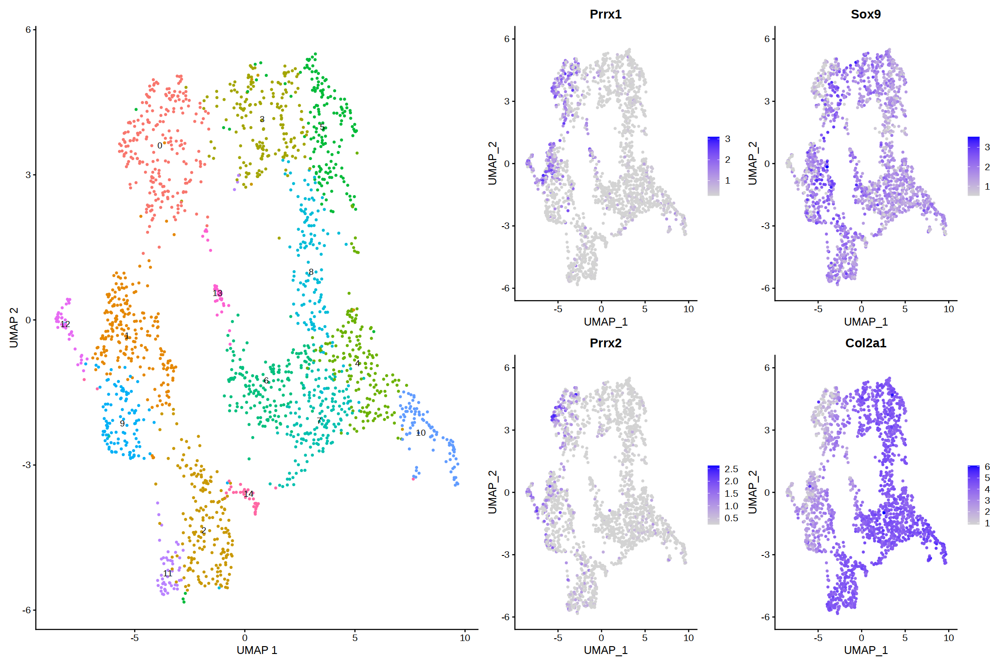

In [156]:
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Prrx1", "Sox9","Prrx2","Col2a1"), min.cutoff = "q1")  

p1 + p2

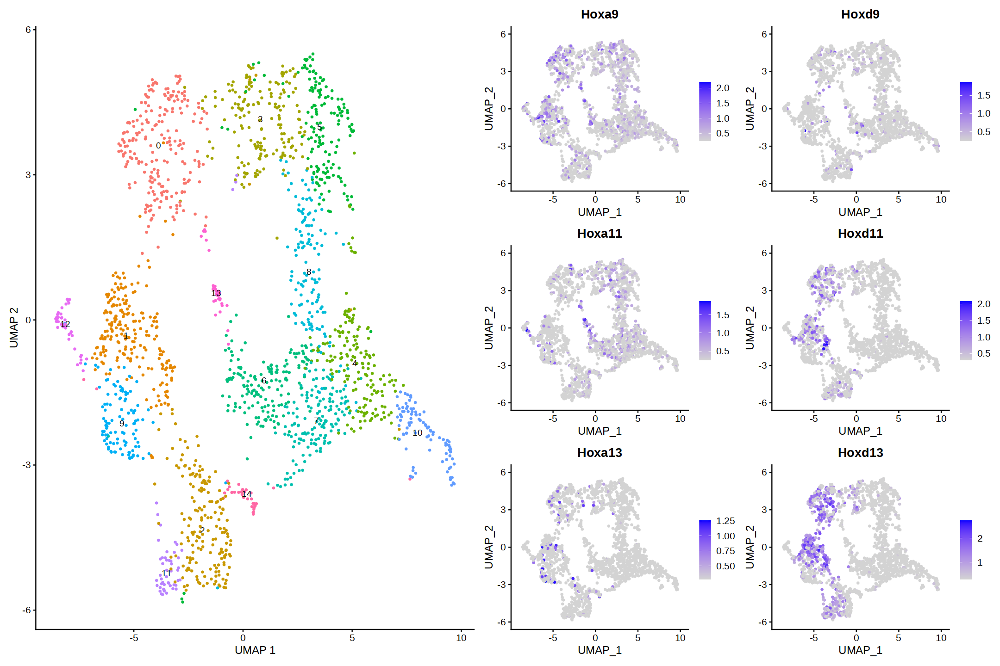

In [157]:
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Hoxa9", "Hoxd9","Hoxa11","Hoxd11","Hoxa13","Hoxd13"), min.cutoff = "q1")  

p1 + p2

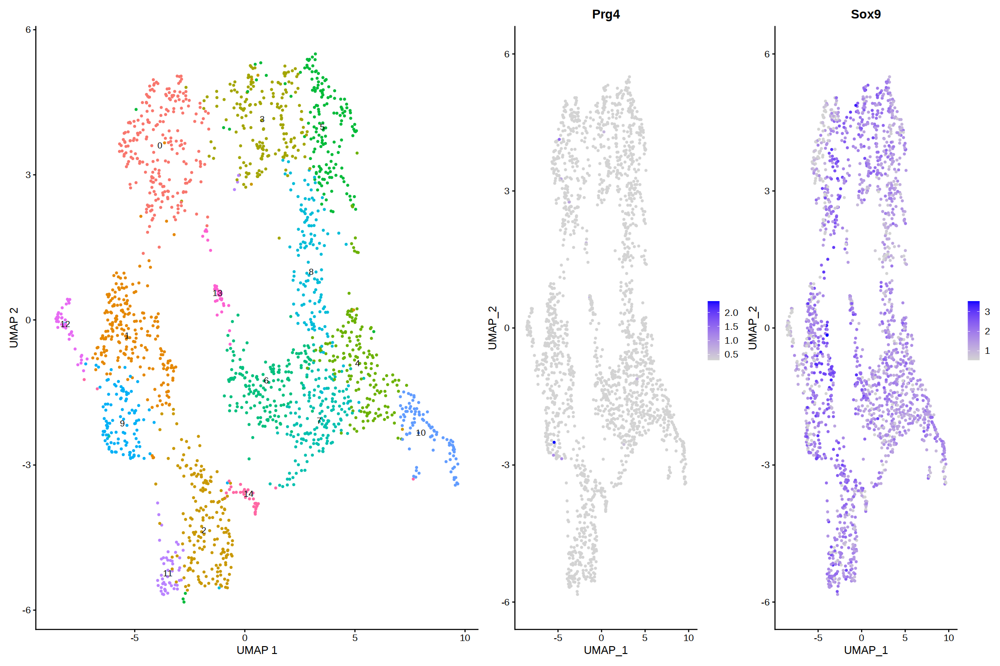

In [158]:
# Articular chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Prg4", "Sox9"), min.cutoff = "q1")  

p1 + p2

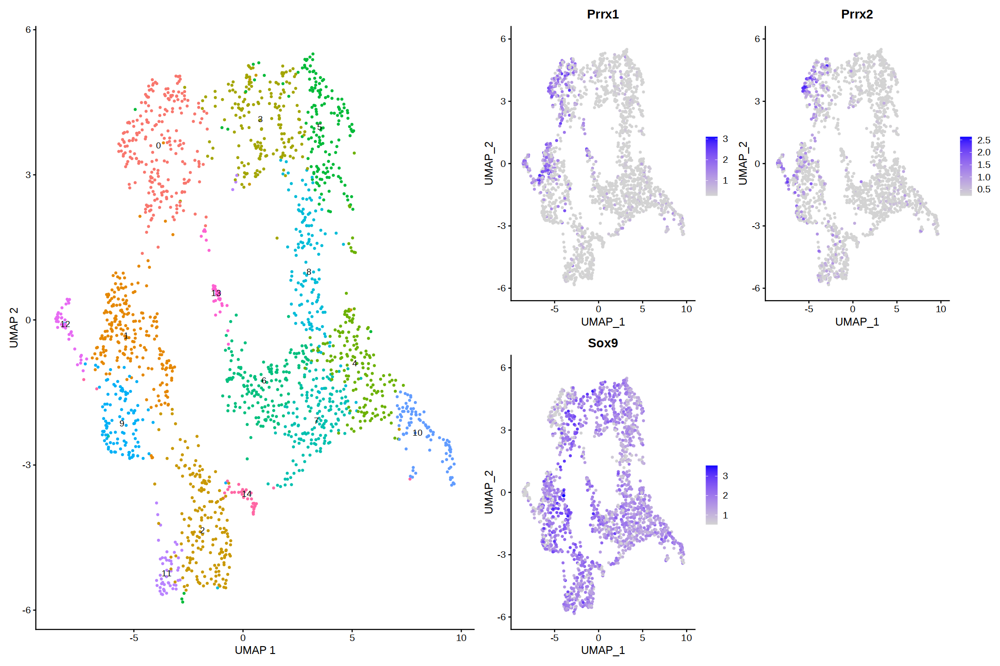

In [166]:
# Chondroprogenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Prrx1", "Prrx2", "Sox9"), min.cutoff = "q1")  

p1 + p2

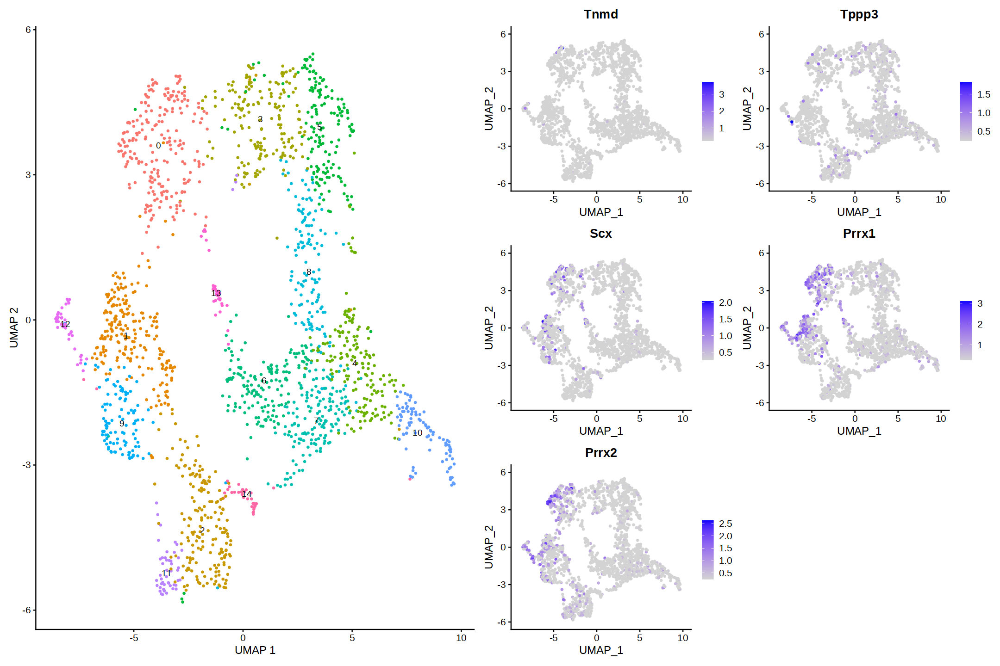

In [160]:
# Tenocyte precursors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Tnmd", "Tppp3", "Scx", "Prrx1", "Prrx2"), min.cutoff = "q1")  

p1 + p2

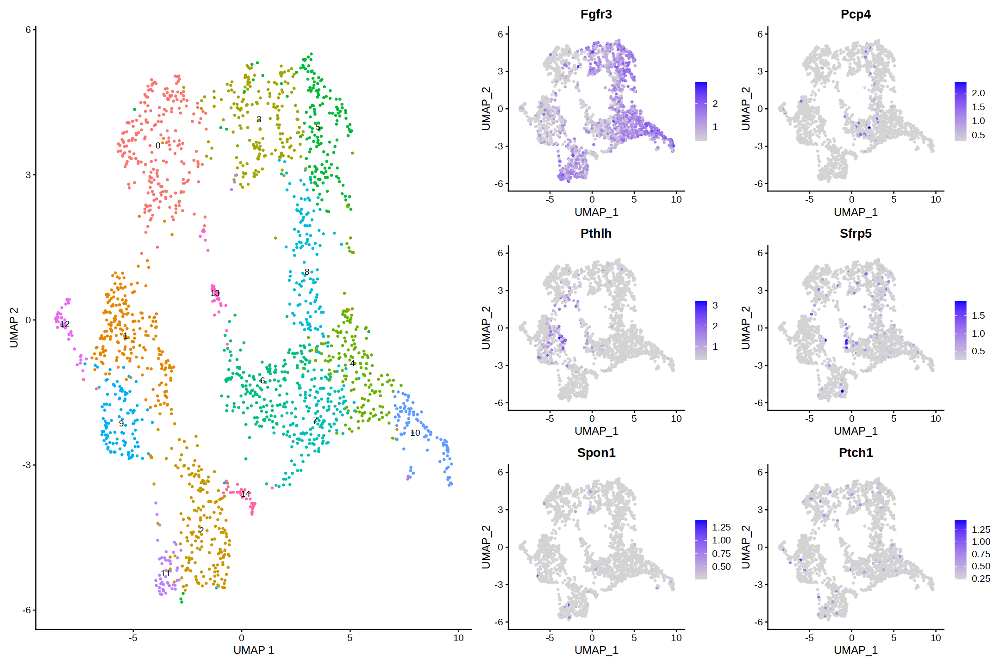

In [170]:
# Resting zone chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Fgfr3", "Pcp4", "Pthlh", "Sfrp5", "Spon1","Ptch1"), min.cutoff = "q1")  

p1 + p2

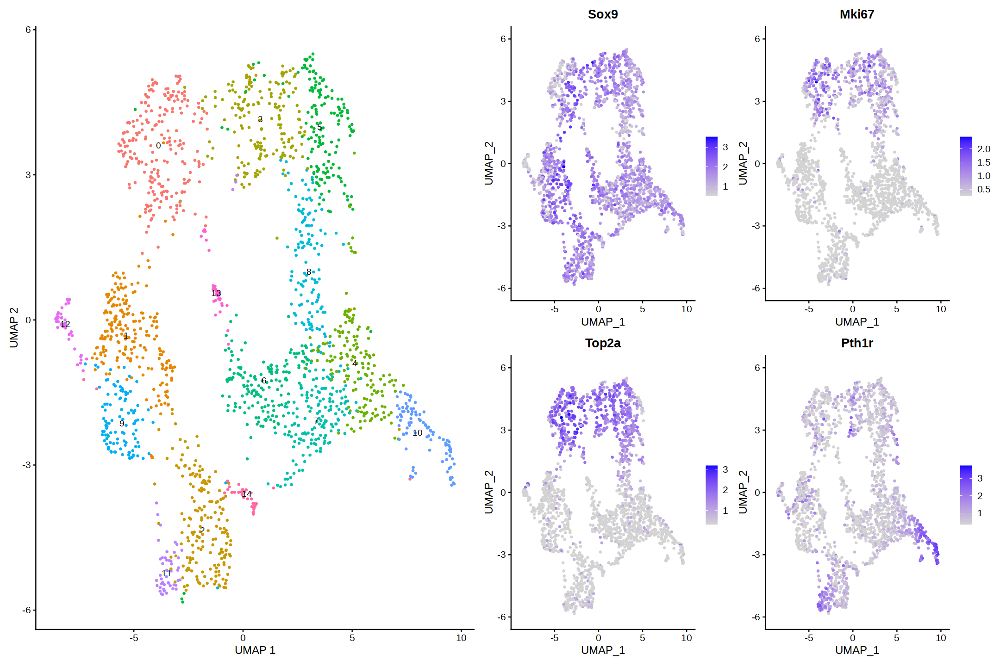

In [162]:
# Proliferative chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Sox9", "Mki67", "Top2a", "Pth1r"), min.cutoff = "q1")  

p1 + p2

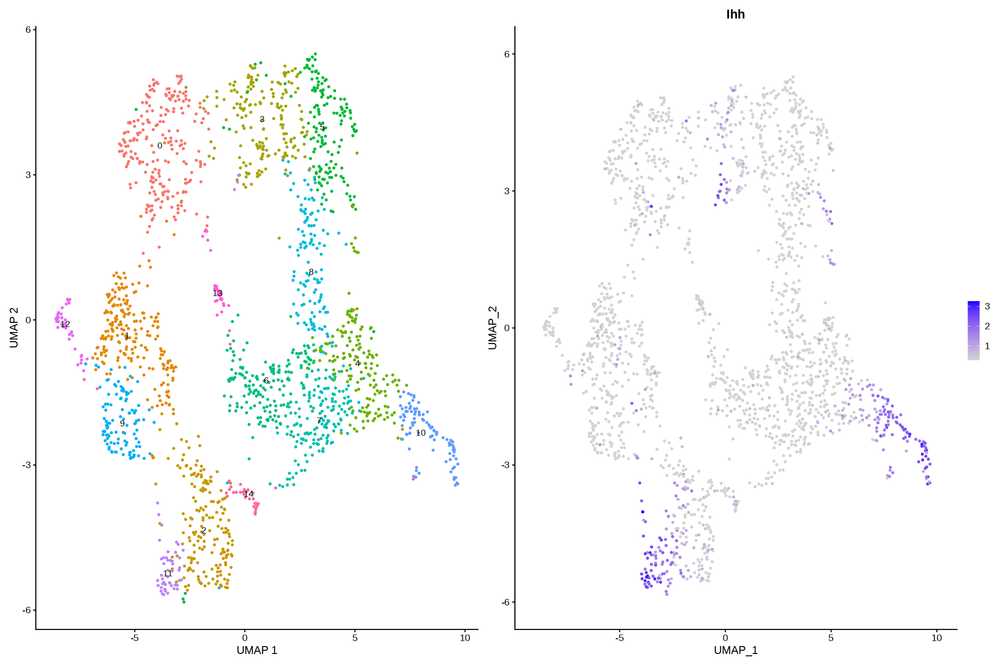

In [163]:
# Pre-hypertrophic chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Ihh"), min.cutoff = "q1")  

p1 + p2

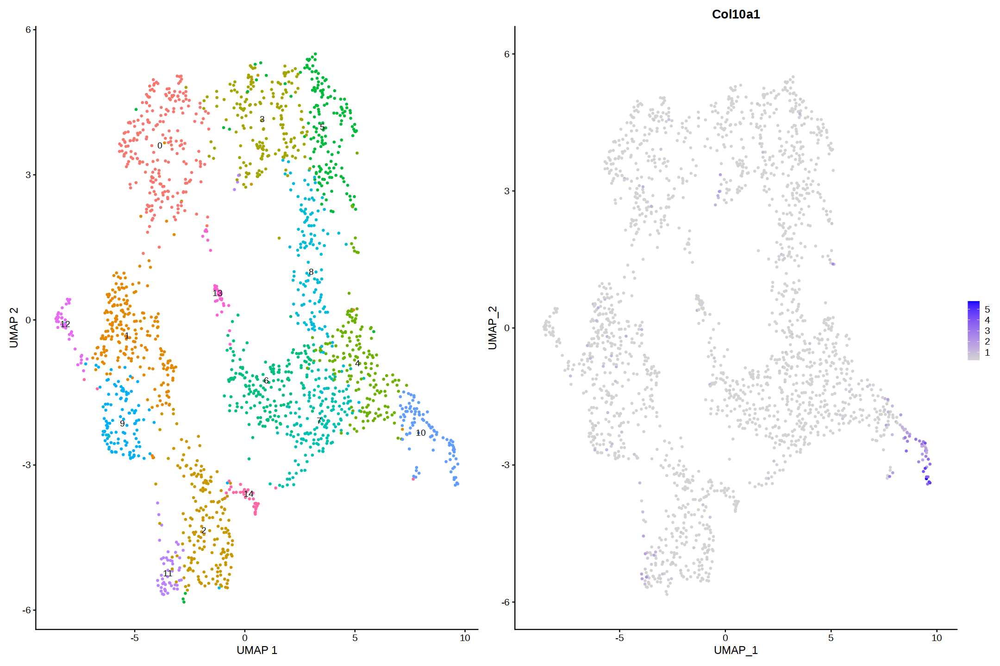

In [169]:
# hypertrophic chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Col10a1"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Adipoq”


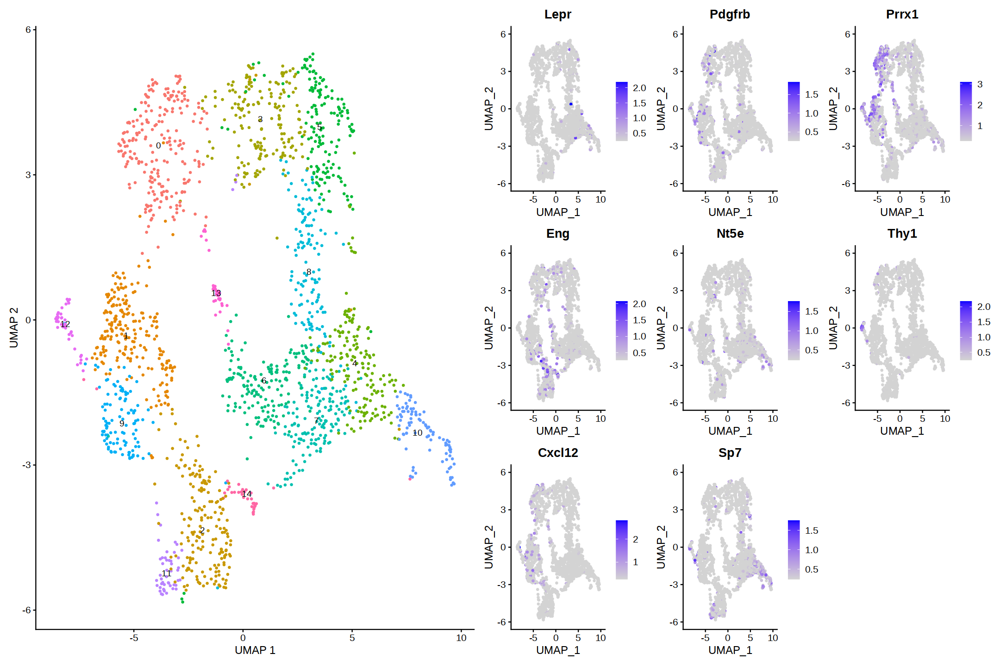

In [165]:
# SSPC
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Lepr","Pdgfrb",'Prrx1',"Eng", "Nt5e", "Thy1","Cxcl12","Sp7","Adipoq"), min.cutoff = "q1") 

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Adipoq”


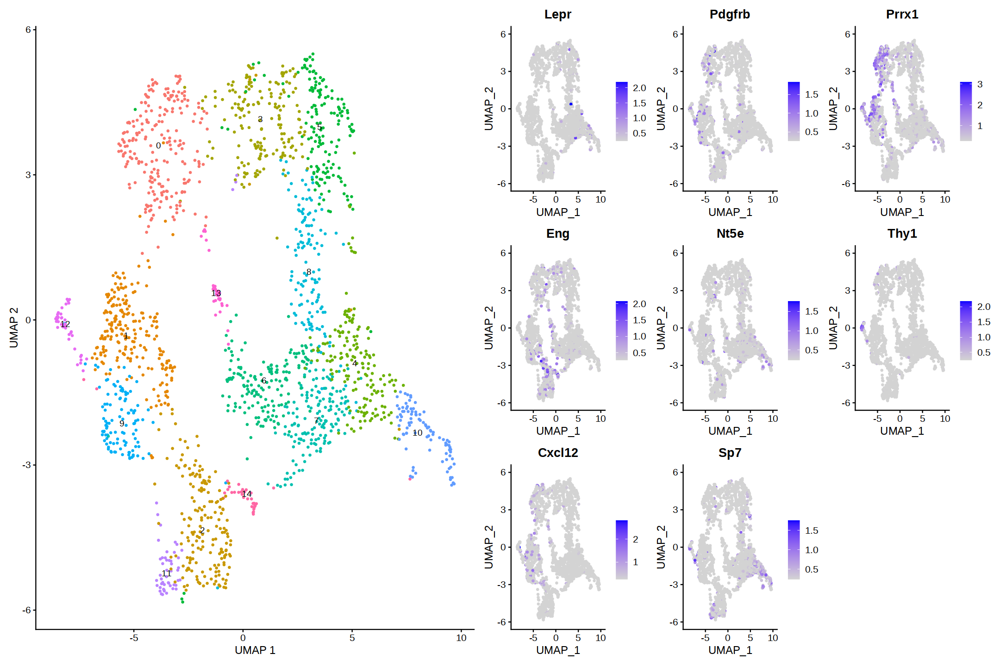

In [165]:
# SSPC
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Lepr","Pdgfrb",'Prrx1',"Eng", "Nt5e", "Thy1","Cxcl12","Sp7","Adipoq"), min.cutoff = "q1") 

p1 + p2

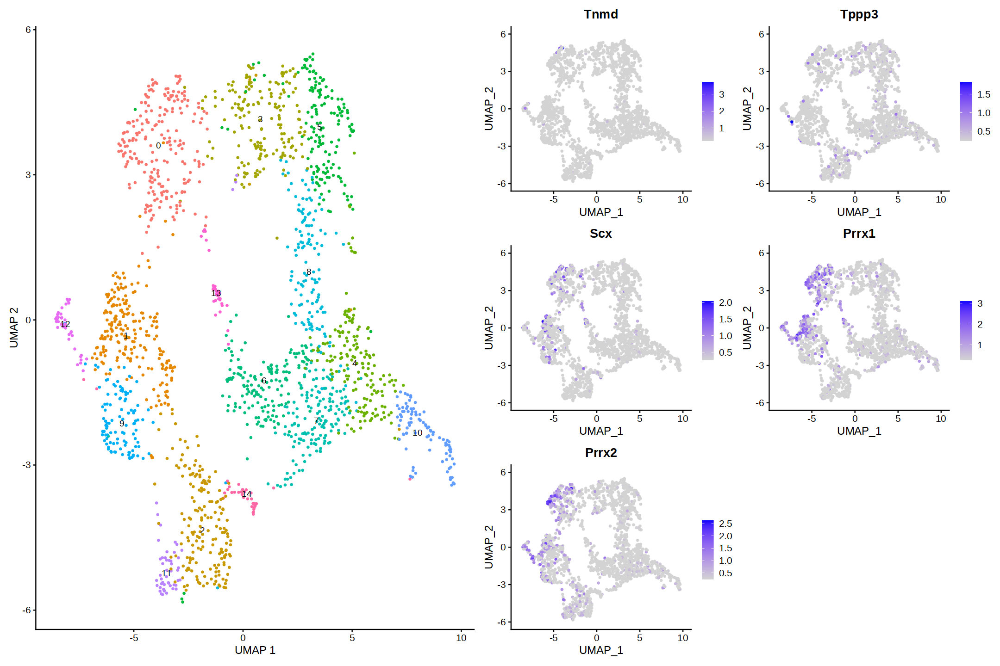

In [248]:
# Tenocyte precursors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Tnmd", "Tppp3", "Scx", "Prrx1", "Prrx2"), min.cutoff = "q1")  

p1 + p2

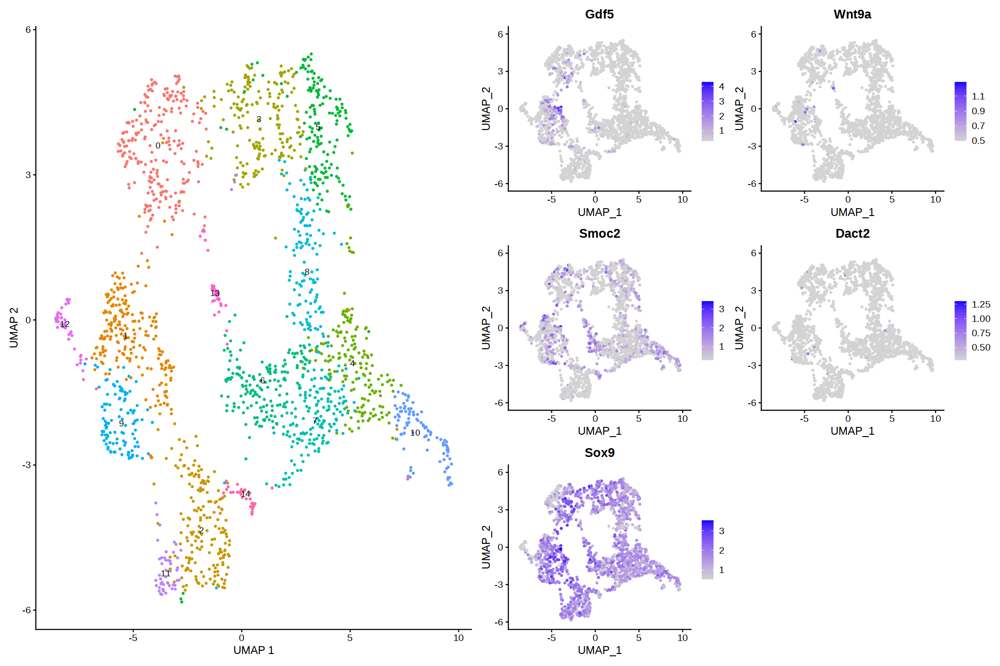

In [249]:
# Tenocyte precursors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Gdf5", "Wnt9a", "Smoc2", "Dact2","Sox9"), min.cutoff = "q1")  

p1 + p2

In [305]:
A_chondrocytes@meta.data$CellType_d <- Idents(A_chondrocytes)

In [306]:
A_chondrocytes@meta.data$CellType_d <- as.character(A_chondrocytes@meta.data$CellType_d)

A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '0'] <- 'Subset'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '1'] <- 'Subset'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '2'] <- 'Proliferative chondrocytes'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '3'] <- 'Proliferative chondrocytes'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '4'] <- 'Proliferative chondrocytes'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '5'] <- 'Proliferative chondrocytes'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '6'] <- 'Proliferative chondrocytes'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '7'] <- 'Proliferative chondrocytes'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '8'] <- 'Proliferative chondrocytes'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '9'] <- 'Resting zone chondrocytes'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '10'] <- 'Subset'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '11'] <- 'Pre-hypertrophic chondrocytes'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '12'] <- 'Subset'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '13'] <- 'Proliferative chondrocytes'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '14'] <- 'Proliferative chondrocytes'

A_chondrocytes@meta.data$CellType_d <- as.factor(A_chondrocytes@meta.data$CellType_d)

In [307]:
Idents(A_chondrocytes) <- A_chondrocytes@meta.data$CellType_d

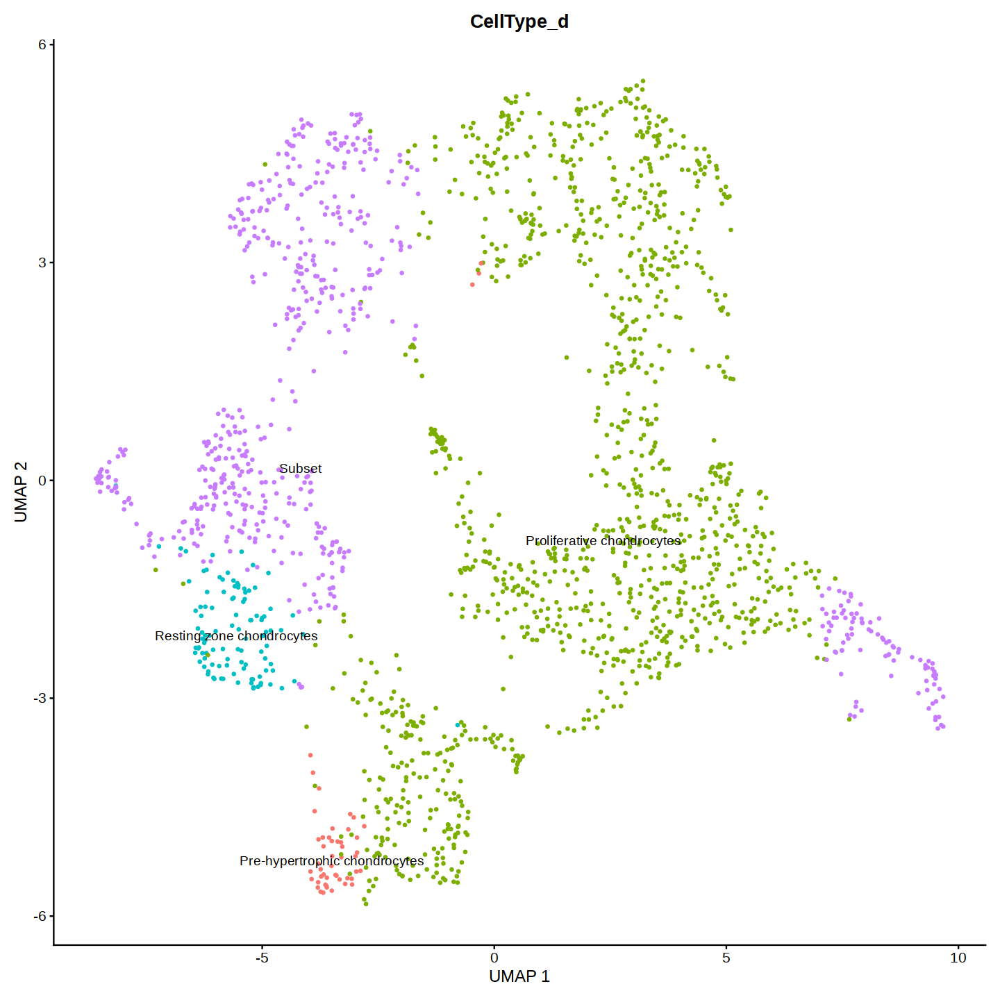

In [308]:
options(repr.plot.width = 12, repr.plot.height = 12)
DimPlot(A_chondrocytes, label = TRUE, group.by="CellType_d") + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

##### 3.4.2.1. Subsetting subset

In [309]:
A_subset <- subset(A_chondrocytes, idents = c("Subset"))

In [310]:
A_subset

An object of class Seurat 
17454 features across 572 samples within 1 assay 
Active assay: RNA (17454 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [311]:
A_subset <- ScaleData(A_subset)

Centering and scaling data matrix



In [312]:
A_subset <- RunPCA(A_subset, features = VariableFeatures(object = A_subset), verbose = FALSE)

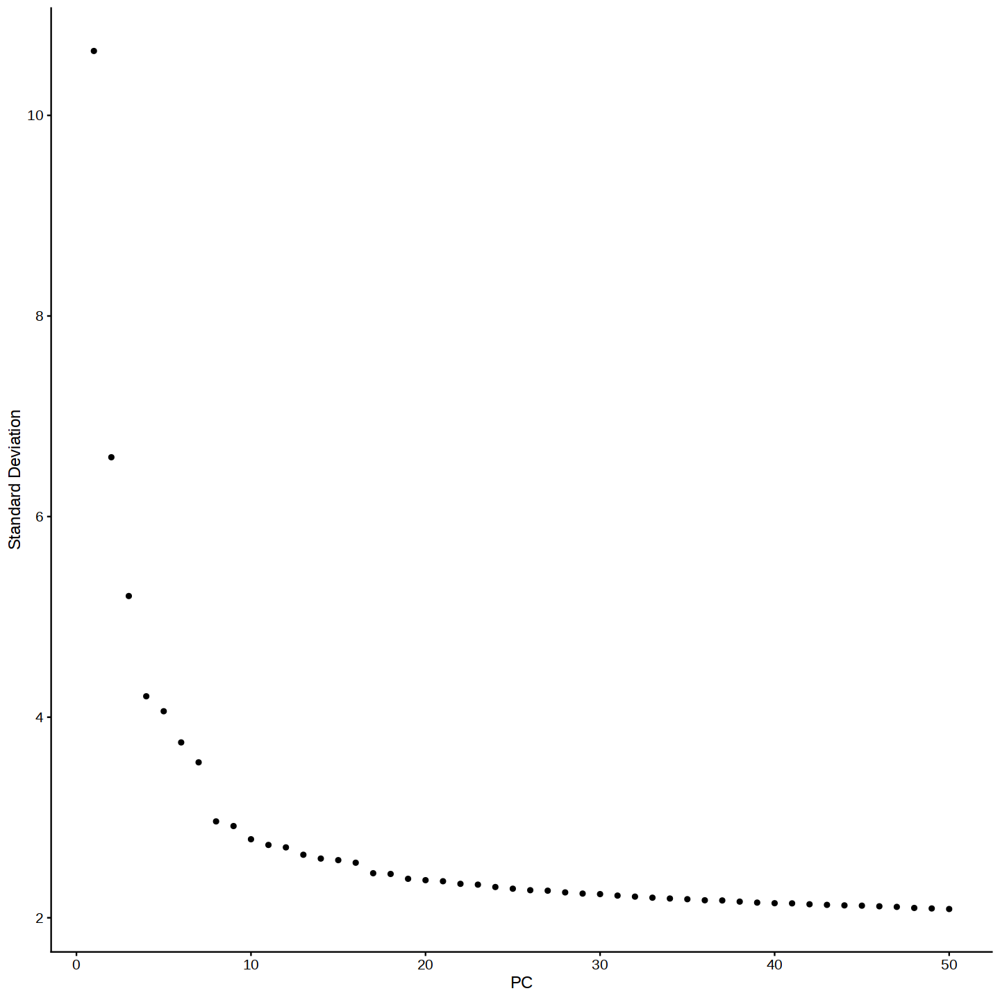

In [313]:
ElbowPlot(A_subset, 50)

In [314]:
A_subset <- FindNeighbors(A_subset, dims = 1:18, verbose = FALSE)
A_subset <- FindClusters(A_subset, resolution = 1.5, verbose = FALSE)

In [315]:
A_subset <- RunUMAP(A_subset, dims = 1:18, n.neighbors = 12, verbose = FALSE)

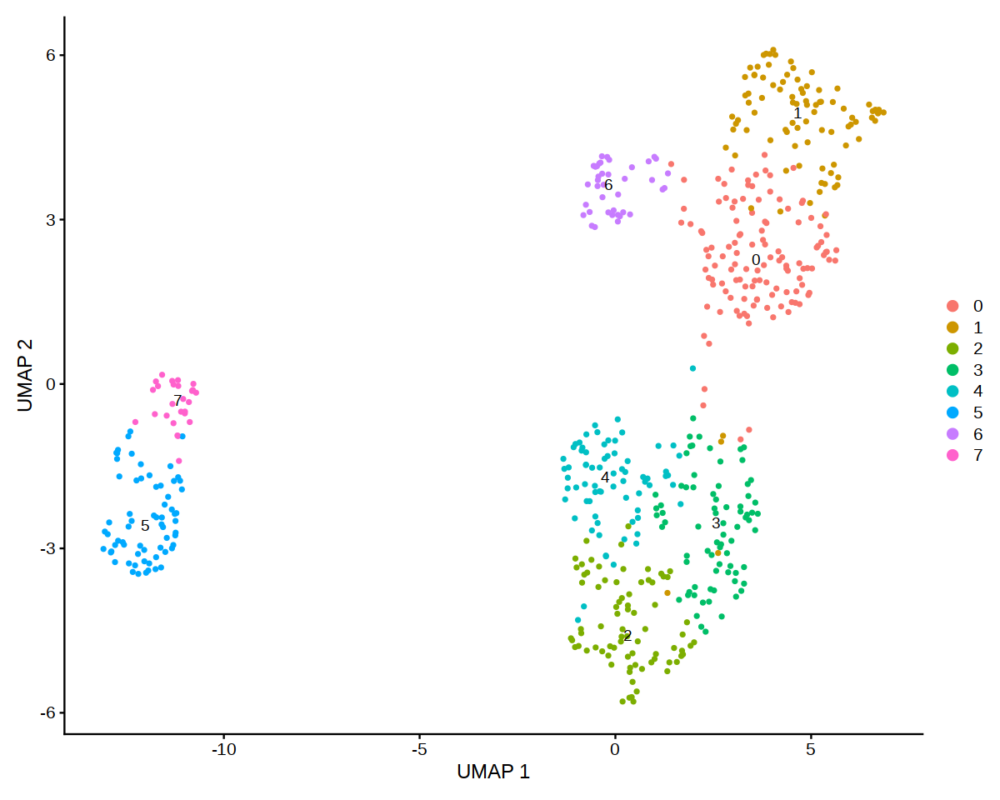

In [316]:
options(repr.plot.width = 10, repr.plot.height = 8)
DimPlot(A_subset, reduction = "umap", label=TRUE) + xlab("UMAP 1") + ylab("UMAP 2")

#ggsave("./6-kmita/images/E10_5_m_no_annotation.png" ,width=10, height=8)

In [171]:
A_chondrocytes_markers <- FindAllMarkers(A_chondrocytes)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14



In [174]:
#select only cluster 0 and order avg_log2FC from big to small

A_chondrocytes_markers[A_chondrocytes_markers$cluster == 4,] %>%
slice_max(n = 15, order_by = avg_log2FC)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Fdps.2,1.959155e-57,1.4522439,0.994,0.710,3.419510e-53,4,Fdps
Msmo1.2,8.982791e-57,1.3682576,0.934,0.441,1.567856e-52,4,Msmo1
3110079O15Rik.3,3.542732e-52,1.2085052,1.000,0.813,6.183485e-48,4,3110079O15Rik
C1qtnf3.3,9.869773e-41,1.1520174,0.988,0.634,1.722670e-36,4,C1qtnf3
Epyc.3,3.249790e-38,1.1321068,0.994,0.643,5.672184e-34,4,Epyc
Mvd.3,2.181159e-63,1.1045263,0.880,0.317,3.806995e-59,4,Mvd
Ppa1.2,2.841841e-34,1.0795151,0.982,0.780,4.960150e-30,4,Ppa1
Scd2.2,1.455827e-46,1.0330290,1.000,0.768,2.541000e-42,4,Scd2
Dhcr7.2,1.755335e-58,1.0213476,0.922,0.399,3.063762e-54,4,Dhcr7


In [102]:
write.csv(A_chondrocytes_markers, file = "A_chondrocytes.markers_e12.5.csv", quote = FALSE)

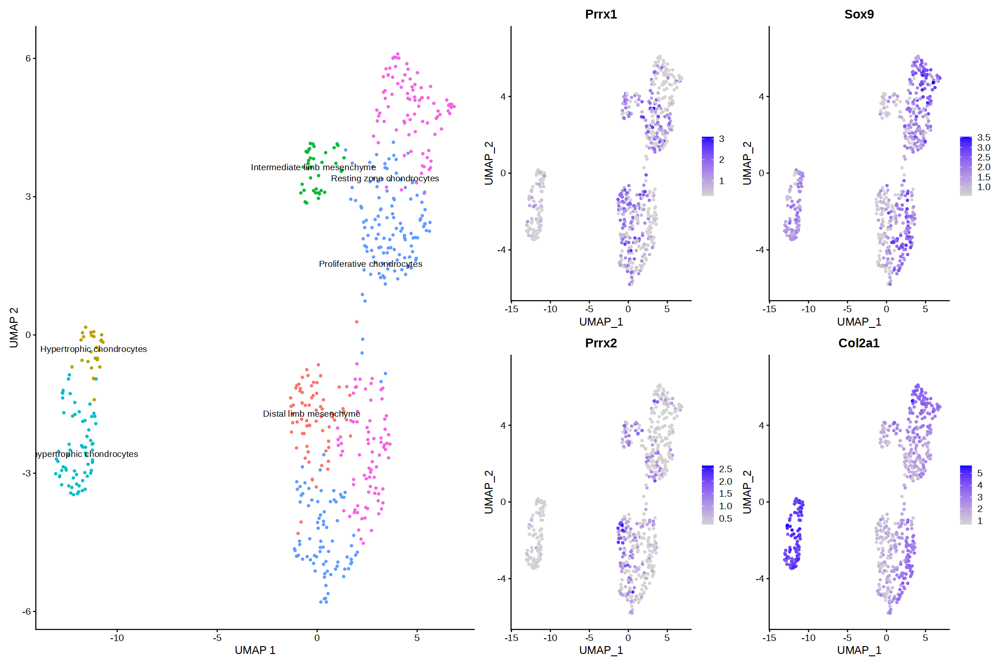

In [330]:
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_subset, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_subset, c("Prrx1", "Sox9","Prrx2","Col2a1"), min.cutoff = "q1")  

p1 + p2

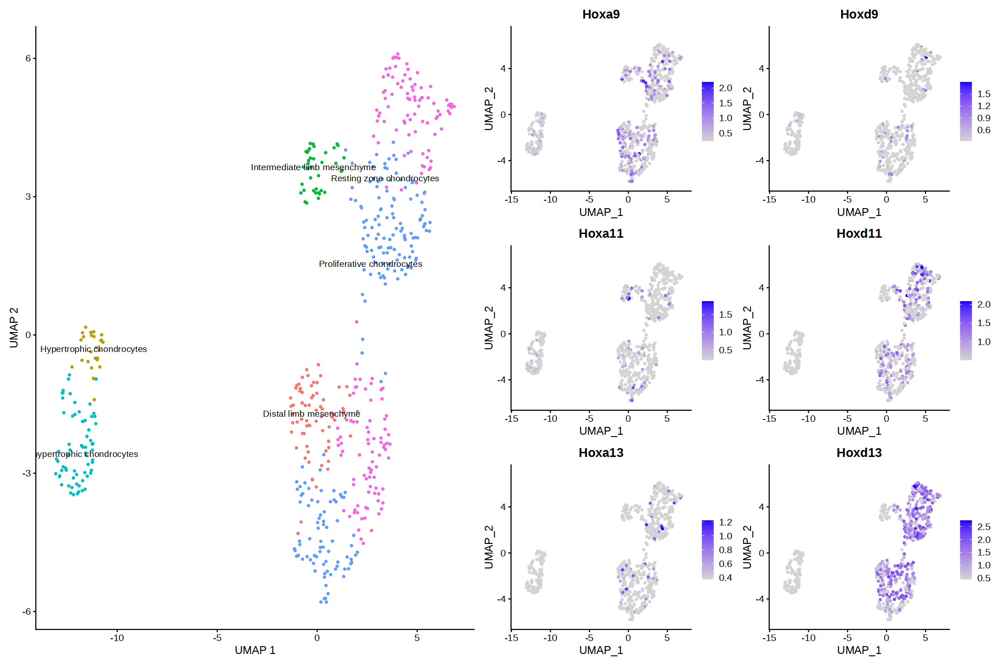

In [331]:
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_subset, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_subset, c("Hoxa9", "Hoxd9","Hoxa11","Hoxd11","Hoxa13","Hoxd13"), min.cutoff = "q1")  

p1 + p2

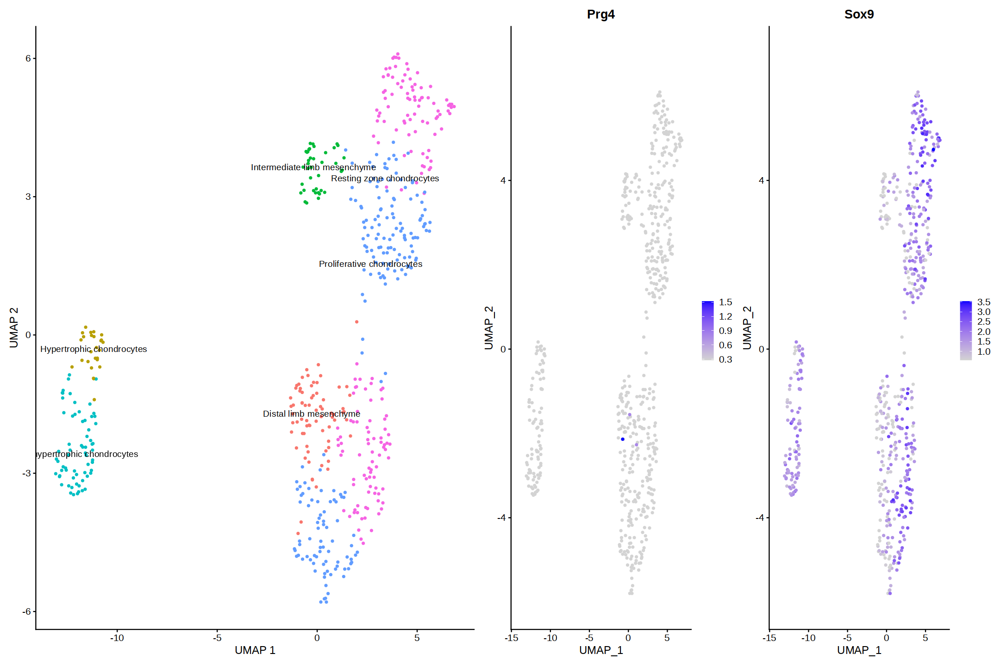

In [332]:
# Articular chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_subset, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_subset, c("Prg4", "Sox9"), min.cutoff = "q1")  

p1 + p2

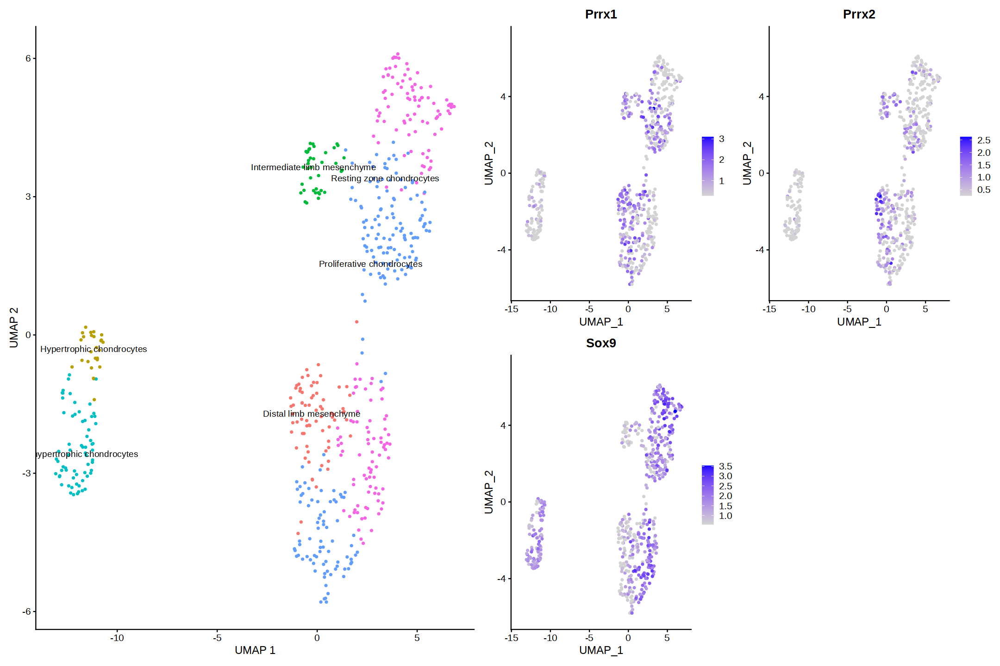

In [333]:
# Chondroprogenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_subset, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_subset, c("Prrx1", "Prrx2", "Sox9"), min.cutoff = "q1")  

p1 + p2

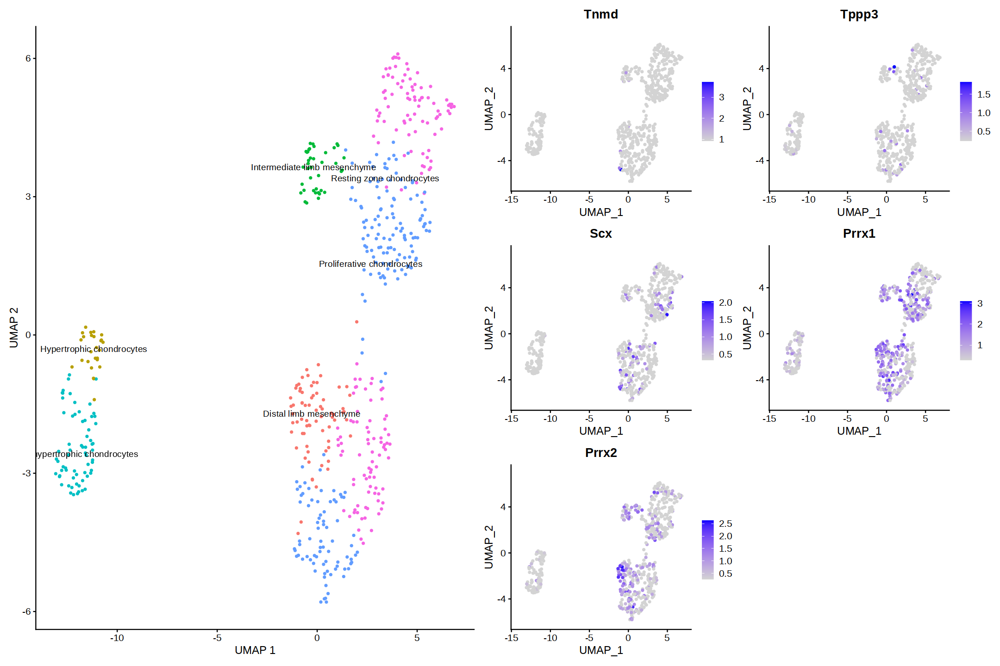

In [334]:
# Tenocyte precursors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_subset, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_subset, c("Tnmd", "Tppp3", "Scx", "Prrx1", "Prrx2"), min.cutoff = "q1")  

p1 + p2

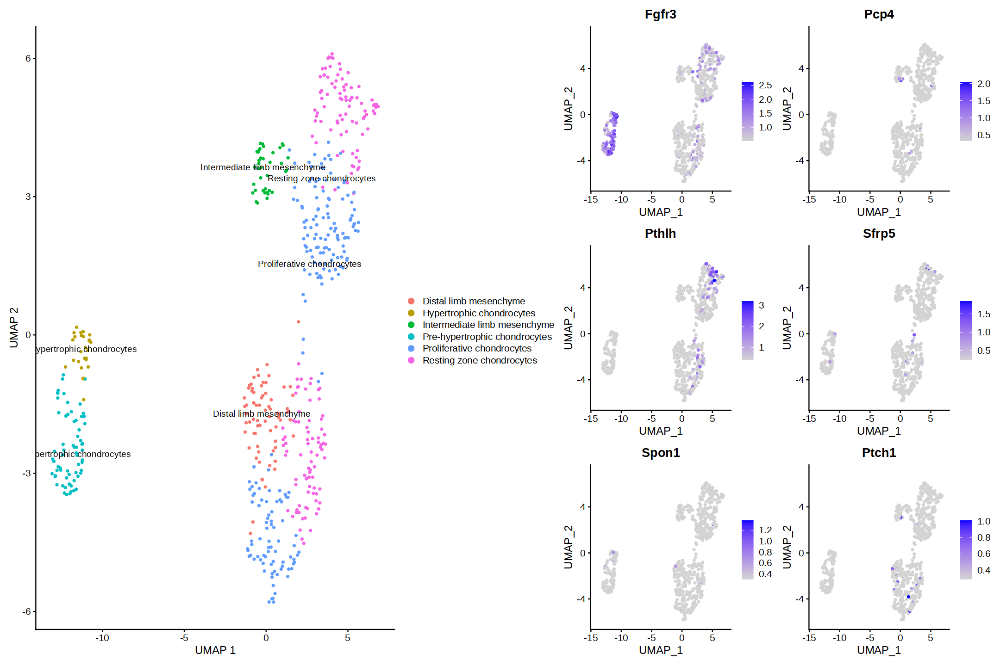

In [340]:
# Resting zone chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_subset, label = TRUE) + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_subset, c("Fgfr3", "Pcp4", "Pthlh", "Sfrp5", "Spon1","Ptch1"), min.cutoff = "q1")  

p1 + p2

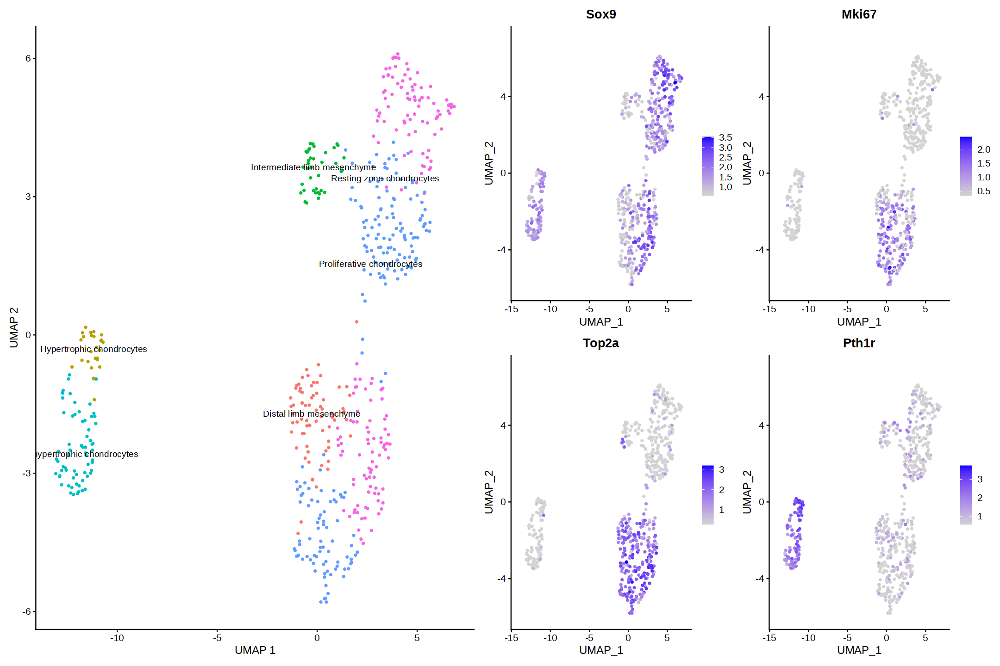

In [336]:
# Proliferative chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_subset, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_subset, c("Sox9", "Mki67", "Top2a", "Pth1r"), min.cutoff = "q1")  

p1 + p2

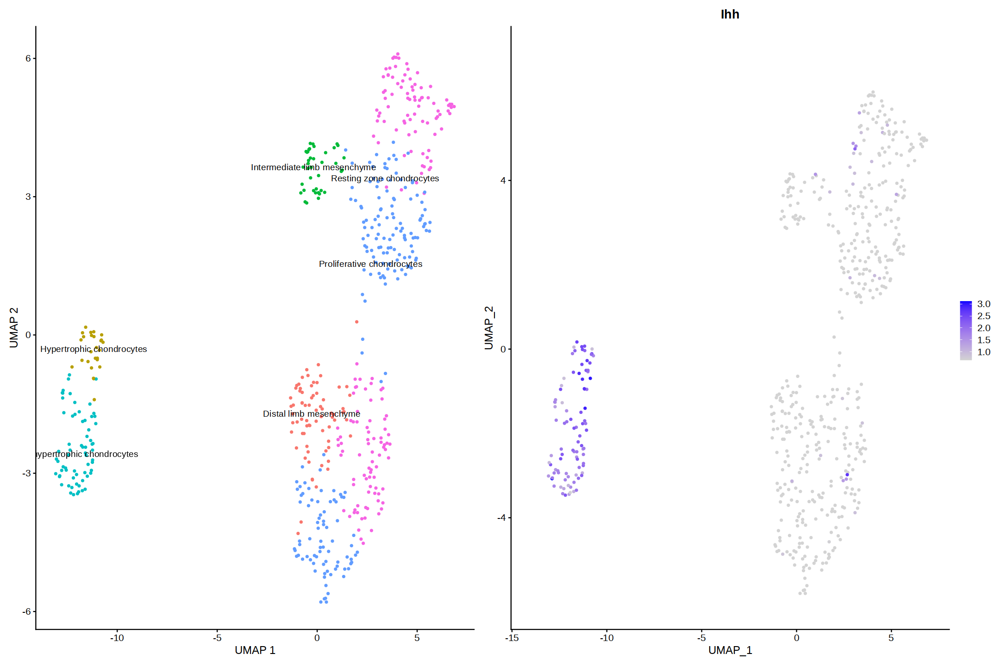

In [337]:
# Pre-hypertrophic chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_subset, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_subset, c("Ihh"), min.cutoff = "q1")  

p1 + p2

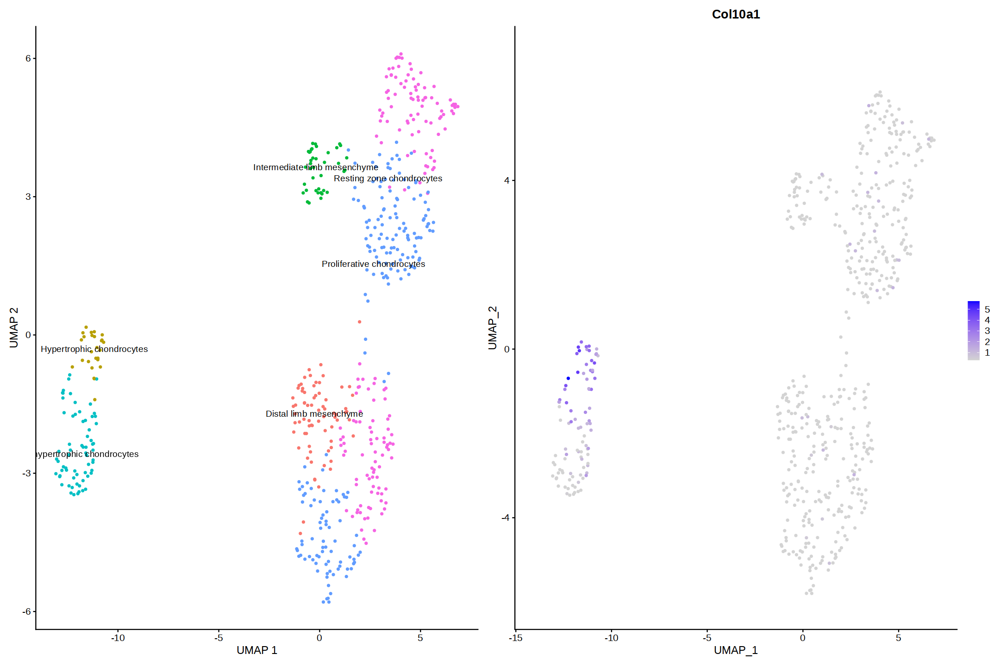

In [338]:
# hypertrophic chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_subset, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_subset, c("Col10a1"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Adipoq”


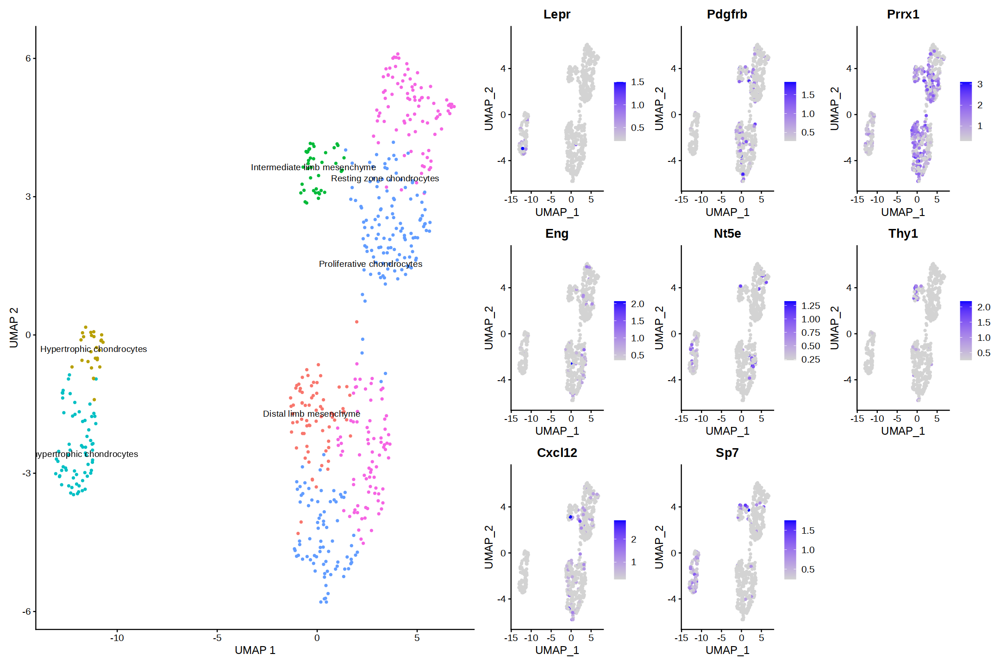

In [339]:
# SSPC
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_subset, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_subset, c("Lepr","Pdgfrb",'Prrx1',"Eng", "Nt5e", "Thy1","Cxcl12","Sp7","Adipoq"), min.cutoff = "q1") 

p1 + p2

In [327]:
A_subset@meta.data$CellType_dd <- Idents(A_subset)

In [328]:
A_subset@meta.data$CellType_dd <- as.character(A_subset@meta.data$CellType_dd)

A_subset@meta.data$CellType_dd[A_subset@meta.data$CellType_dd == '0'] <- 'Proliferative chondrocytes'
A_subset@meta.data$CellType_dd[A_subset@meta.data$CellType_dd == '1'] <- 'Resting zone chondrocytes'
A_subset@meta.data$CellType_dd[A_subset@meta.data$CellType_dd == '2'] <- 'Proliferative chondrocytes'
A_subset@meta.data$CellType_dd[A_subset@meta.data$CellType_dd == '3'] <- 'Resting zone chondrocytes'
A_subset@meta.data$CellType_dd[A_subset@meta.data$CellType_dd == '4'] <- 'Distal limb mesenchyme'
A_subset@meta.data$CellType_dd[A_subset@meta.data$CellType_dd == '5'] <- 'Pre-hypertrophic chondrocytes'
A_subset@meta.data$CellType_dd[A_subset@meta.data$CellType_dd == '6'] <- 'Intermediate limb mesenchyme'
A_subset@meta.data$CellType_dd[A_subset@meta.data$CellType_dd == '7'] <- 'Hypertrophic chondrocytes'

A_subset@meta.data$CellType_dd <- as.factor(A_subset@meta.data$CellType_dd)

In [329]:
Idents(A_subset) <- A_subset@meta.data$CellType_dd

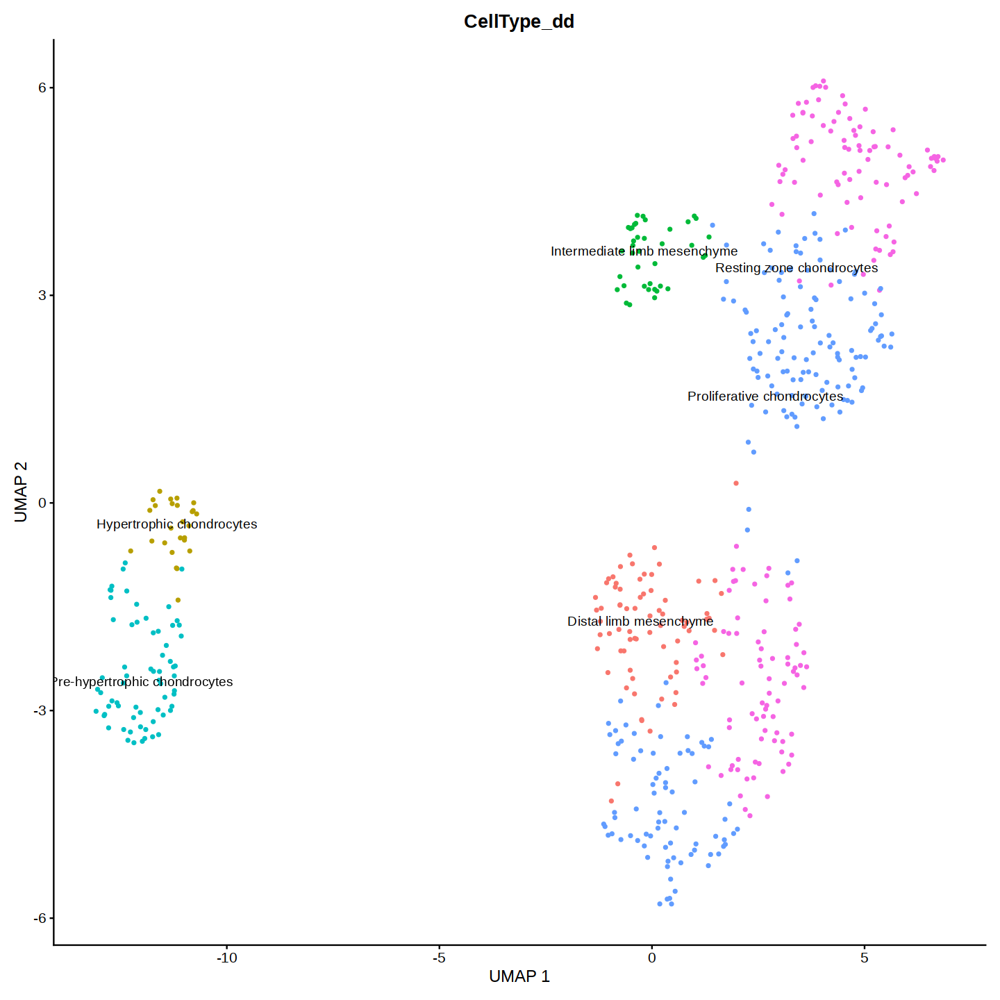

In [341]:
options(repr.plot.width = 12, repr.plot.height = 12)
DimPlot(A_subset, label = TRUE, group.by="CellType_dd") + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

Adding metadata

In [342]:
meta1 <- A_chondrocytes@meta.data
meta2 <- A_subset@meta.data

In [343]:
df <- split(meta1, meta1$CellType_d)

In [344]:
names(df)

[1] "Pre-hypertrophic chondrocytes" "Proliferative chondrocytes"   
[3] "Resting zone chondrocytes"     "Subset"

In [345]:
sub <- rownames(df$Subset)

In [346]:
sub_meta <- meta2[sub, c("CellType_dd","Author")]
sub_meta$Author<- NULL

head(sub_meta)

,CellType_dd
,<fct>
AAACCTGGTTATCGGT-1,Proliferative chondrocytes
AAACGGGTCACATGCA-1,Distal limb mesenchyme
AAACGGGTCCGCTGTT-1,Proliferative chondrocytes
AAACGGGTCTCCAACC-1,Distal limb mesenchyme
AAACGGGTCTGTCAAG-1,Proliferative chondrocytes
AAAGATGAGAGCTGGT-1,Proliferative chondrocytes


In [347]:
df$Subset <- cbind(df$Subset, sub_meta)
df$Subset$CellType_d <- df$Subset$CellType_dd
df$Subset$CellType_dd <- NULL

In [348]:
names(df)

[1] "Pre-hypertrophic chondrocytes" "Proliferative chondrocytes"   
[3] "Resting zone chondrocytes"     "Subset"

In [349]:
df$'Pre-hypertrophic chondrocytes'$Barcode = rownames(df$'Pre-hypertrophic chondrocytes')
df$'Proliferative chondrocytes'$Barcode = rownames(df$'Proliferative chondrocytes')
df$"Resting zone chondrocytes"$Barcode = rownames(df$"Resting zone chondrocytes")
df$Subset$Barcode = rownames(df$Subset)

In [350]:
str(df)

List of 4
 $ Pre-hypertrophic chondrocytes:'data.frame':	50 obs. of  27 variables:
  ..$ orig.ident           : Factor w/ 1 level "SeuratProject": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ nCount_RNA           : num [1:50] 13664 7587 11679 8854 22215 ...
  ..$ nFeature_RNA         : int [1:50] 3321 2605 3137 2883 4700 4145 3951 1709 3950 2457 ...
  ..$ geo_accession        : Factor w/ 4 levels "GSM4227224","GSM4227225",..: 2 2 2 2 2 2 2 2 2 2 ...
  ..$ tissue               : Factor w/ 1 level "hindlimb": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ organism             : Factor w/ 1 level "Mus musculus": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ strain               : Factor w/ 1 level "strain: C57BL/6": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ developmental_stage  : Factor w/ 4 levels "developmental stage: embryonic day 11.5",..: 2 2 2 2 2 2 2 2 2 2 ...
  ..$ instrument_model     : Factor w/ 1 level "Illumina NovaSeq 6000": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ technology           : chr [1:50] "10x 3' v2" "10x 3' v2" "10x 3' v2" "10x 3' v2"

In [351]:
df$'Pre-hypertrophic chondrocytes'$Barcode <- rownames(df$'Pre-hypertrophic chondrocytes')
df$'Proliferative chondrocytes'$Barcode <- rownames(df$'Proliferative chondrocytes')
df$"Resting zone chondrocytes"$Barcode <- rownames(df$"Resting zone chondrocytes")
df$Subset$Barcode <- rownames(df$Subset)

In [352]:
meta.data <- do.call(rbind, df)
rownames(meta.data) = meta.data$Barcode
meta.data$Barcode <- NULL

In [353]:
dim(A_chondrocytes@meta.data)
dim(meta.data)

[1] 1948   26

[1] 1948   26

In [354]:
target <- rownames(A_chondrocytes@meta.data)
meta.data <- meta.data[match(target, rownames(meta.data)),]

In [355]:
A_chondrocytes@meta.data = meta.data

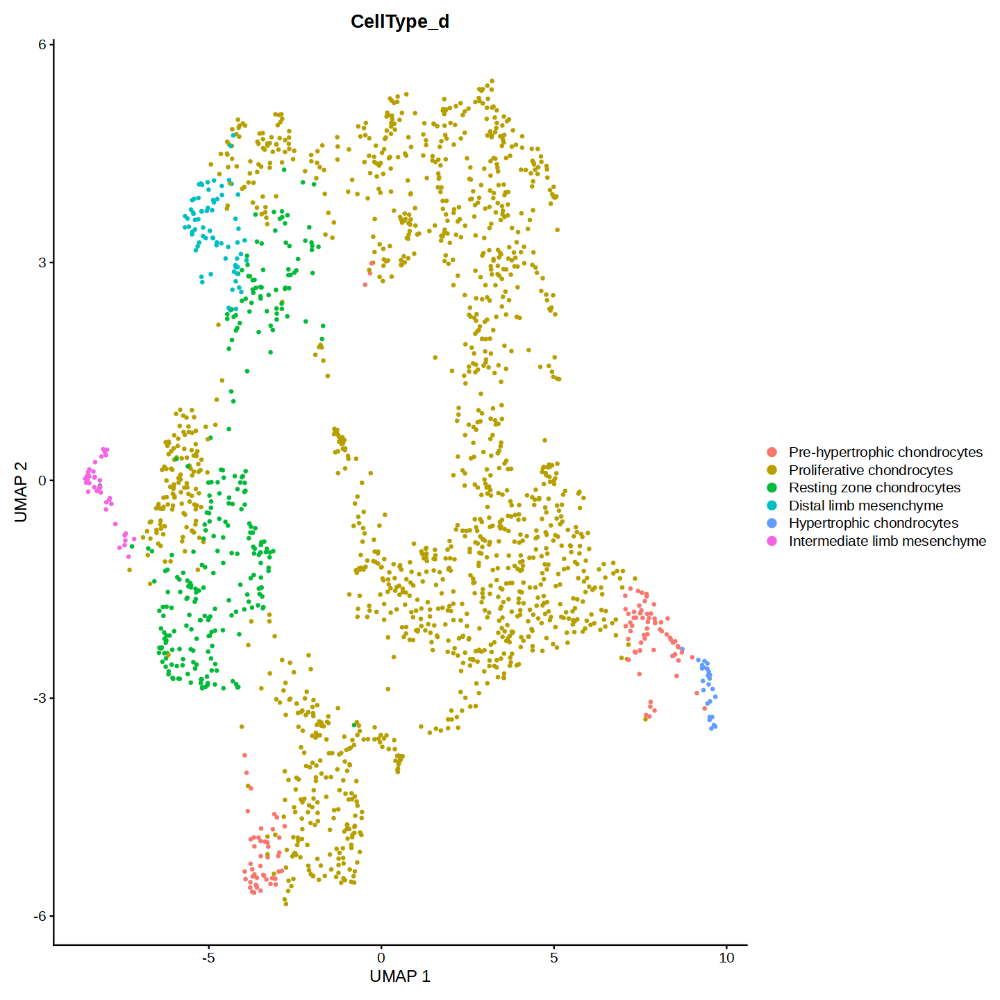

In [356]:
options(repr.plot.width=12)
DimPlot(A_chondrocytes, group.by = "CellType_d", label = FALSE, repel = TRUE) + xlab("UMAP 1") + ylab("UMAP 2")

#ggsave("./6-kmita/images/E10_5_annotated.png" ,width=12, height=8)

In [357]:
Idents(A_chondrocytes) <- A_chondrocytes$CellType_d

##### 3.4.2.1. Subsetting Mesenchyme

In [358]:
A_mesenchyme <- subset(A, idents = c("Mysenchyme"))

In [359]:
A_mesenchyme

An object of class Seurat 
17454 features across 344 samples within 1 assay 
Active assay: RNA (17454 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [360]:
A_mesenchyme <- ScaleData(A_mesenchyme)

Centering and scaling data matrix



In [361]:
A_mesenchyme <- RunPCA(A_mesenchyme, features = VariableFeatures(object = A_mesenchyme), verbose = FALSE)

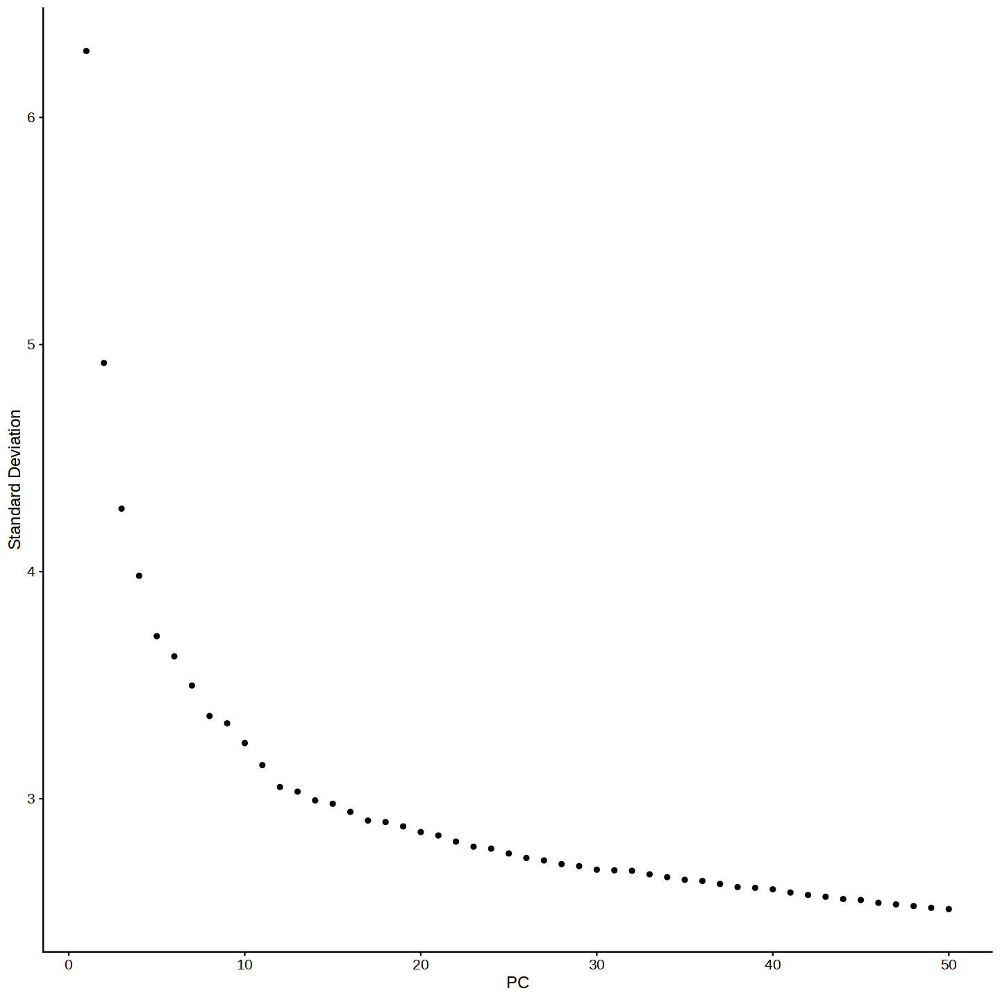

In [362]:
ElbowPlot(A_mesenchyme, 50)

In [363]:
A_mesenchyme <- FindNeighbors(A_mesenchyme, dims = 1:15, verbose = FALSE)
A_mesenchyme <- FindClusters(A_mesenchyme, resolution = 0.5, verbose = FALSE)

In [364]:
A_mesenchyme <- RunUMAP(A_mesenchyme, dims = 1:15, n.neighbors = 12, verbose = FALSE)

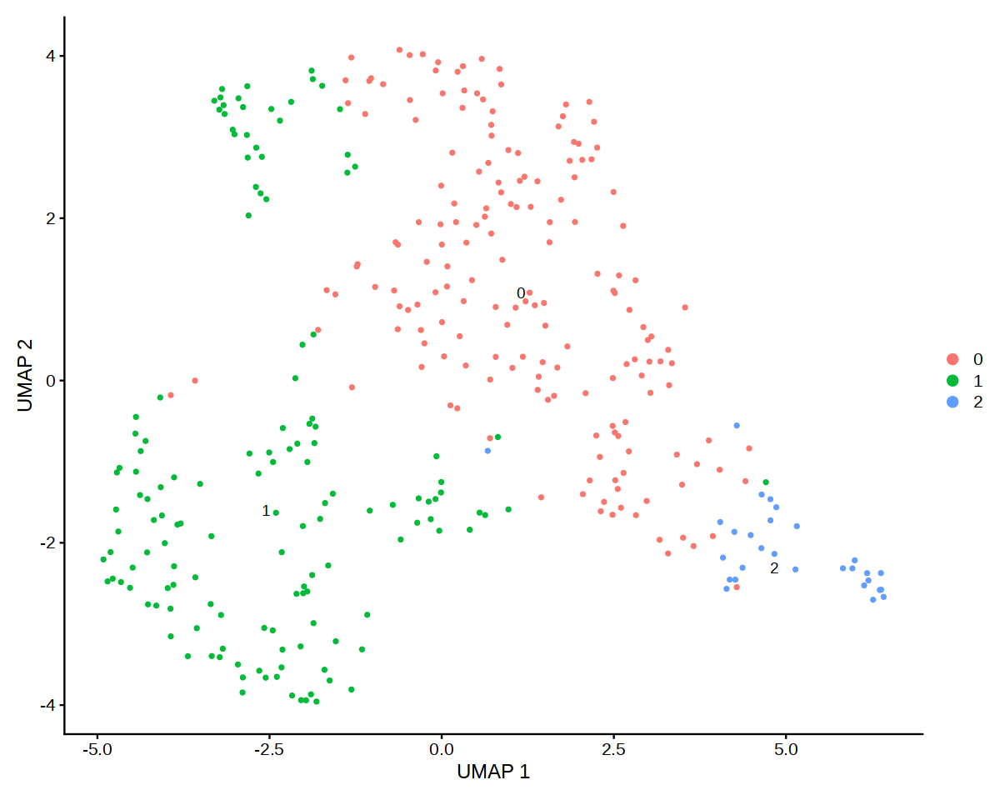

In [365]:
options(repr.plot.width = 10, repr.plot.height = 8)
DimPlot(A_mesenchyme, reduction = "umap", label=TRUE) + xlab("UMAP 1") + ylab("UMAP 2")

#ggsave("./6-kmita/images/E10_5_m_no_annotation.png" ,width=10, height=8)

In [65]:
A_mesenchyme.markers <- FindAllMarkers(A_mesenchyme)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9



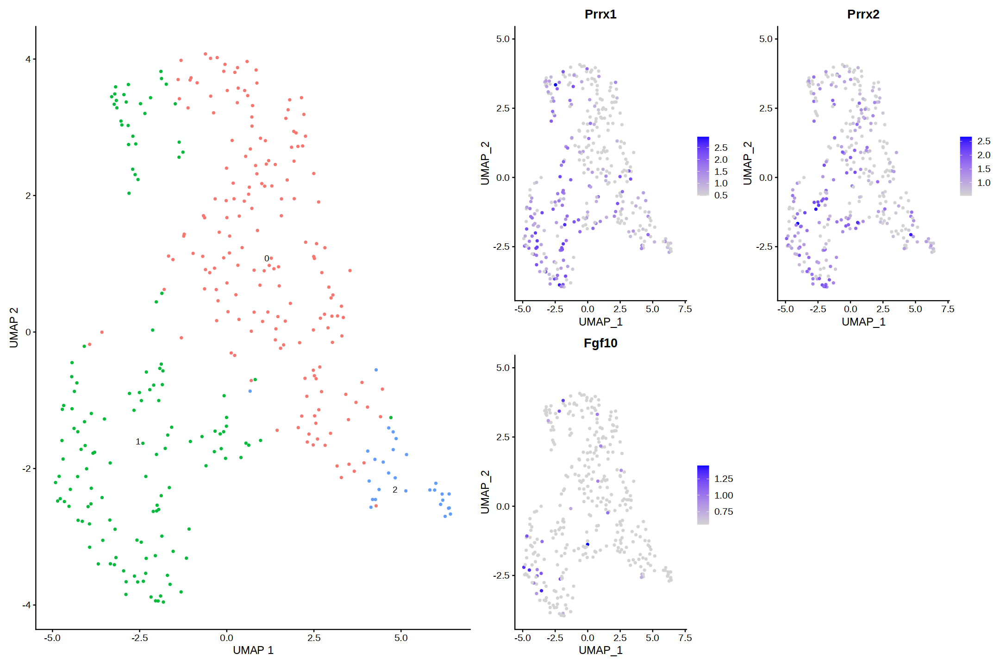

In [230]:
# Skeletal muscle cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_mesenchyme, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_mesenchyme, c("Prrx1", "Prrx2", "Fgf10"), min.cutoff = "q1")  

p1 + p2

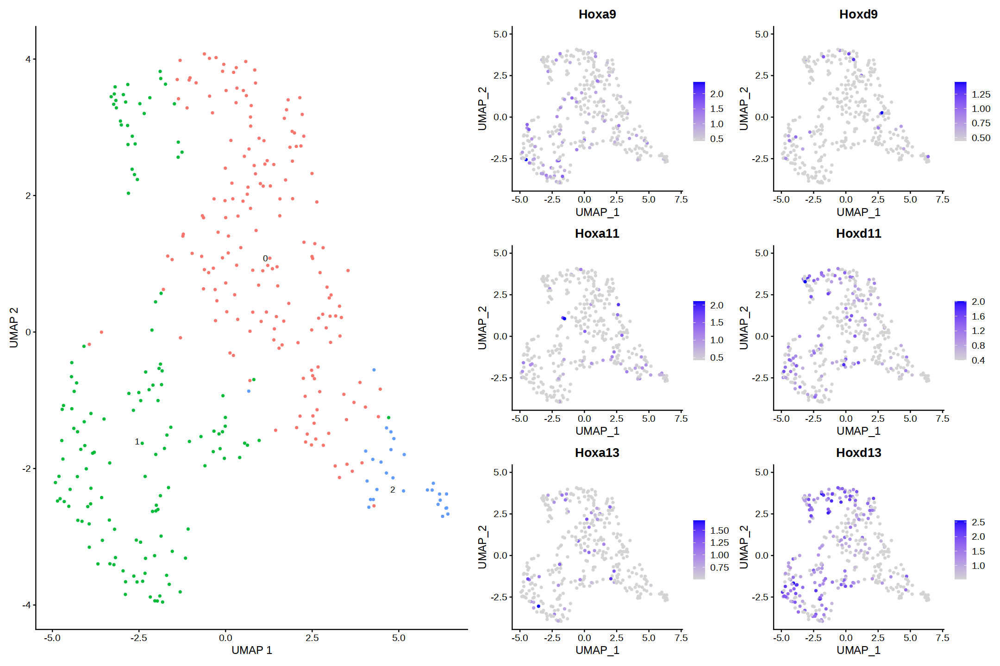

In [232]:
# Smooth muscle cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_mesenchyme, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_mesenchyme, c("Hoxa9", "Hoxd9", "Hoxa11", "Hoxd11", "Hoxa13", "Hoxd13"), min.cutoff = "q1")  

p1 + p2

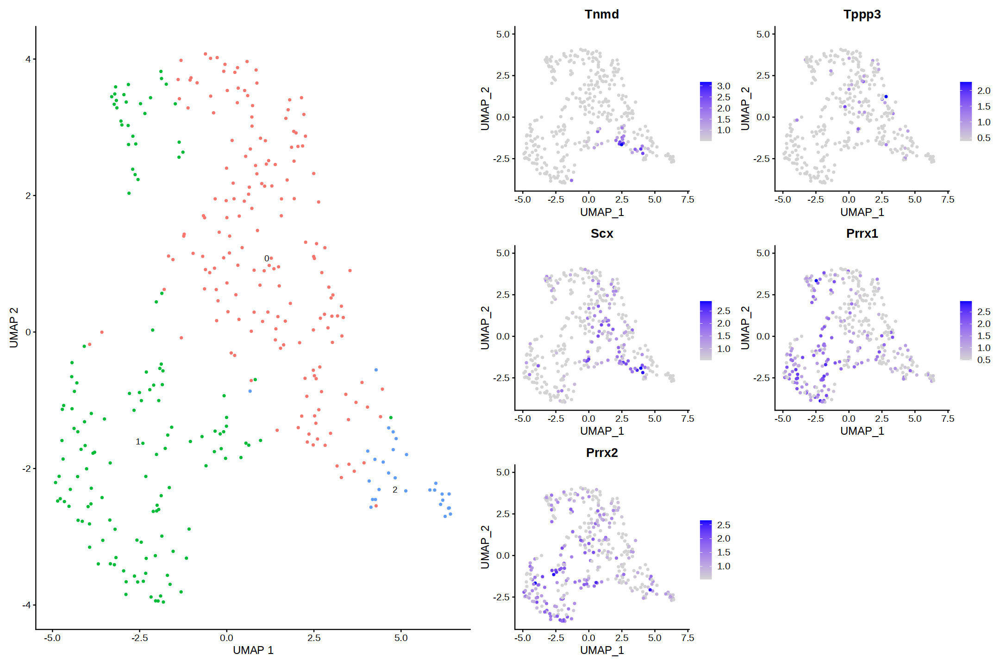

In [257]:
# Tenocyte
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_mesenchyme, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_mesenchyme, c("Tnmd", "Tppp3", "Scx", "Prrx1", "Prrx2"), min.cutoff = "q1")  

p1 + p2

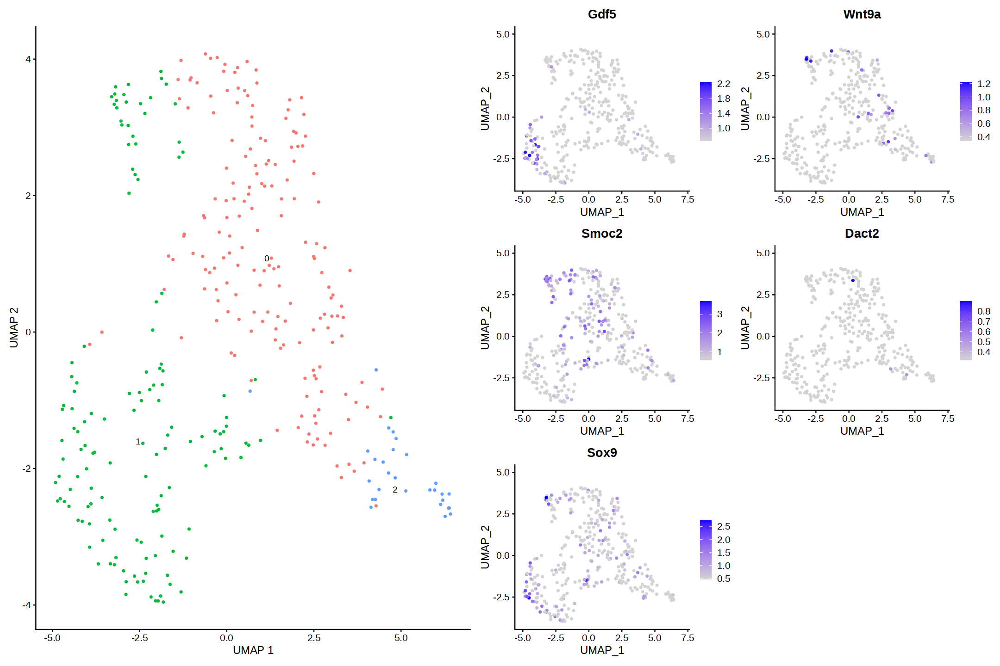

In [235]:
# Tenocyte precursors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_mesenchyme, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_mesenchyme, c("Gdf5", "Wnt9a", "Smoc2", "Dact2","Sox9"), min.cutoff = "q1")  

p1 + p2

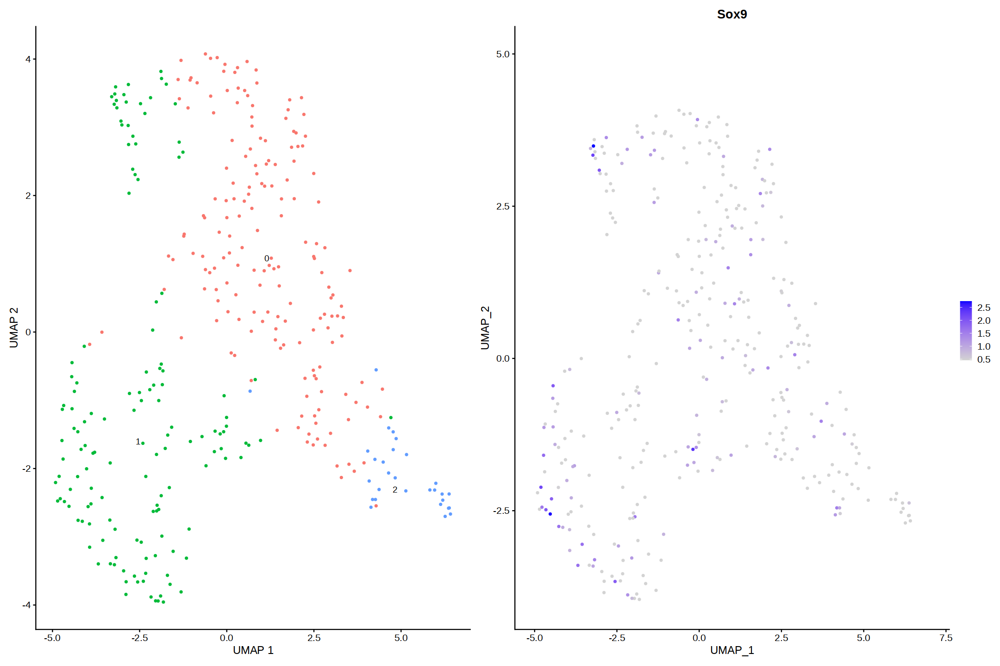

In [233]:
# Smooth muscle cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_mesenchyme, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_mesenchyme, c("Sox9"), min.cutoff = "q1")  

p1 + p2

In [366]:
A_mesenchyme@meta.data$CellType_d <- Idents(A_mesenchyme)

In [367]:
A_mesenchyme@meta.data$CellType_d <- as.character(A_mesenchyme@meta.data$CellType_d)

A_mesenchyme@meta.data$CellType_d[A_mesenchyme@meta.data$CellType_d == '0'] <- 'Tenocytes'
A_mesenchyme@meta.data$CellType_d[A_mesenchyme@meta.data$CellType_d == '1'] <- 'Distal limb mesenchyme'
A_mesenchyme@meta.data$CellType_d[A_mesenchyme@meta.data$CellType_d == '2'] <- 'Tenocytes'

A_mesenchyme@meta.data$CellType_d <- as.factor(A_mesenchyme@meta.data$CellType_d)

#### 3.4.2. Refinement of global annotations<a id="13.2"></a>
##### 3.4.2.1. Subsetting endothelial clusters<a id="14"></a>

In [368]:
A_myocyte <- subset(A, idents = c("Myocyte"))

In [369]:
A_myocyte

An object of class Seurat 
17454 features across 68 samples within 1 assay 
Active assay: RNA (17454 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [370]:
A_myocyte <- ScaleData(A_myocyte)

Centering and scaling data matrix



In [371]:
A_myocyte <- RunPCA(A_myocyte, features = VariableFeatures(object = A_myocyte), verbose = FALSE)

Warning message in irlba(A = t(x = object), nv = npcs, ...):
“You're computing too large a percentage of total singular values, use a standard svd instead.”


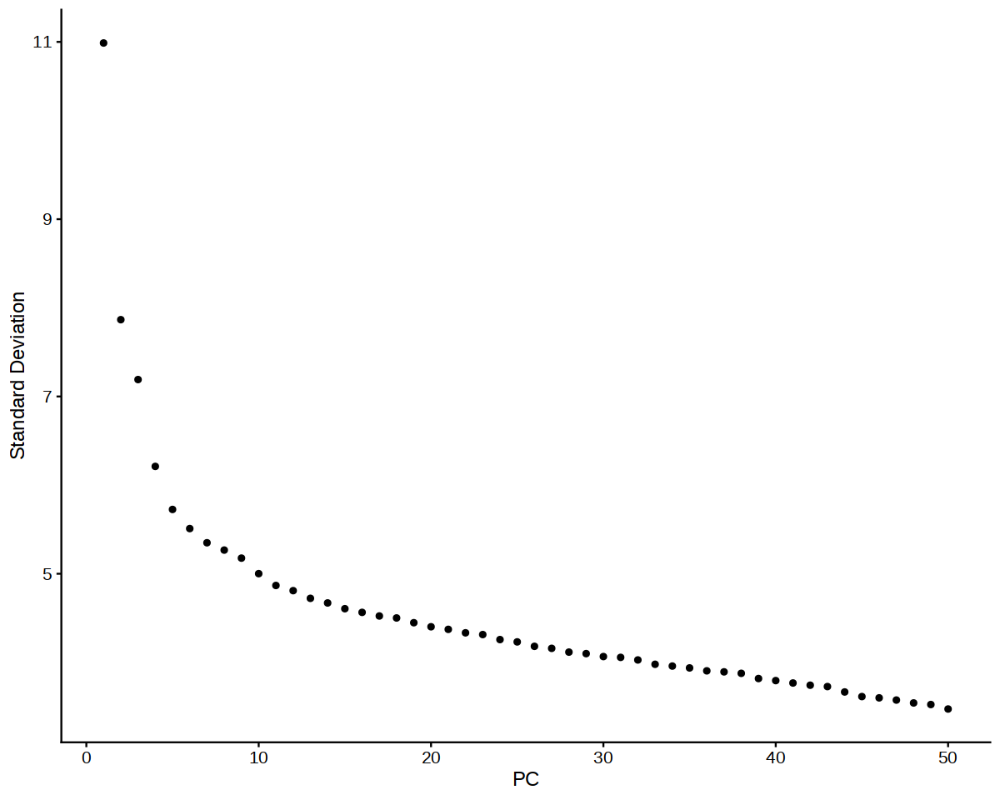

In [372]:
ElbowPlot(A_myocyte, 50)

In [373]:
A_myocyte <- FindNeighbors(A_myocyte, dims = 1:20, verbose = FALSE)
A_myocyte <- FindClusters(A_myocyte, resolution = 1, verbose = FALSE)

In [374]:
A_myocyte <- RunUMAP(A_myocyte, dims = 1:20, n.neighbors = 12, verbose = FALSE)

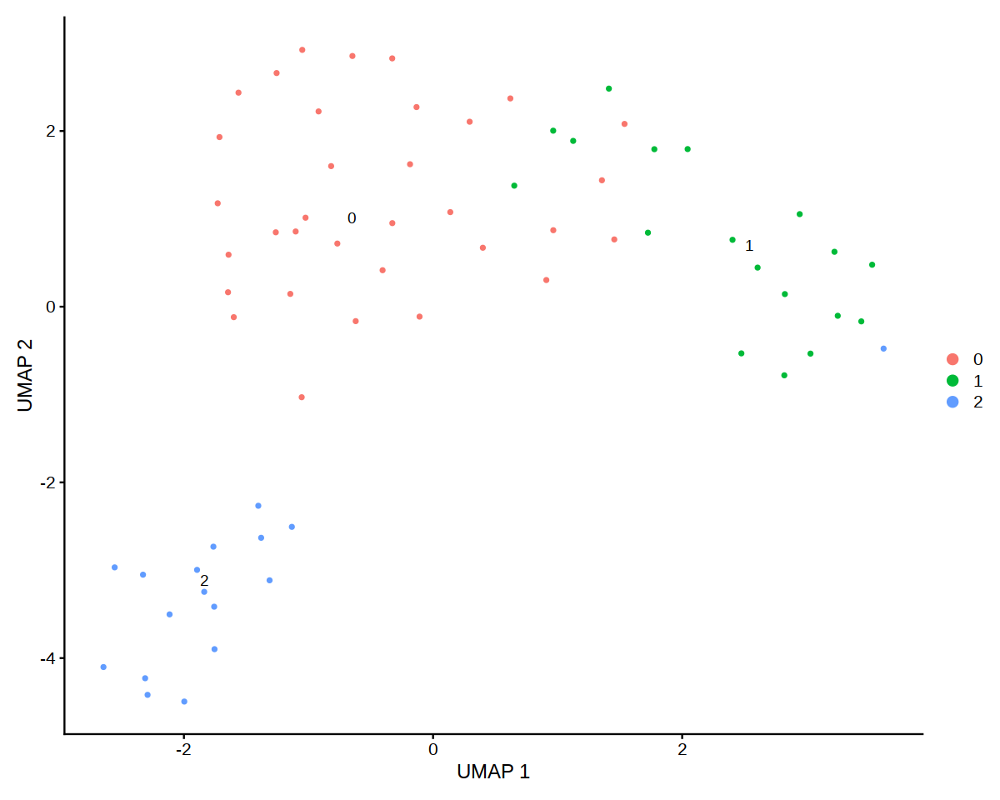

In [375]:
options(repr.plot.width = 10, repr.plot.height = 8)
DimPlot(A_myocyte, reduction = "umap", label=TRUE) + xlab("UMAP 1") + ylab("UMAP 2")

#ggsave("./6-kmita/images/E10_5_m_no_annotation.png" ,width=10, height=8)

In [65]:
A_mesenchyme.markers <- FindAllMarkers(A_myocyte)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9



In [66]:
write.csv(A_myocyte.markers, file = "A_mesenchyme.markers.csv", quote = FALSE)

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Myhc, Mrf4”


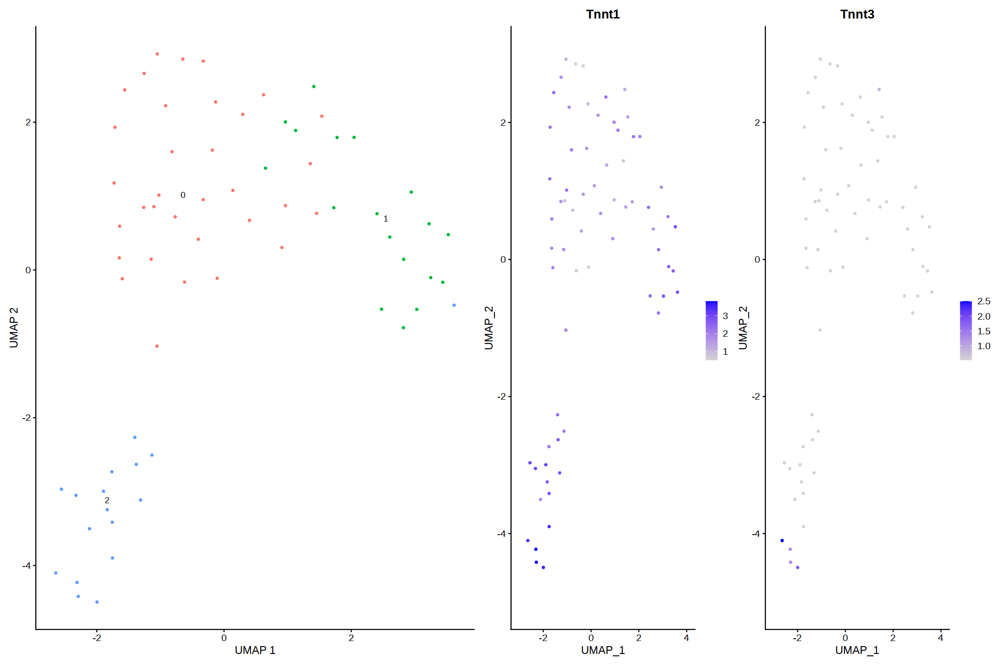

In [297]:
#Skeletal muscle cells

options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_myocyte, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_myocyte, c("Myhc", "Mrf4", 'Tnnt1','Tnnt3'), min.cutoff = "q1")  

p1 + p2

Warning message in FeaturePlot(A_myocyte, c("Acta2", "Myl9", "Myh11"), min.cutoff = "q1"):
“All cells have the same value (0.531659710668833) of Myh11.”


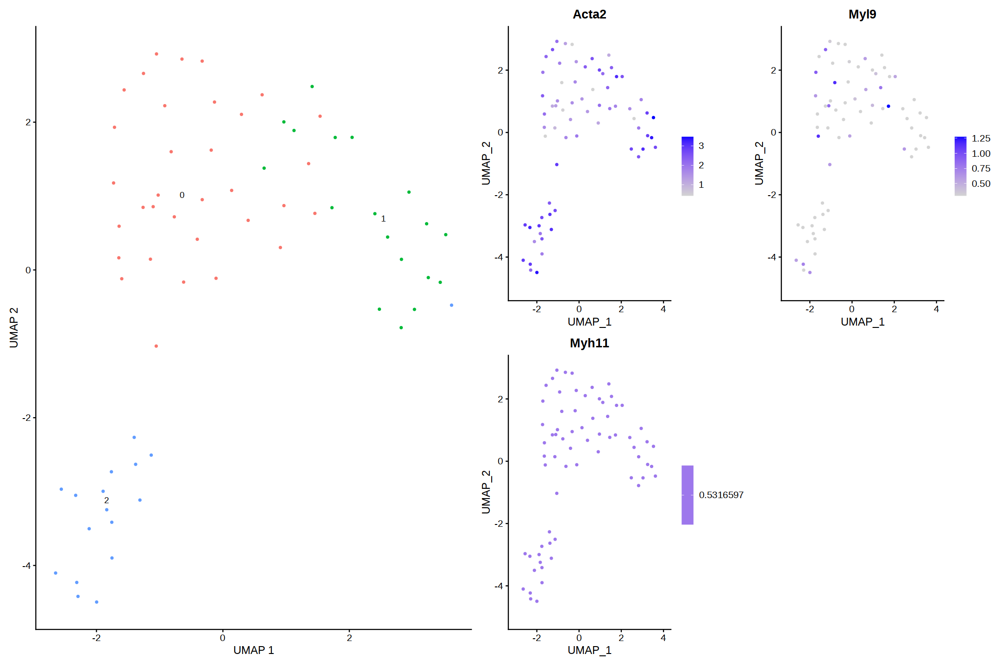

In [298]:
#Smooth muscle cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_myocyte, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_myocyte, c("Acta2", "Myl9","Myh11"), min.cutoff = "q1")  

p1 + p2

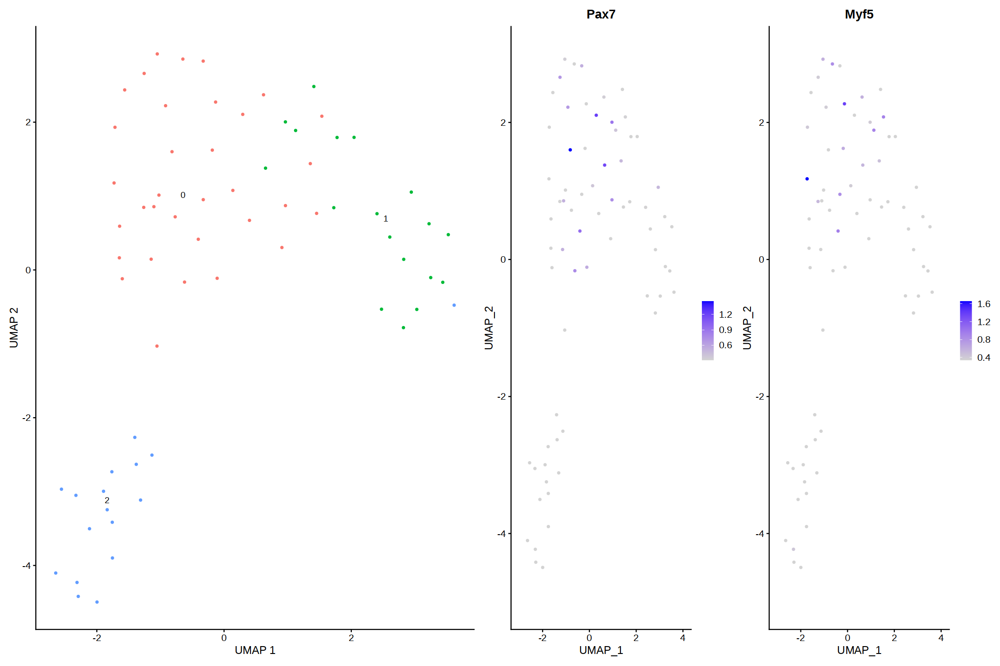

In [299]:
#Myogenic stem cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_myocyte, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_myocyte, c("Pax7","Myf5"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Notch, Myod”


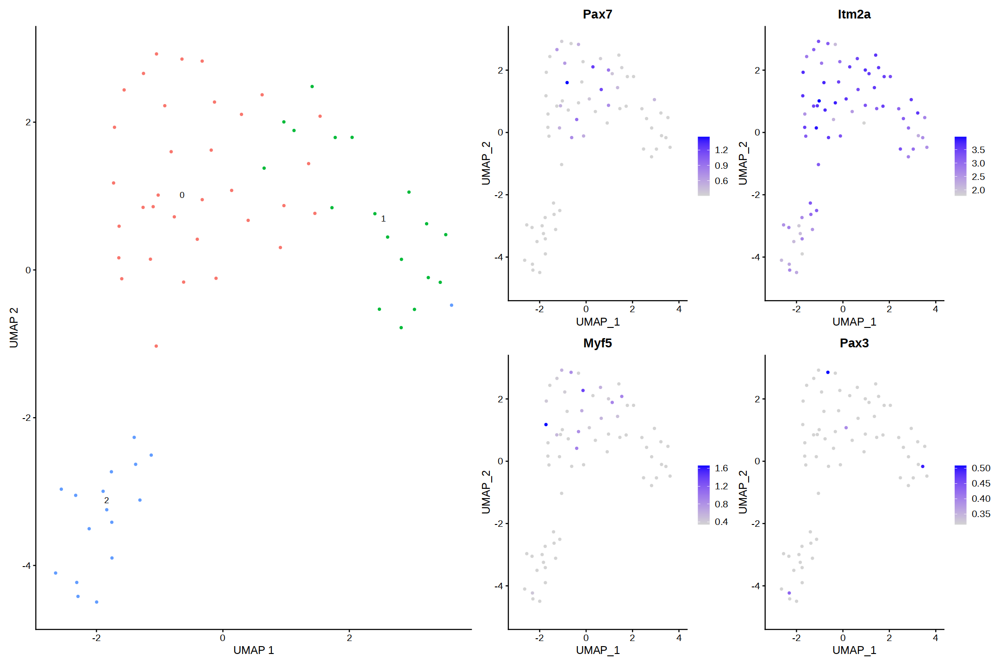

In [300]:
#Muscle progenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_myocyte, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_myocyte, c("Pax7", "Notch", "Itm2a", "Myf5", "Pax3", "Myod"), min.cutoff = "q1")  

p1 + p2

In [376]:
A_myocyte@meta.data$CellType_d <- Idents(A_myocyte)

In [377]:
A_myocyte@meta.data$CellType_d <- as.character(A_myocyte@meta.data$CellType_d)

A_myocyte@meta.data$CellType_d[A_myocyte@meta.data$CellType_d == '0'] <- 'Muscle progenitors'
A_myocyte@meta.data$CellType_d[A_myocyte@meta.data$CellType_d == '1'] <- 'Muscle progenitors'
A_myocyte@meta.data$CellType_d[A_myocyte@meta.data$CellType_d == '2'] <- 'Skeletal muscle cells'

A_myocyte@meta.data$CellType_d <- as.factor(A_myocyte@meta.data$CellType_d)

#### 3.4.2. Updating annotations<a id="16"></a>

In [378]:
meta1 <- A@meta.data
meta2 <- A_chondrocytes@meta.data

In [379]:
df <- split(meta1, meta1$CellType)

In [380]:
names(df)

[1] "Chondrocytes"               "Embryonic skin"            
[3] "Imune cells"                "Myocyte"                   
[5] "Mysenchyme"                 "Vascular endothelial cells"

In [381]:
chondro <- rownames(df$Chondrocytes)

In [382]:
chondro_meta <- meta2[chondro, c("CellType_d","Author")]
chondro_meta$Author<- NULL

head(chondro_meta)

,CellType_d
,<fct>
AAACCTGAGTTAGGTA-1,Resting zone chondrocytes
AAACCTGCAAGCCCAC-1,Proliferative chondrocytes
AAACCTGGTAAACACA-1,Proliferative chondrocytes
AAACCTGGTATATGAG-1,Proliferative chondrocytes
AAACCTGGTTATCGGT-1,Proliferative chondrocytes
AAACCTGTCTCTGAGA-1,Proliferative chondrocytes


In [383]:
df$Chondrocytes <- cbind(df$Chondrocytes, chondro_meta)
df$Chondrocytes$CellType <- df$Chondrocytes$CellType_d
df$Chondrocytes$CellType_d <- NULL

In [384]:
meta2 <- A_myocyte@meta.data
myo <- rownames(df$Myocyte)

In [385]:
myo_meta <- meta2[myo, c("CellType_d","Author")]
myo_meta$Author<- NULL

head(myo_meta)

,CellType_d
,<fct>
AACCGCGAGCTCCTCT-1,Muscle progenitors
ACTGCTCGTGTTAAGA-1,Skeletal muscle cells
AGAATAGGTCCATGAT-1,Muscle progenitors
ATCACGATCTGGTTCC-1,Muscle progenitors
ATCTACTGTTGTCGCG-1,Muscle progenitors
CAGCCGAAGTACGTTC-1,Muscle progenitors


In [386]:
df$Myocyte <- cbind(df$Myocyte, myo_meta)
df$Myocyte$CellType <- df$Myocyte$CellType_d
df$Myocyte$CellType_d <- NULL

In [387]:
meta2 <- A_mesenchyme@meta.data
mesen <- rownames(df$Mysenchyme)

In [388]:
mesen_meta <- meta2[mesen, c("CellType_d","Author")]
mesen_meta$Author<- NULL

head(mesen_meta)

,CellType_d
,<fct>
AAACCTGCAAAGCAAT-1,Tenocytes
AAAGTAGCAAAGGCGT-1,Distal limb mesenchyme
AACCATGTCAGCATGT-1,Distal limb mesenchyme
AACTCCCCAACGCACC-1,Distal limb mesenchyme
AACTTTCGTTAGGGTG-1,Distal limb mesenchyme
AAGCCGCTCTTATCTG-1,Distal limb mesenchyme


In [389]:
df$Mysenchyme <- cbind(df$Mysenchyme, mesen_meta)
df$Mysenchyme$CellType <- df$Mysenchyme$CellType_d
df$Mysenchyme$CellType_d <- NULL

In [390]:
names(df)

[1] "Chondrocytes"               "Embryonic skin"            
[3] "Imune cells"                "Myocyte"                   
[5] "Mysenchyme"                 "Vascular endothelial cells"

In [391]:
df$'Chondrocytes'$Barcode = rownames(df$'Chondrocytes')
df$'Embryonic skin'$Barcode = rownames(df$'Embryonic skin')
df$'Imune cells'$Barcode = rownames(df$'Imune cells')
df$'Imune cells'$Barcode = rownames(df$'Imune cells')
df$'Myocyte'$Barcode = rownames(df$'Myocyte')
df$'Mysenchyme'$Barcode = rownames(df$'Mysenchyme')
df$'Vascular endothelial cells'$Barcode = rownames(df$'Vascular endothelial cells')

In [392]:
str(df)

List of 6
 $ Chondrocytes              :'data.frame':	1948 obs. of  25 variables:
  ..$ orig.ident           : Factor w/ 1 level "SeuratProject": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ nCount_RNA           : num [1:1948] 4040 5366 14969 9922 10073 ...
  ..$ nFeature_RNA         : int [1:1948] 1658 1947 3414 2935 3420 2319 1676 2017 2154 3455 ...
  ..$ geo_accession        : Factor w/ 4 levels "GSM4227224","GSM4227225",..: 2 2 2 2 2 2 2 2 2 2 ...
  ..$ tissue               : Factor w/ 1 level "hindlimb": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ organism             : Factor w/ 1 level "Mus musculus": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ strain               : Factor w/ 1 level "strain: C57BL/6": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ developmental_stage  : Factor w/ 4 levels "developmental stage: embryonic day 11.5",..: 2 2 2 2 2 2 2 2 2 2 ...
  ..$ instrument_model     : Factor w/ 1 level "Illumina NovaSeq 6000": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ technology           : chr [1:1948] "10x 3' v2" "10x 3' v2" "10x 3' v2" "10x 3'

In [393]:
names(df)

[1] "Chondrocytes"               "Embryonic skin"            
[3] "Imune cells"                "Myocyte"                   
[5] "Mysenchyme"                 "Vascular endothelial cells"

In [394]:
df$'Chondrocytes'$Barcode <- rownames(df$'Chondrocytes')
df$'Embryonic skin'$Barcode <- rownames(df$'Embryonic skin')
df$'Imune cells'$Barcode <- rownames(df$'Imune cells')
df$'Imune cells'$Barcode <- rownames(df$'Imune cells')
df$'Myocyte'$Barcode <- rownames(df$'Myocyte')
df$'Mysenchyme'$Barcode <- rownames(df$'Mysenchyme')
df$'Vascular endothelial cells'$Barcode <- rownames(df$'Vascular endothelial cells')

In [395]:
meta.data <- do.call(rbind, df)
rownames(meta.data) = meta.data$Barcode
meta.data$Barcode <- NULL

In [396]:
dim(A@meta.data)
dim(meta.data)

[1] 2726   24

[1] 2726   24

In [397]:
target <- rownames(A@meta.data)
meta.data <- meta.data[match(target, rownames(meta.data)),]

In [398]:
A@meta.data = meta.data

#### 5.4.3. Finalized embedding and annotation<a id="37"></a>

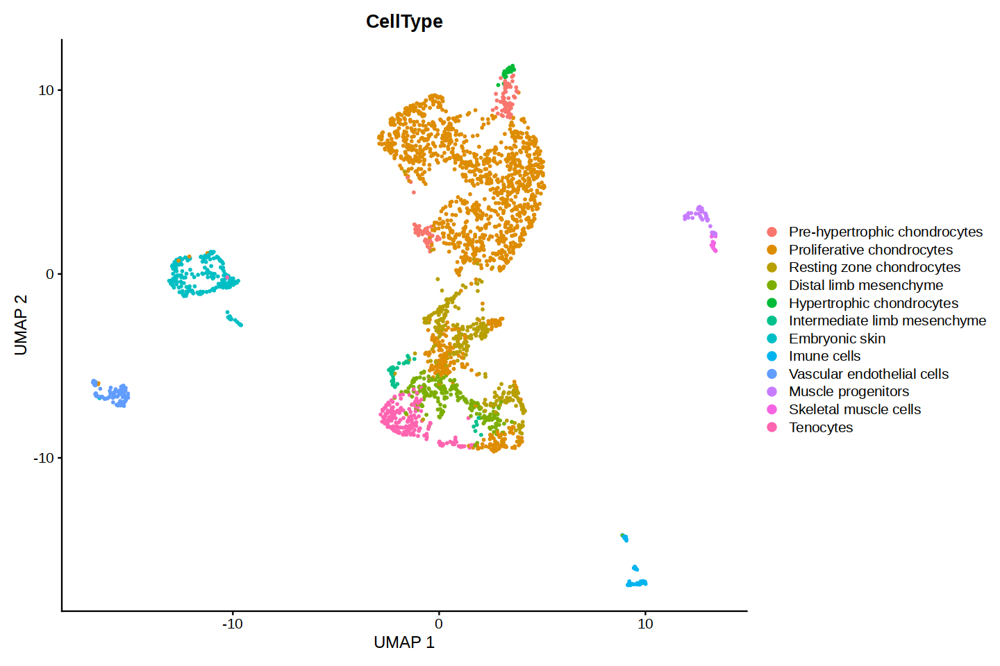

In [399]:
options(repr.plot.width=12)
DimPlot(A, group.by = "CellType", label = FALSE, repel = TRUE) + xlab("UMAP 1") + ylab("UMAP 2")


In [401]:
Idents(A) <- A$CellType

In [402]:
saveRDS(A, file = "Guilak_E13.5_annotated.Rds")